In [15]:
!git init

Initialized empty Git repository in C:/Users/miguel.preto/PycharmProjects/.git/


In [16]:
!git remote add origin https://github.com/MiguelPreto17/Pycharm.git

In [17]:
!git add .

hint: You've added another git repository inside your current repository.
hint: Clones of the outer repository will not contain the contents of
hint: the embedded repository and will not know how to obtain it.
hint: If you meant to add a submodule, use:
hint: 
hint: 	git submodule add <url> Inputs
hint: 
hint: If you added this path by mistake, you can remove it from the
hint: index with:
hint: 
hint: 	git rm --cached Inputs
hint: 
hint: See "git help submodule" for more information.


In [18]:
!git commit -m "Primeiro commit de backup dos notebooks"

[master (root-commit) aee71a0] Primeiro commit de backup dos notebooks
 765 files changed, 107083 insertions(+)
 create mode 100644 .ipynb_checkpoints/All_dataset-checkpoint.ipynb
 create mode 100644 .ipynb_checkpoints/Dataset-checkpoint.ipynb
 create mode 100644 .ipynb_checkpoints/EV_Analysis -checkpoint.ipynb
 create mode 100644 .ipynb_checkpoints/Forecast_model-checkpoint.ipynb
 create mode 100644 .ipynb_checkpoints/Forecast_model_all-checkpoint.ipynb
 create mode 100644 .ipynb_checkpoints/Newdataset-checkpoint.ipynb
 create mode 100644 .ipynb_checkpoints/Project1-checkpoint.ipynb
 create mode 100644 .ipynb_checkpoints/Untitled-checkpoint.ipynb
 create mode 100644 .ipynb_checkpoints/Untitled1-checkpoint.ipynb
 create mode 100644 .ipynb_checkpoints/Untitled2-checkpoint.ipynb
 create mode 100644 .ipynb_checkpoints/Untitled3-checkpoint.ipynb
 create mode 100644 .ipynb_checkpoints/Untitled4-checkpoint.ipynb
 create mode 100644 .ipynb_checkpoints/Untitled5-checkpoint.ipynb
 create mode 1

In [20]:
!git reset

Unstaged changes after reset:
M	Project1.ipynb


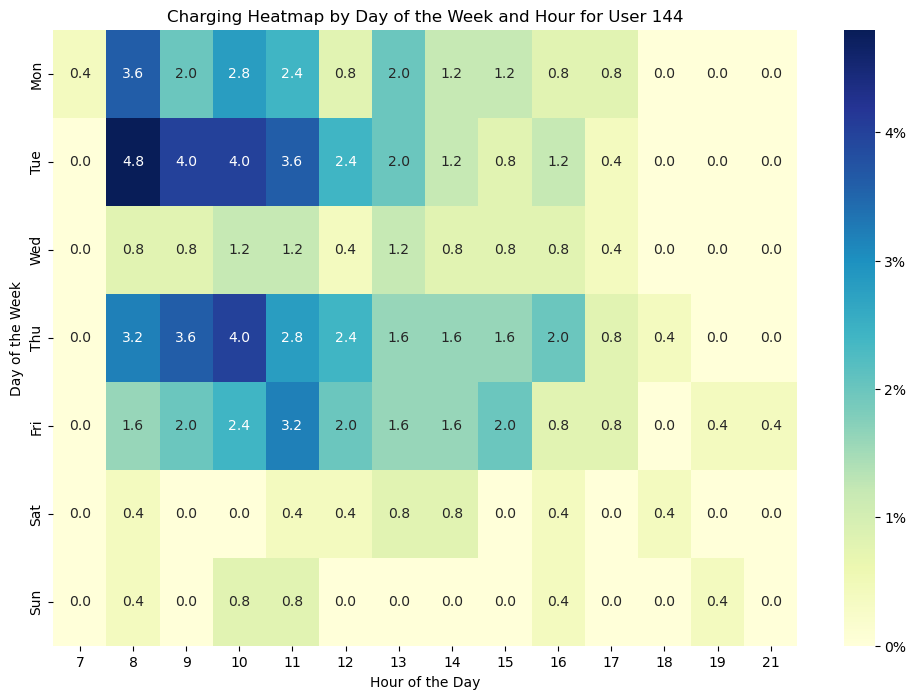

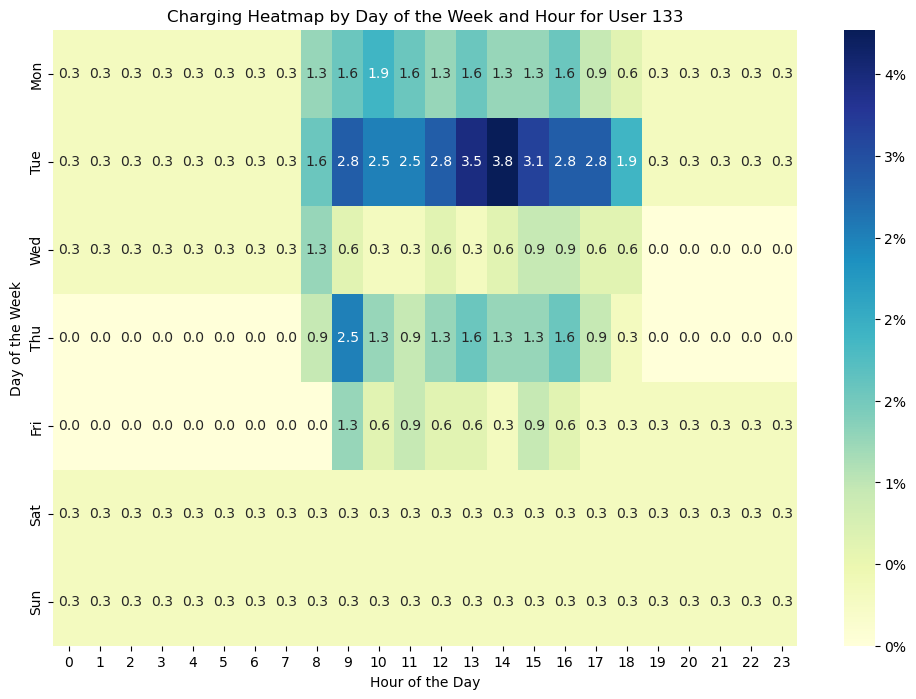

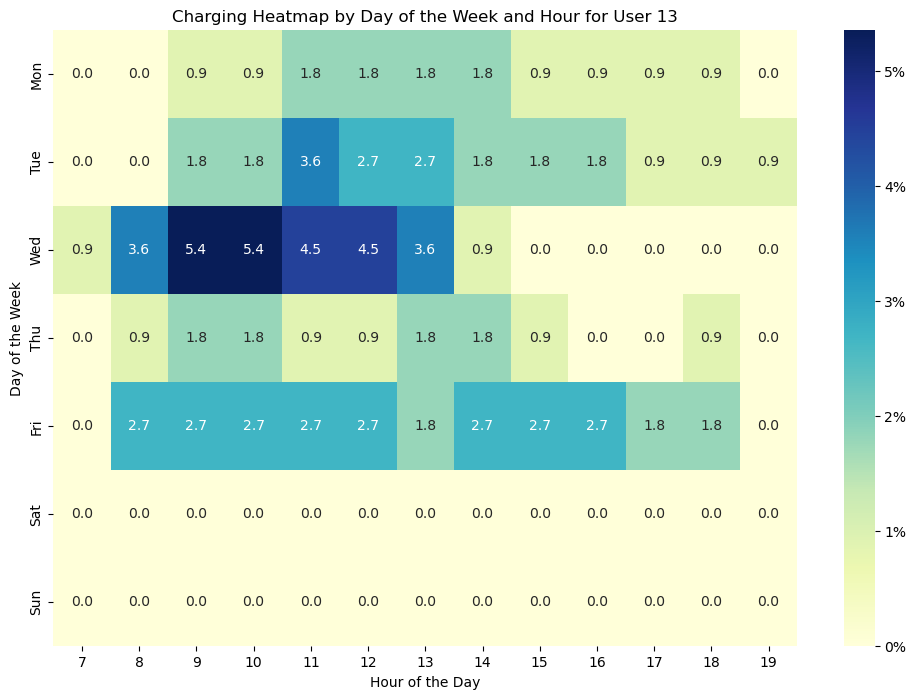

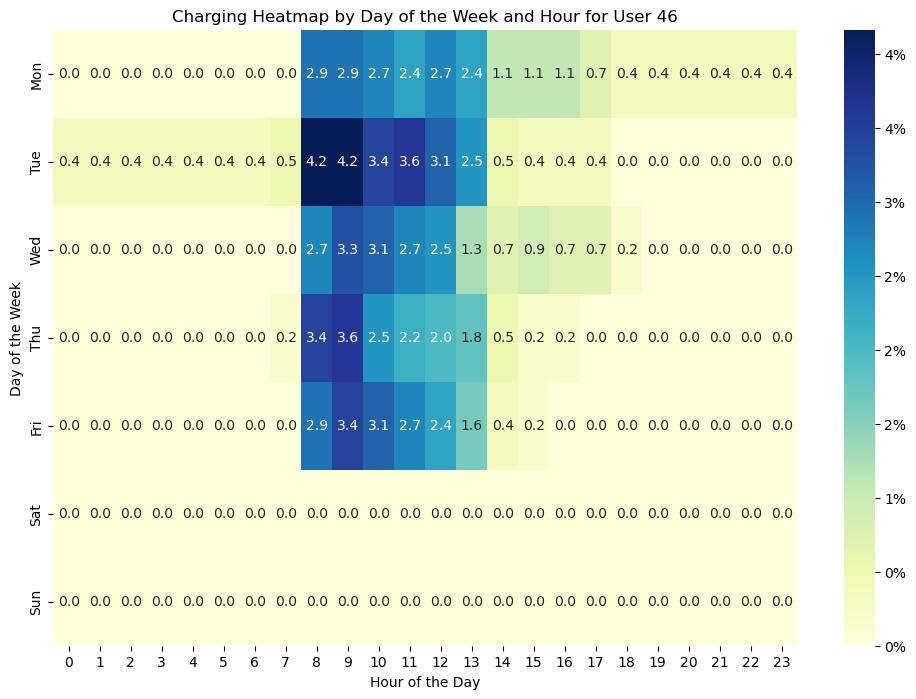

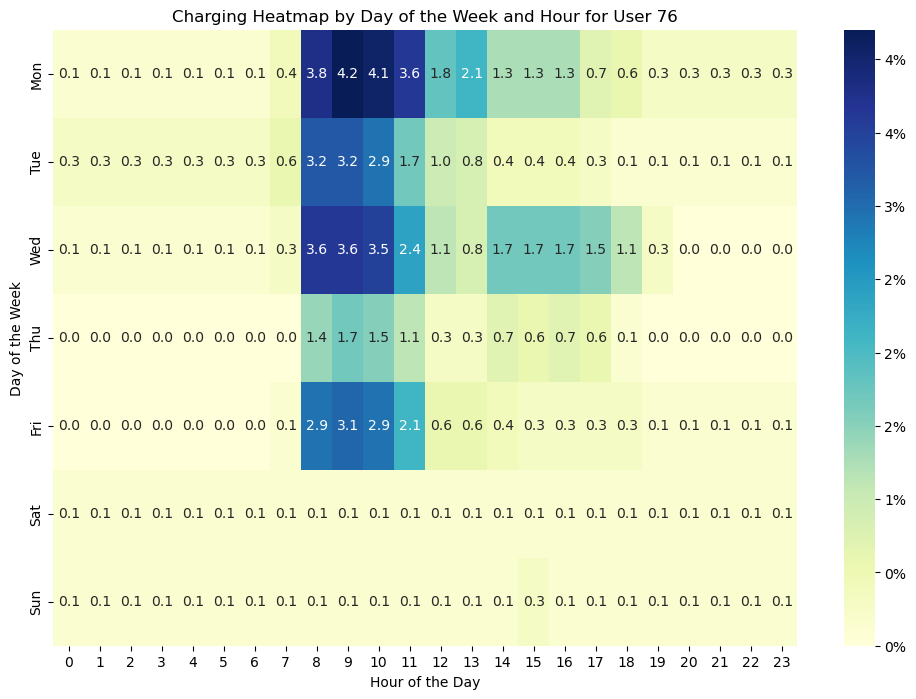

...

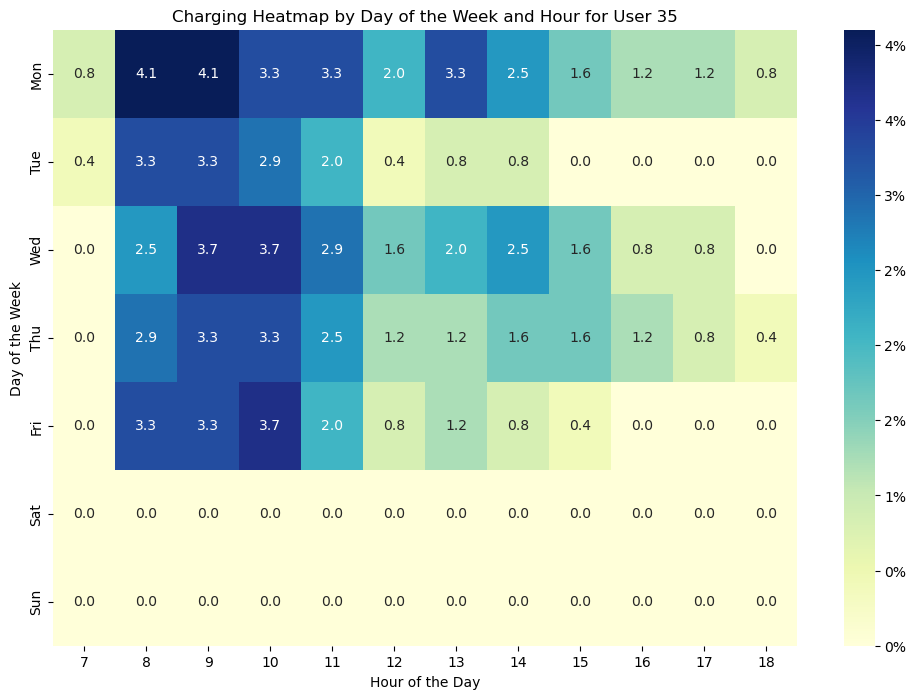

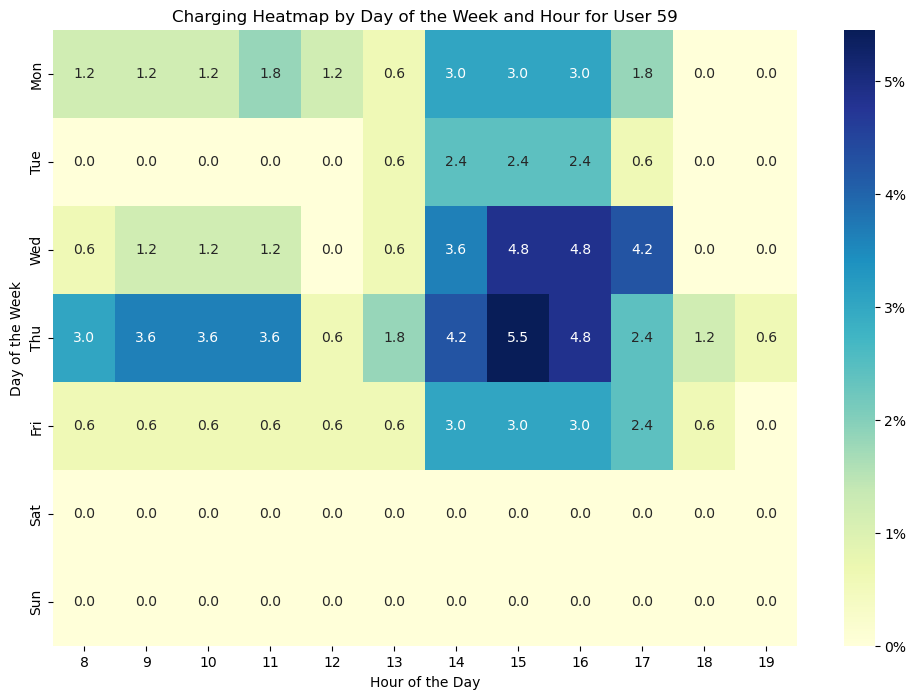

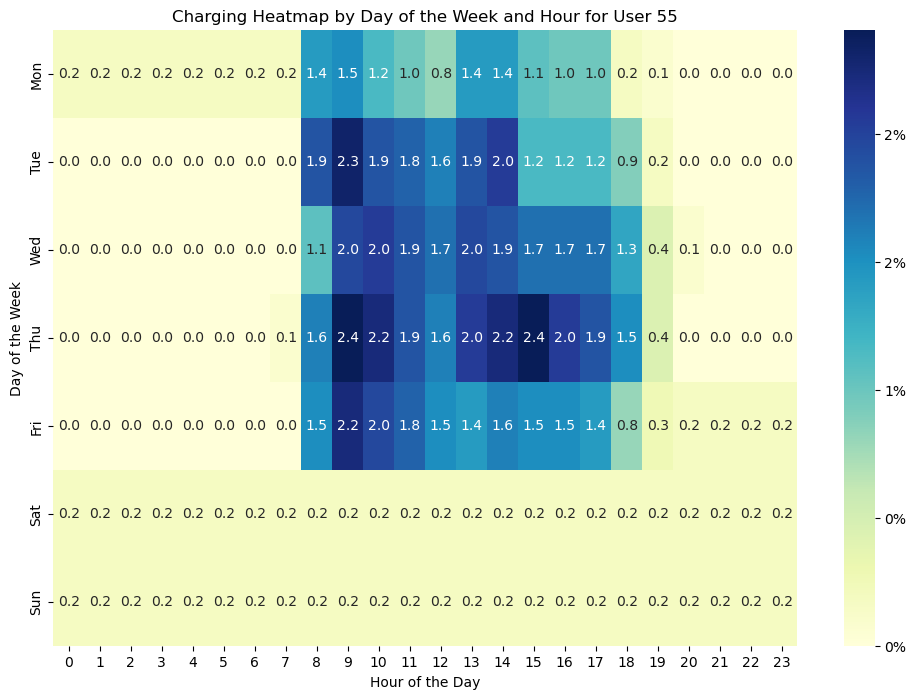

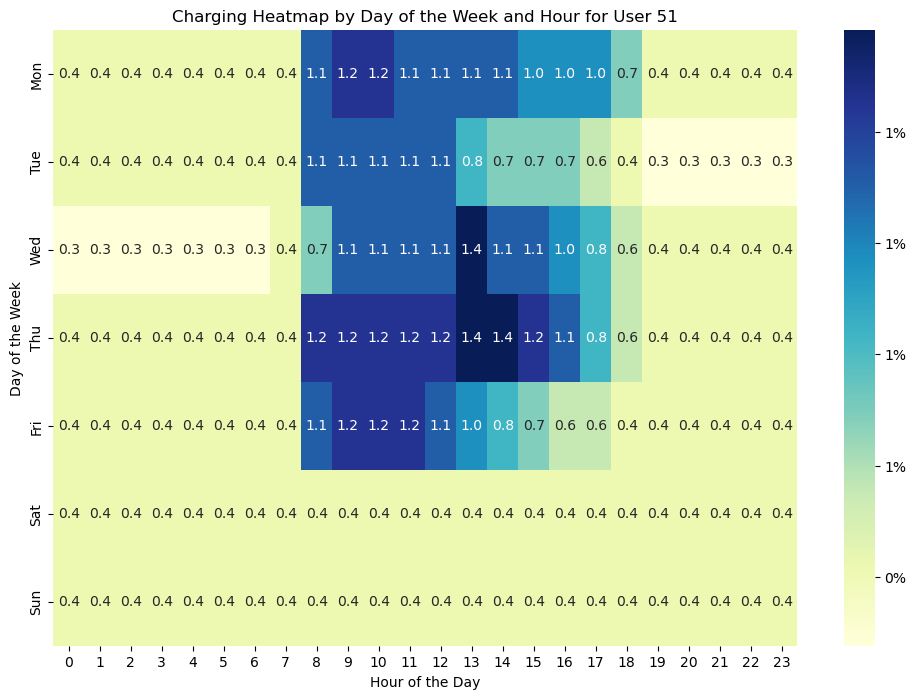

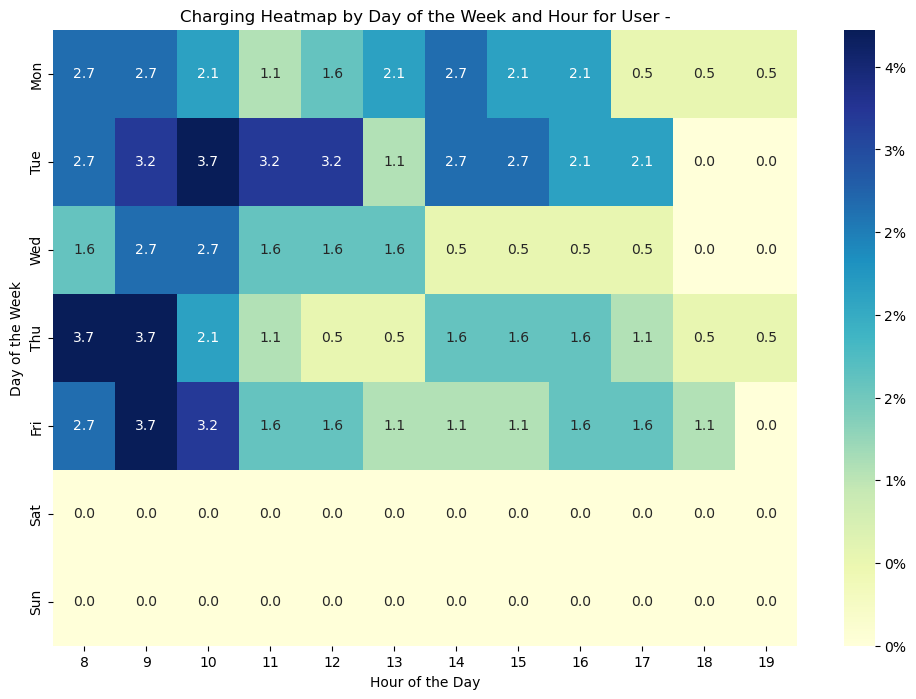

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Carregar os dados do usuário
User = pd.read_excel('EVIO_history_01-02-2023_29-02-2024.xlsx')

# Remove energy charge values less than 1 kWh
User = User[User['Total Energy (kWh)'] >= 1]

# Remove charge duration values less than 5 minutes
User = User[User['Duration (min)'] >= 5]

User['Start date'] = pd.to_datetime(User['Start date'], format='%m/%d/%Y | %H:%M')
User['Stop date'] = pd.to_datetime(User['Stop date'], format='%m/%d/%Y | %H:%M')

user_counts = User['Nº cartão EVIO'].value_counts()

# Filter users with more than 10 observations
users_with_more_than_10_observations = user_counts[user_counts > 10].index

# Filter the original DataFrame to include only these users
User = User[User['Nº cartão EVIO'].isin(users_with_more_than_10_observations)]

# Convert the date columns to datetime
User['Start date'] = pd.to_datetime(User['Start date'])
User['Stop date'] = pd.to_datetime(User['Stop date'])

# Create additional columns for start hour and day of the week
User['Start hour'] = User['Start date'].dt.hour
User['Weekday'] = User['Start date'].dt.dayofweek

# Function to expand the occupied hours during charging
def expand_hours(row):
    start = row['Start date']
    stop = row['Stop date']
    hours = pd.date_range(start, stop, freq='H').tolist()
    return [(row['Nº cartão EVIO'], h.dayofweek, h.hour) for h in hours]

# Apply the function to each row of the dataframe and create a new dataframe
expanded_data = User.apply(expand_hours, axis=1).explode().tolist()
expanded_df = pd.DataFrame(expanded_data, columns=['Nº cartão EVIO', 'Weekday', 'Hour'])

# Get unique list of users
usuarios = User['Nº cartão EVIO'].unique()

# Plot heatmap for each user
for usuario in usuarios:
    # Filter data for the current user
    User_usuario = expanded_df[expanded_df['Nº cartão EVIO'] == usuario]

    # Create a count matrix of charging occurrences by hour and day of the week
    heatmap_data = User_usuario.groupby(['Weekday', 'Hour']).size().unstack(fill_value=0)
    
    # Ensure that all 7 rows of the days of the week are present
    all_weekdays = pd.Index(range(7), name='Weekday')
    heatmap_data = heatmap_data.reindex(all_weekdays, fill_value=0)
    
    # Calculate the percentage in relation to the total hours of charging
    total_hours = heatmap_data.values.sum()
    heatmap_data_percent = (heatmap_data / total_hours) * 100

    # Set the days of the week to start from Monday
    heatmap_data_percent.index = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']

    # Plot the heatmap
    plt.figure(figsize=(12, 8))
    sns.heatmap(heatmap_data_percent, cmap="YlGnBu", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'})
    plt.title(f"Charging Heatmap by Day of the Week and Hour for User {usuario}")
    plt.xlabel("Hour of the Day")
    plt.ylabel("Day of the Week")
    plt.show()

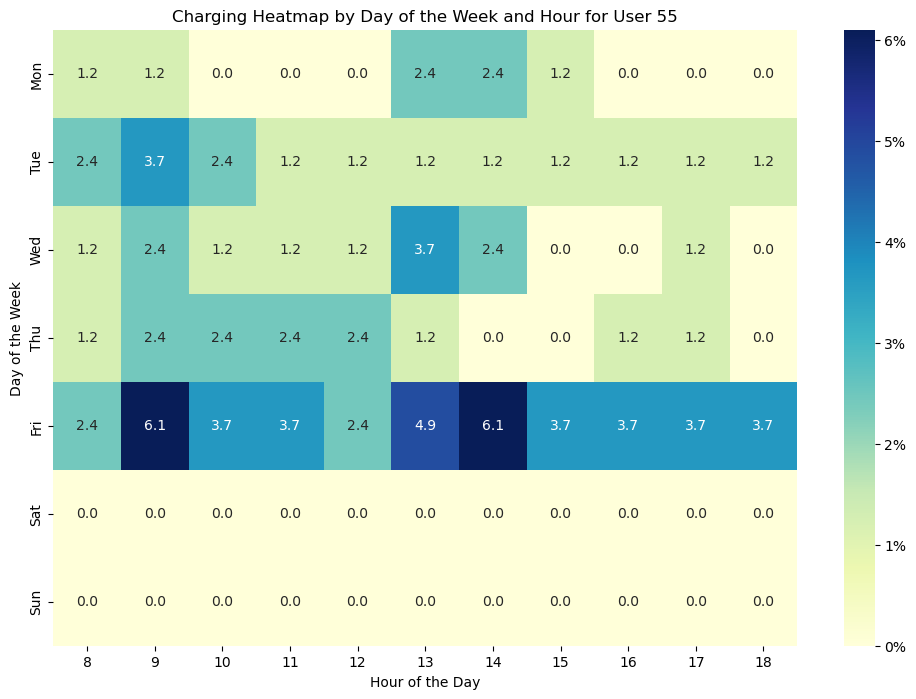

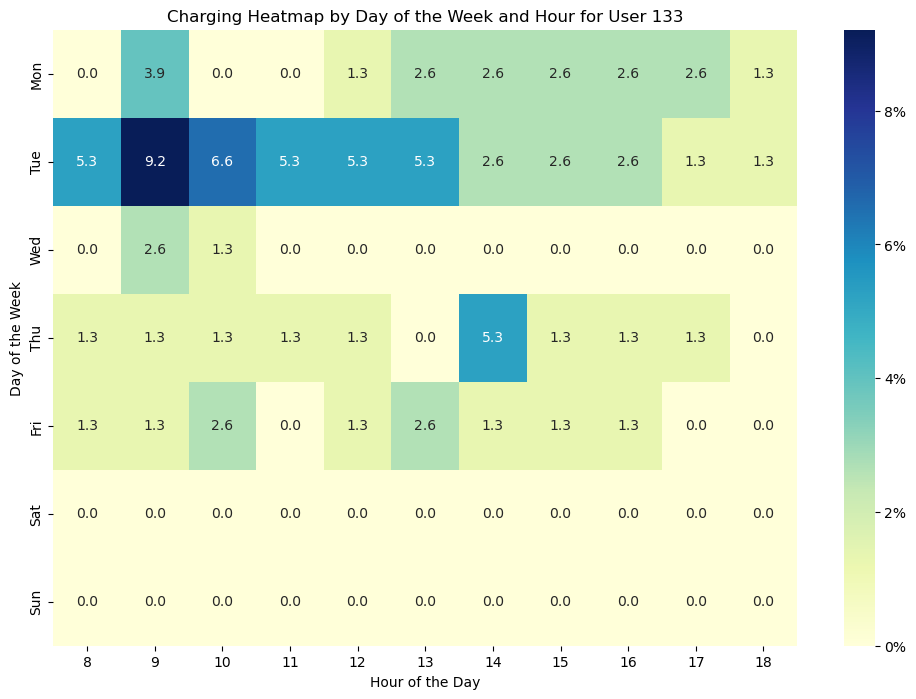

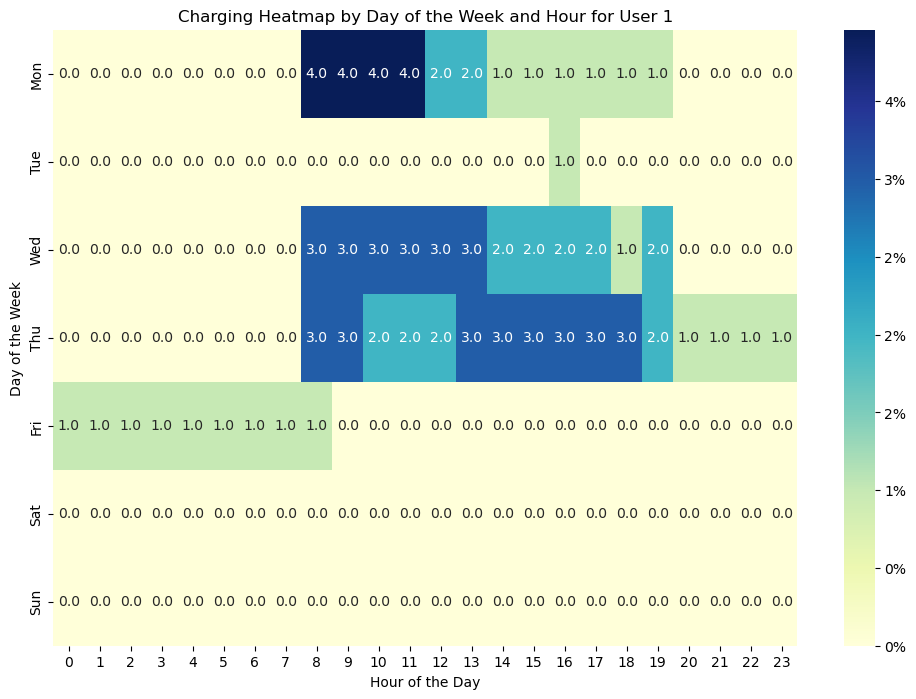

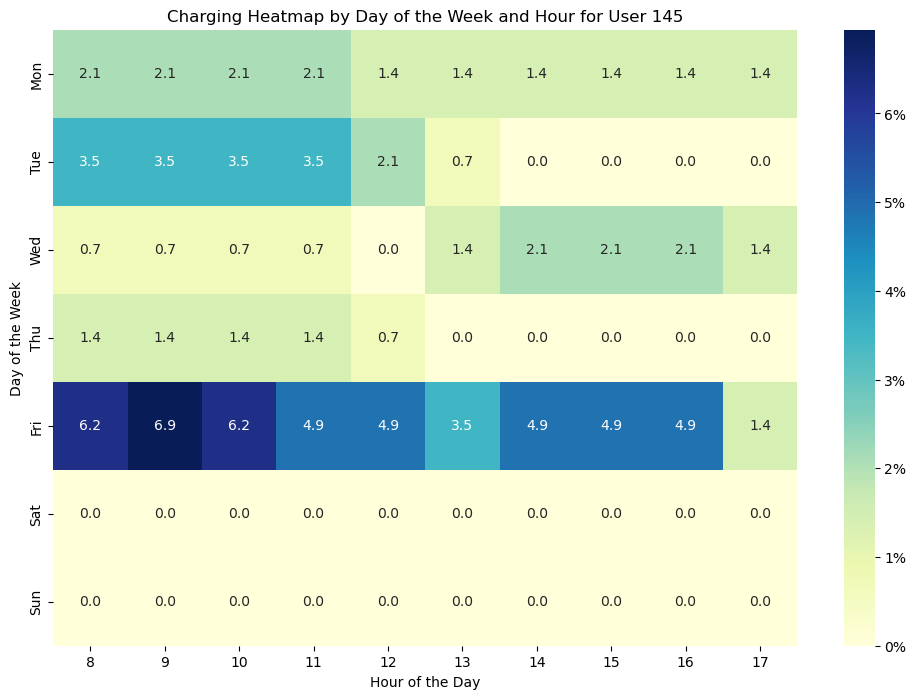

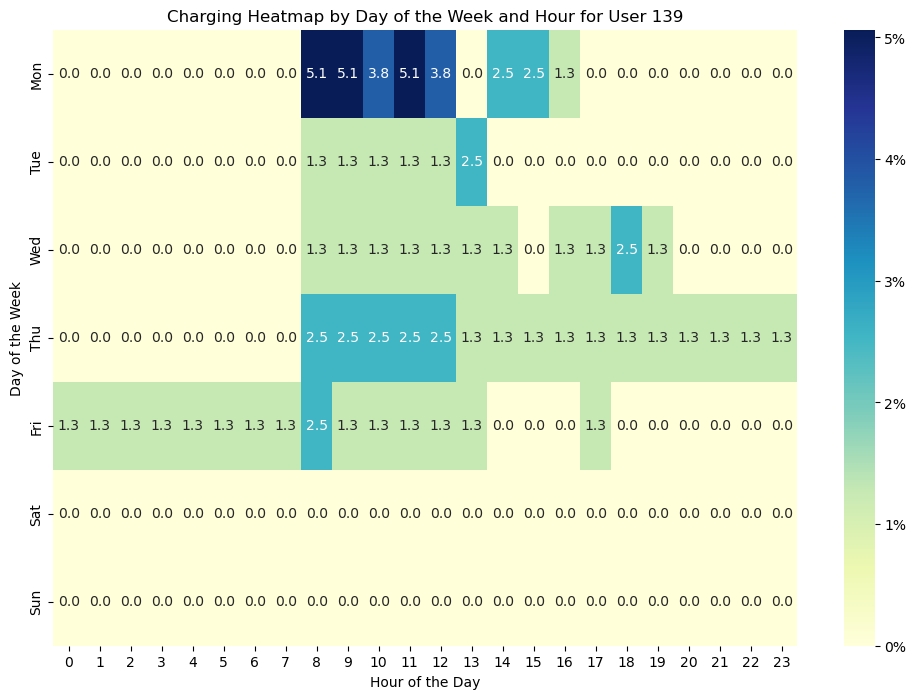

...

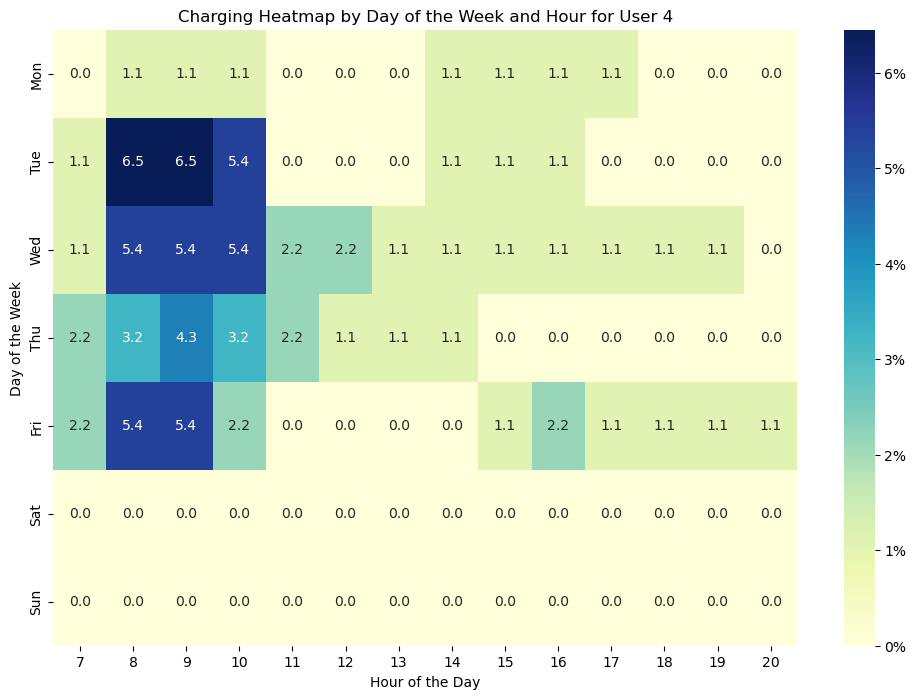

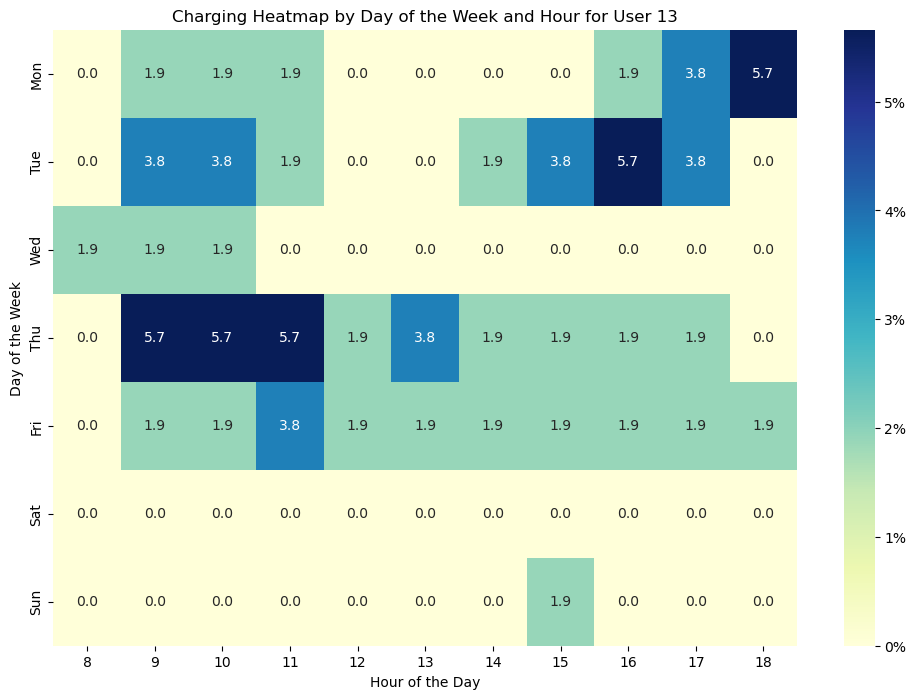

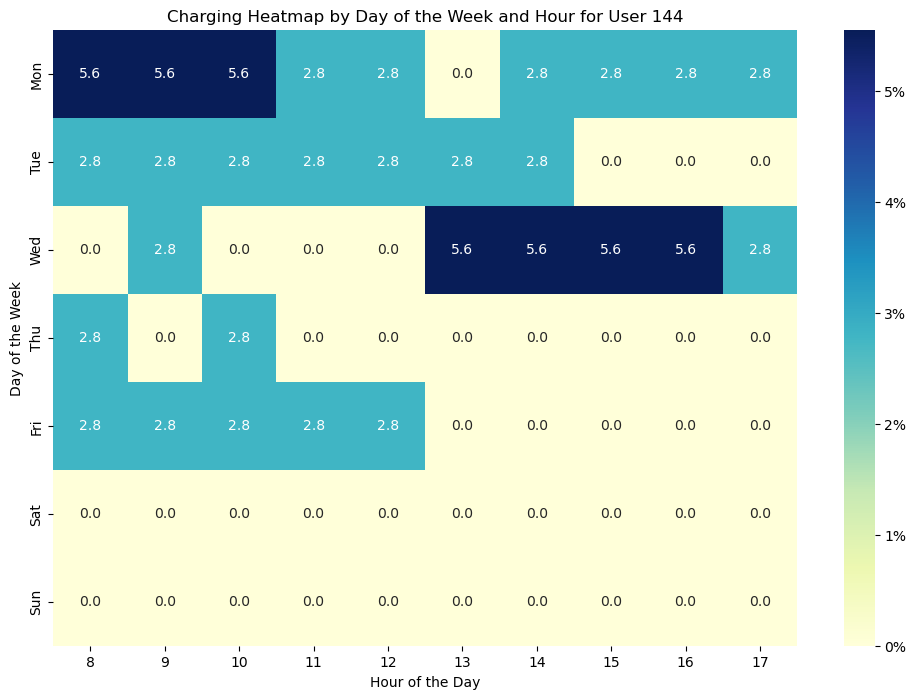

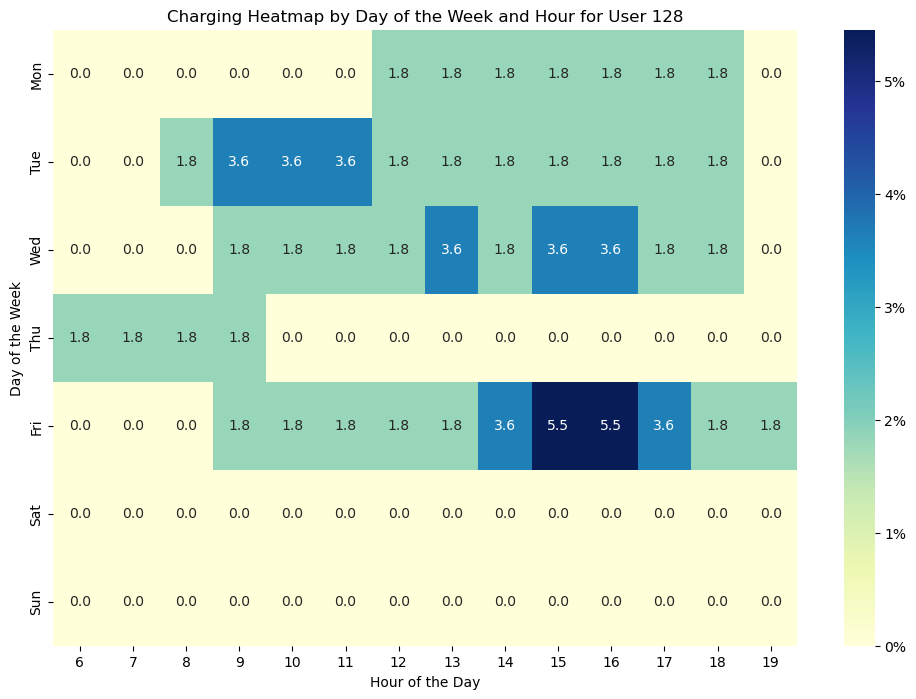

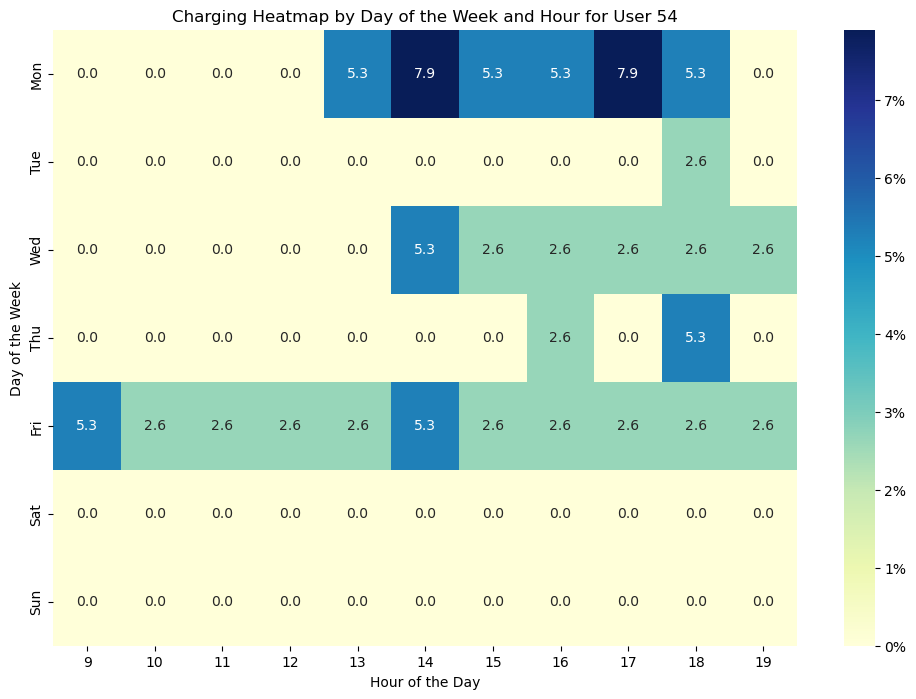

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Carregar os dados do usuário
User = pd.read_excel('EVIO_history_01-03-2024_01-06-2024.xlsx')

# Remove energy charge values less than 1 kWh
User = User[User['Total Energy (kWh)'] >= 1]

# Remove charge duration values less than 5 minutes
User = User[User['Duration (min)'] >= 5]

User['Start date'] = pd.to_datetime(User['Start date'], format='%m/%d/%Y | %H:%M')
User['Stop date'] = pd.to_datetime(User['Stop date'], format='%m/%d/%Y | %H:%M')

user_counts = User['Nº cartão EVIO'].value_counts()

# Filter users with more than 10 observations
users_with_more_than_10_observations = user_counts[user_counts > 10].index

# Filter the original DataFrame to include only these users
User = User[User['Nº cartão EVIO'].isin(users_with_more_than_10_observations)]

# Convert the date columns to datetime
User['Start date'] = pd.to_datetime(User['Start date'])
User['Stop date'] = pd.to_datetime(User['Stop date'])

# Create additional columns for start hour and day of the week
User['Start hour'] = User['Start date'].dt.hour
User['Weekday'] = User['Start date'].dt.dayofweek

# Function to expand the occupied hours during charging
def expand_hours(row):
    start = row['Start date']
    stop = row['Stop date']
    hours = pd.date_range(start, stop, freq='H').tolist()
    return [(row['Nº cartão EVIO'], h.dayofweek, h.hour) for h in hours]

# Apply the function to each row of the dataframe and create a new dataframe
expanded_data = User.apply(expand_hours, axis=1).explode().tolist()
expanded_df = pd.DataFrame(expanded_data, columns=['Nº cartão EVIO', 'Weekday', 'Hour'])

# Get unique list of users
usuarios = User['Nº cartão EVIO'].unique()

# Plot heatmap for each user
for usuario in usuarios:
    # Filter data for the current user
    User_usuario = expanded_df[expanded_df['Nº cartão EVIO'] == usuario]

    # Create a count matrix of charging occurrences by hour and day of the week
    heatmap_data = User_usuario.groupby(['Weekday', 'Hour']).size().unstack(fill_value=0)
    
    # Ensure that all 7 rows of the days of the week are present
    all_weekdays = pd.Index(range(7), name='Weekday')
    heatmap_data = heatmap_data.reindex(all_weekdays, fill_value=0)
    
    # Calculate the percentage in relation to the total hours of charging
    total_hours = heatmap_data.values.sum()
    heatmap_data_percent = (heatmap_data / total_hours) * 100

    # Set the days of the week to start from Monday
    heatmap_data_percent.index = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']

    # Plot the heatmap
    plt.figure(figsize=(12, 8))
    sns.heatmap(heatmap_data_percent, cmap="YlGnBu", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'})
    plt.title(f"Charging Heatmap by Day of the Week and Hour for User {usuario}")
    plt.xlabel("Hour of the Day")
    plt.ylabel("Day of the Week")
    plt.show()

Colunas do DataFrame: Index(['Start date', 'Stop date', 'Charging Place', 'Charging Station',
       'Duration (min)', 'Total Energy (kWh)', 'Nº cartão EVIO'],
      dtype='object')
Colunas do DataFrame: Index(['Start date', 'Stop date', 'Charging Place', 'Charging Station',
       'Duration (min)', 'Total Energy (kWh)', 'Nº cartão EVIO'],
      dtype='object')


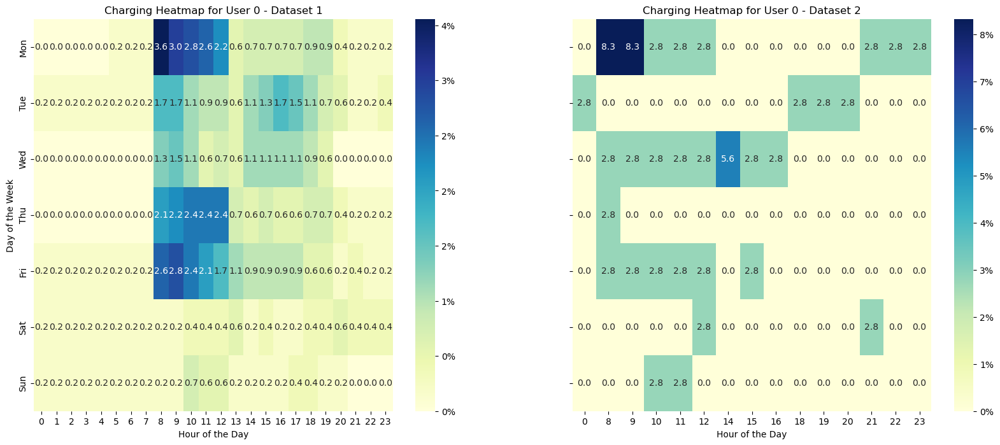

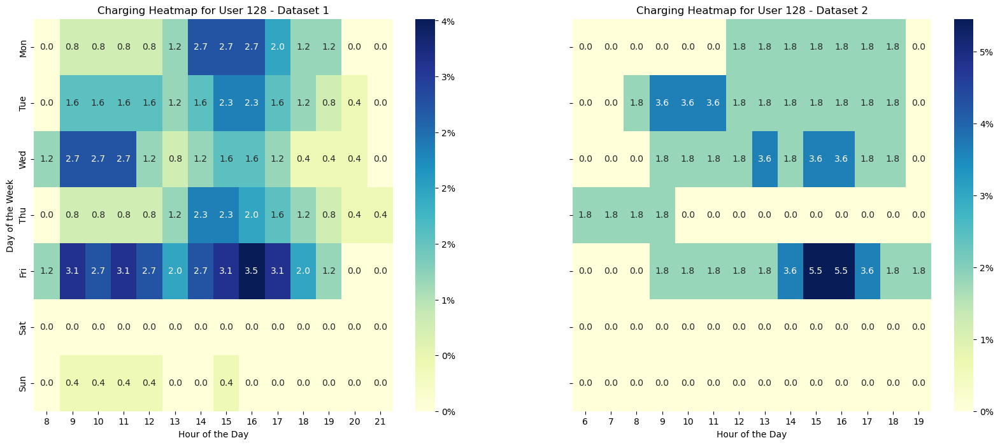

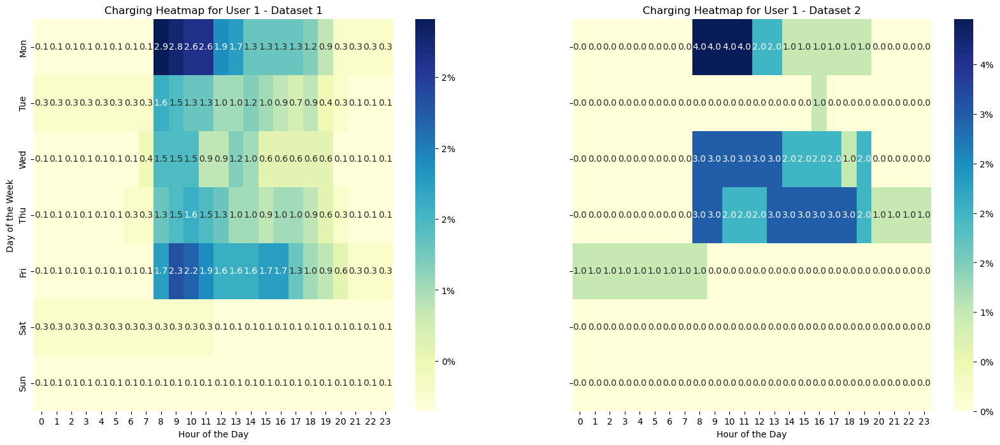

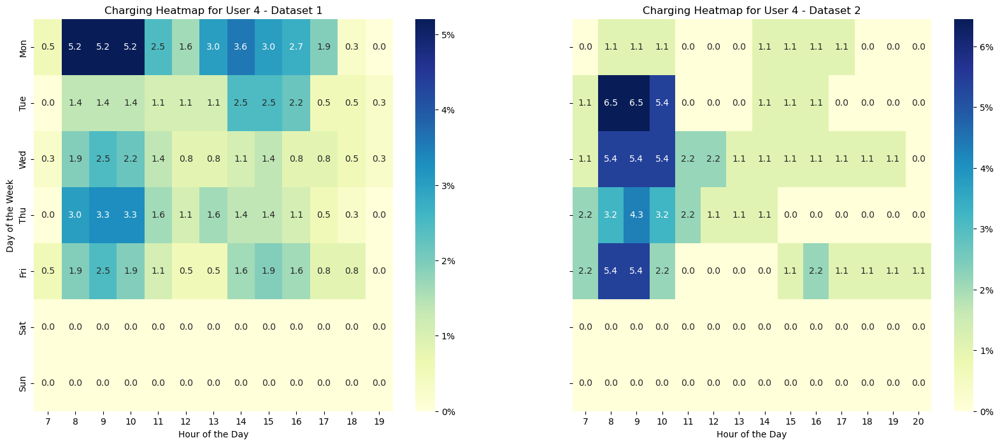

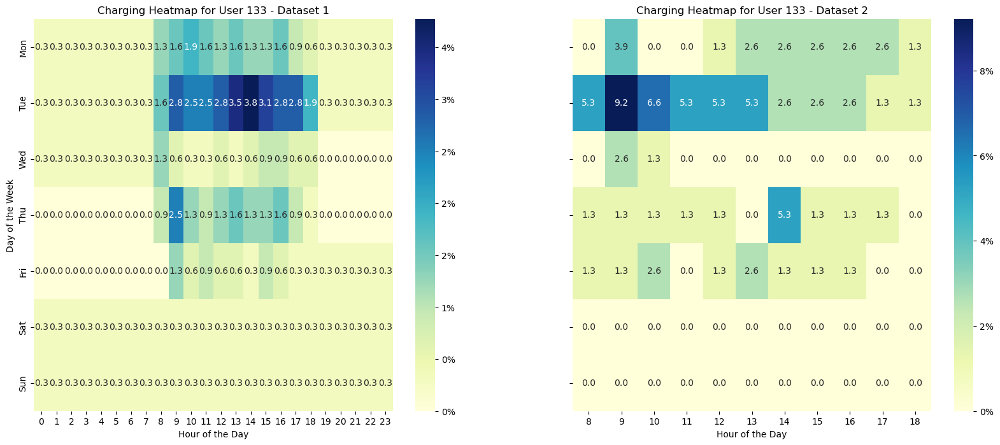

...

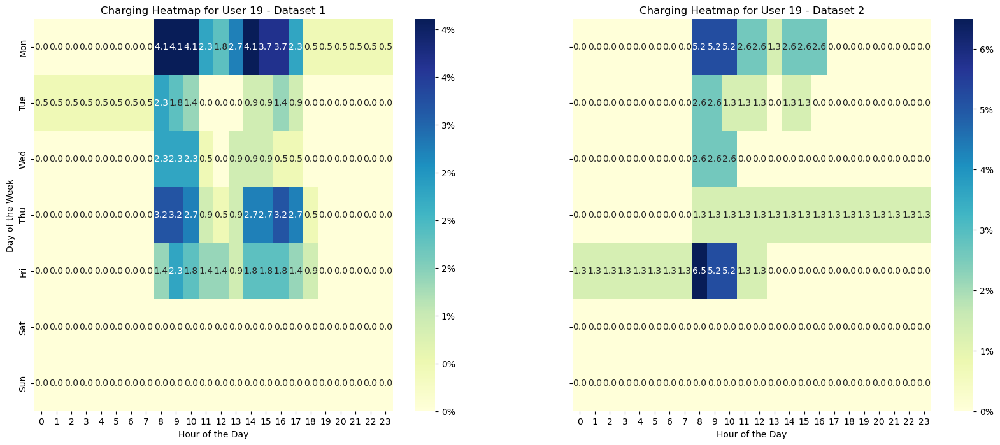

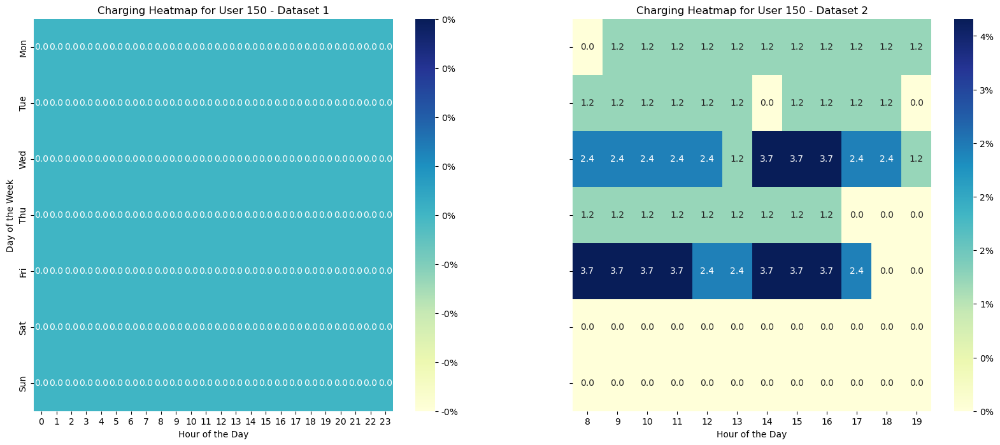

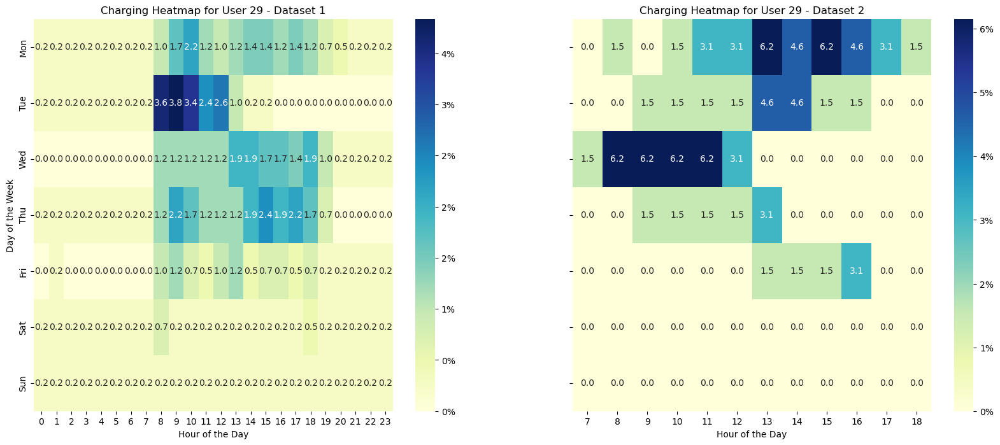

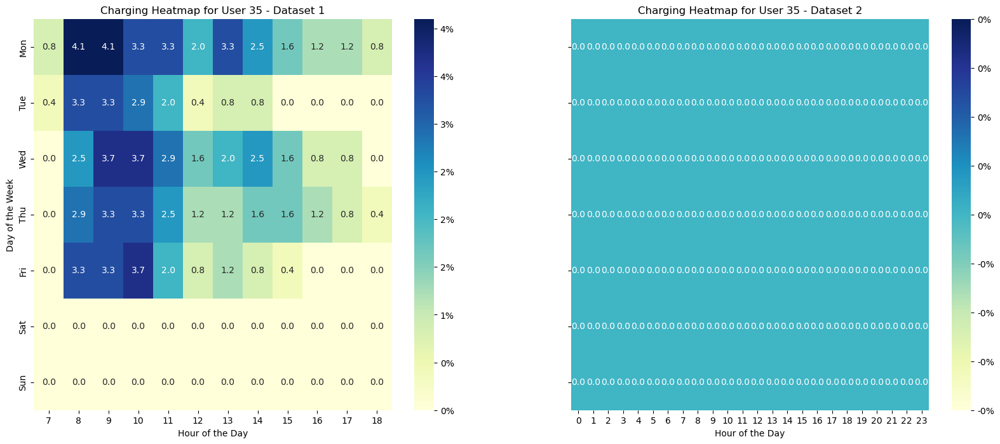

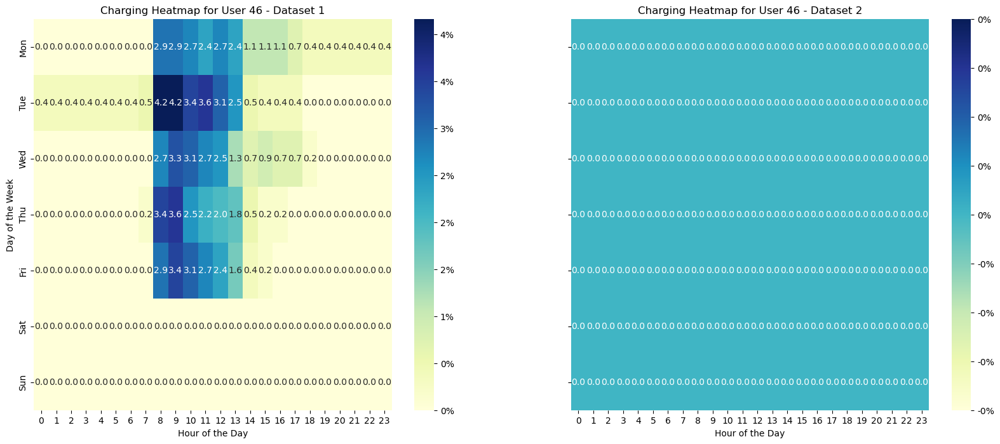

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3101815370.py:98: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if usuario in data1['Nº cartão EVIO'].values and usuario in data2['Nº cartão EVIO'].values:


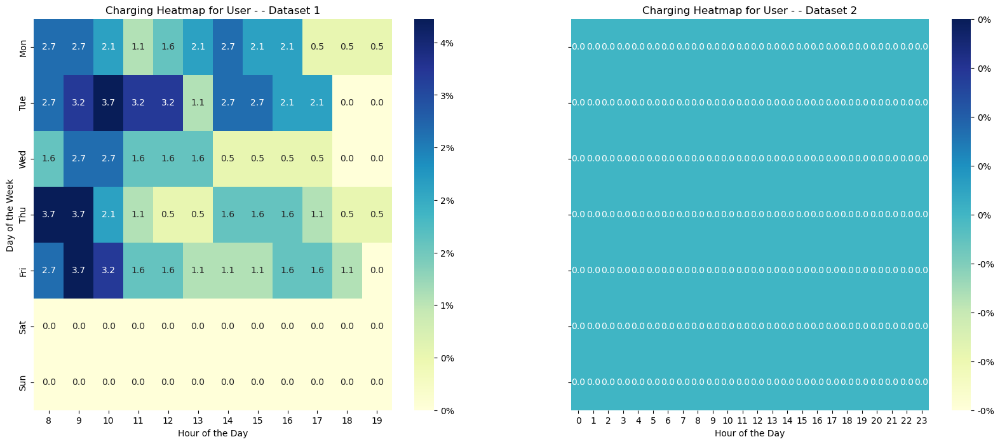

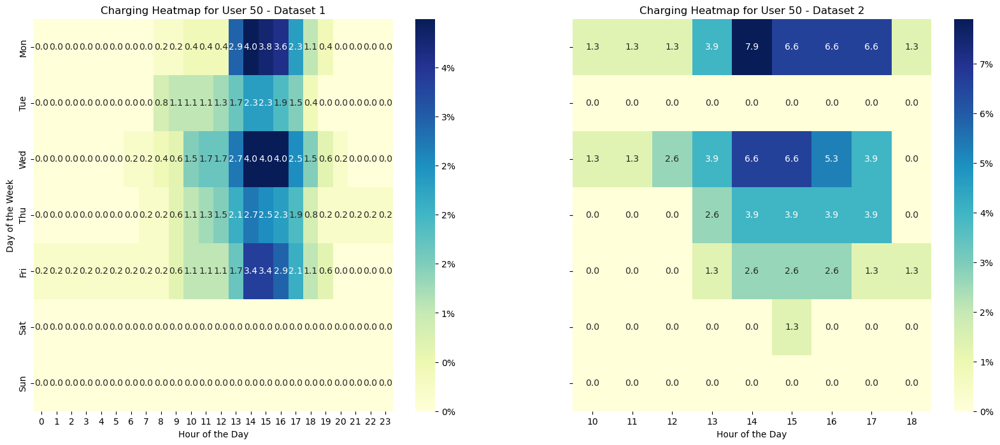

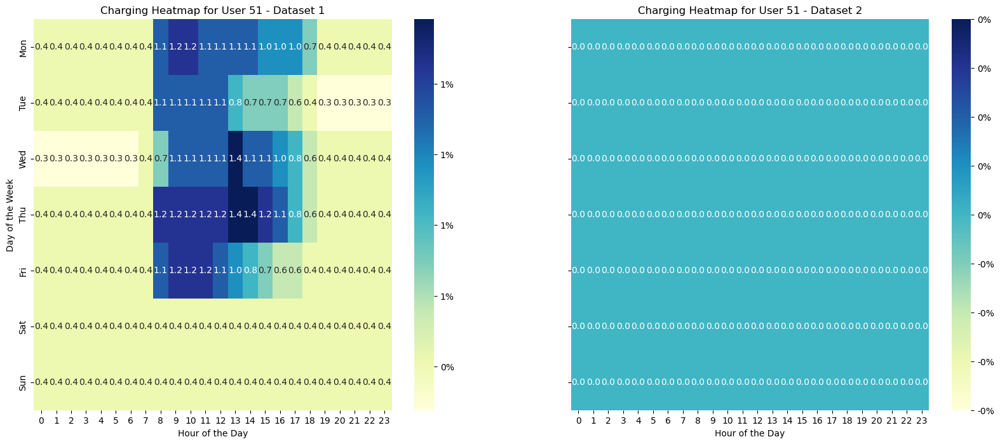

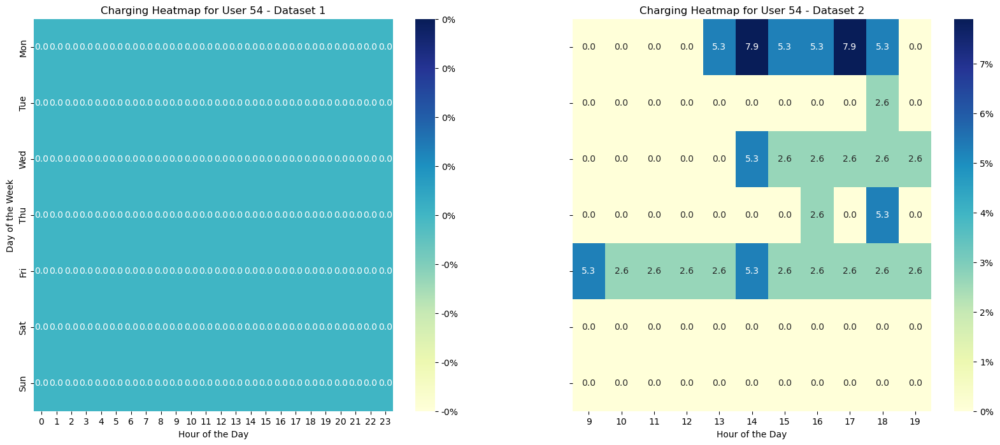

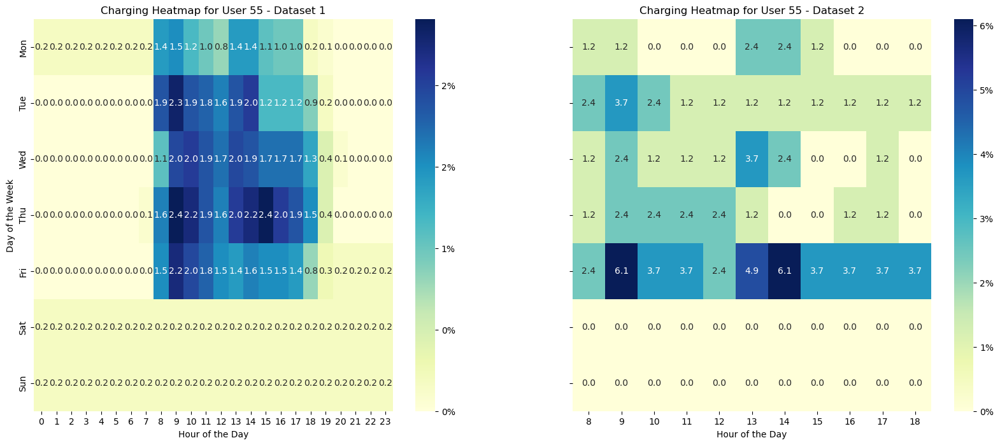

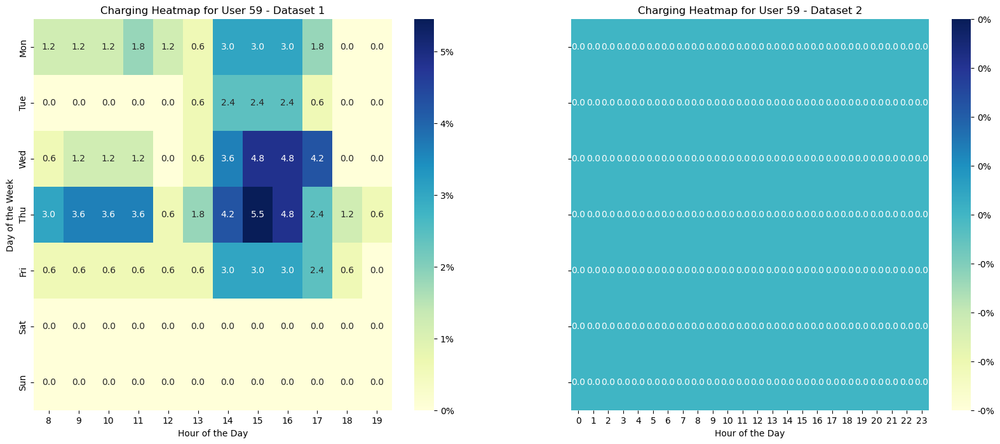

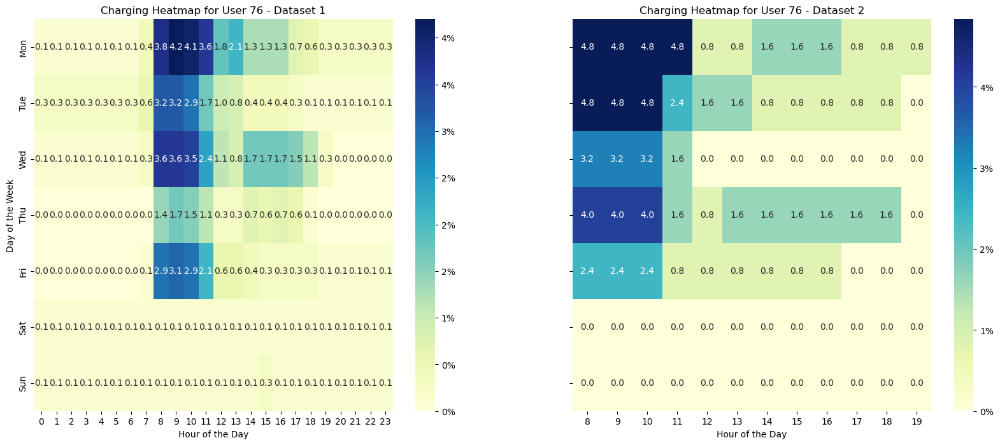

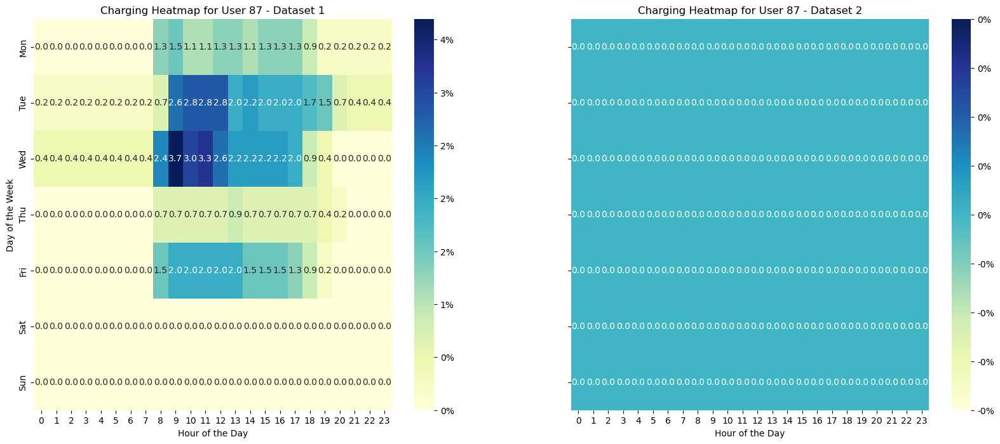

In [6]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

def preprocess_data(file_path):
    # Carregar os dados do usuário
    User = pd.read_excel(file_path)

    # Verificar os nomes das colunas
    print("Colunas do DataFrame:", User.columns)

    # Remove energy charge values less than 1 kWh
    User = User[User['Total Energy (kWh)'] >= 1]

    # Remove charge duration values less than 5 minutes
    User = User[User['Duration (min)'] >= 5]

    User['Start date'] = pd.to_datetime(User['Start date'], format='%m/%d/%Y | %H:%M')
    User['Stop date'] = pd.to_datetime(User['Stop date'], format='%m/%d/%Y | %H:%M')

    user_counts = User['Nº cartão EVIO'].value_counts()

    # Filter users with more than 10 observations
    users_with_more_than_10_observations = user_counts[user_counts > 10].index

    # Filter the original DataFrame to include only these users
    User = User[User['Nº cartão EVIO'].isin(users_with_more_than_10_observations)]

    # Create additional columns for start hour and day of the week
    User['Start hour'] = User['Start date'].dt.hour
    User['Weekday'] = User['Start date'].dt.dayofweek

    # Function to expand the occupied hours during charging
    def expand_hours(row):
        start = row['Start date']
        stop = row['Stop date']
        hours = pd.date_range(start, stop, freq='H').tolist()
        return [(row['Nº cartão EVIO'], h.dayofweek, h.hour) for h in hours]

    # Apply the function to each row of the dataframe and create a new dataframe
    expanded_data = User.apply(expand_hours, axis=1).explode().tolist()
    expanded_df = pd.DataFrame(expanded_data, columns=['Nº cartão EVIO', 'Weekday', 'Hour'])

    return expanded_df

def create_heatmap_data(data, user):
    if data.empty:
        return pd.DataFrame(index=['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'], columns=range(24)).fillna(0)
    
    # Filter data for the current user
    User_usuario = data[data['Nº cartão EVIO'] == user]

    # Create a count matrix of charging occurrences by hour and day of the week
    heatmap_data = User_usuario.groupby(['Weekday', 'Hour']).size().unstack(fill_value=0)
    
    # Ensure that all 7 rows of the days of the week are present
    all_weekdays = pd.Index(range(7), name='Weekday')
    heatmap_data = heatmap_data.reindex(all_weekdays, fill_value=0)
    
    # Calculate the percentage in relation to the total hours of charging
    total_hours = heatmap_data.values.sum()
    heatmap_data_percent = (heatmap_data / total_hours) * 100

    # Set the days of the week to start from Monday
    heatmap_data_percent.index = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']

    return heatmap_data_percent

def plot_heatmaps_side_by_side(data1, data2, user):
    heatmap_data1 = create_heatmap_data(data1, user)
    heatmap_data2 = create_heatmap_data(data2, user)

    fig, axes = plt.subplots(1, 2, figsize=(20, 8), sharey=True)
    
    sns.heatmap(heatmap_data1, cmap="YlGnBu", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'}, ax=axes[0])
    axes[0].set_title(f"Charging Heatmap for User {user} - Dataset 1")
    axes[0].set_xlabel("Hour of the Day")
    axes[0].set_ylabel("Day of the Week")

    sns.heatmap(heatmap_data2, cmap="YlGnBu", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'}, ax=axes[1])
    axes[1].set_title(f"Charging Heatmap for User {user} - Dataset 2")
    axes[1].set_xlabel("Hour of the Day")

    plt.show()

# Load and preprocess the data for both datasets
file1 = 'EVIO_history_01-02-2023_29-02-2024.xlsx'
file2 = 'EVIO_history_01-03-2024_01-06-2024.xlsx'

data1 = preprocess_data(file1)
data2 = preprocess_data(file2)

# Get unique list of users from both datasets
usuarios = set(data1['Nº cartão EVIO'].unique()).union(set(data2['Nº cartão EVIO'].unique()))

# Plot heatmaps for each user in both datasets
for usuario in usuarios:
    if usuario in data1['Nº cartão EVIO'].values and usuario in data2['Nº cartão EVIO'].values:
        plot_heatmaps_side_by_side(data1, data2, usuario)
    elif usuario in data1['Nº cartão EVIO'].values:
        plot_heatmaps_side_by_side(data1, pd.DataFrame(), usuario)
    elif usuario in data2['Nº cartão EVIO'].values:
        plot_heatmaps_side_by_side(pd.DataFrame(), data2, usuario)


             Start date           Stop date        Charging Place  \
0    03/28/2024 | 16:59  03/28/2024 | 18:44  Parque Sonae Capital   
1    03/28/2024 | 16:33  03/28/2024 | 16:41  Parque Sonae Capital   
2    03/28/2024 | 14:15  03/28/2024 | 15:01  Parque Sonae Capital   
3    03/28/2024 | 13:58  03/28/2024 | 19:33  Parque Sonae Capital   
4    03/28/2024 | 09:01  03/28/2024 | 12:47  Parque Sonae Capital   
..                  ...                 ...                   ...   
408  05/29/2024 | 13:28  05/29/2024 | 14:23  Parque Sonae Capital   
409  05/29/2024 | 15:06  05/29/2024 | 18:26  Parque Sonae Capital   
410  05/31/2024 | 08:42  05/31/2024 | 17:38  Parque Sonae Capital   
411  05/31/2024 | 09:06  05/31/2024 | 12:15  Parque Sonae Capital   
412  05/31/2024 | 09:07  05/31/2024 | 14:11  Parque Sonae Capital   

      Charging Station  Duration (min)  Total Energy (kWh) Nº cartão EVIO  
0    CAP_SON_MAI_00010         104.500                5.46             55  
1    CAP_SON_MAI_00

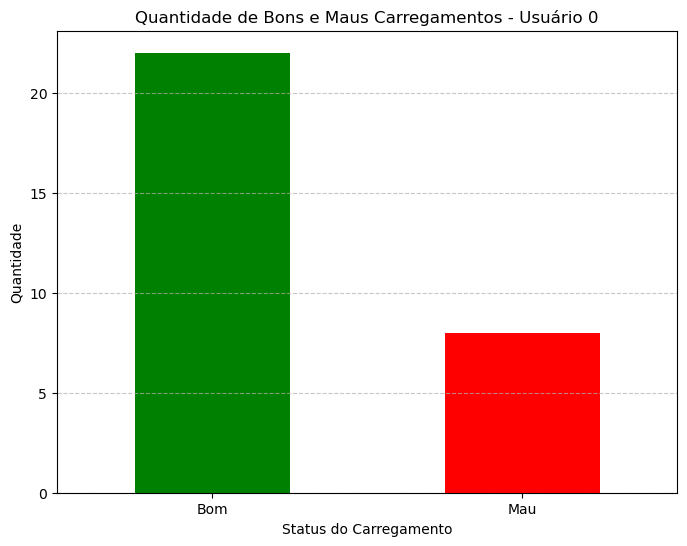

97.41140567780783


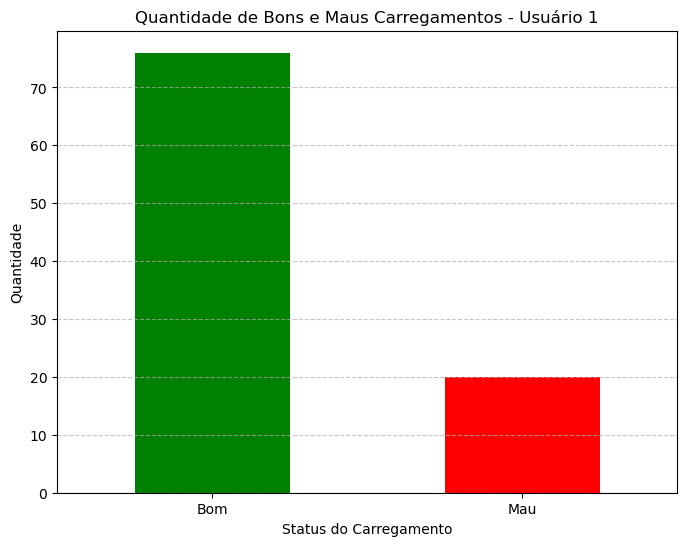

97.41140567780783


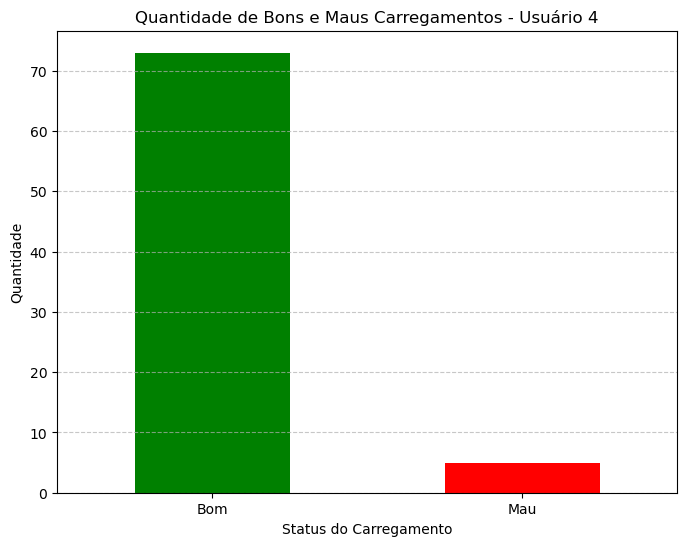

97.41140567780783


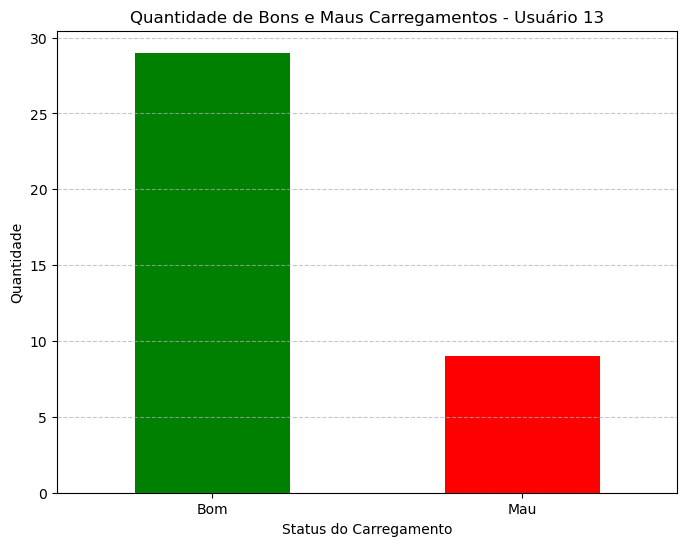

97.41140567780783


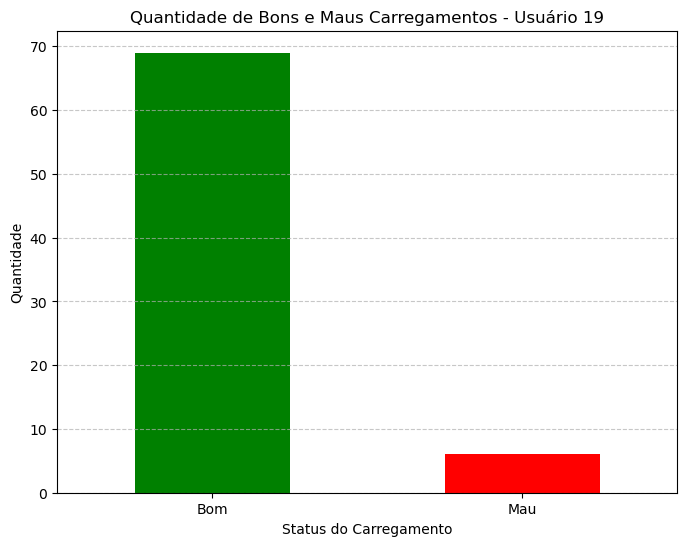

97.41140567780783


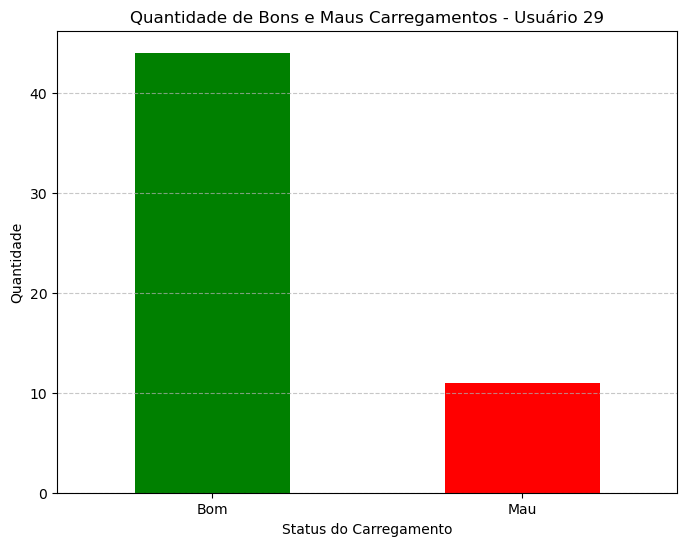

97.41140567780783
Nenhum dado para plotar para o usuário 30
97.41140567780783


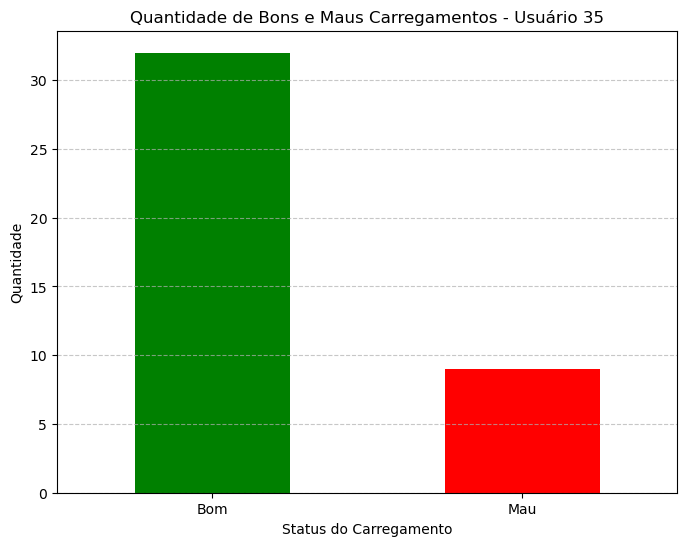

97.41140567780783


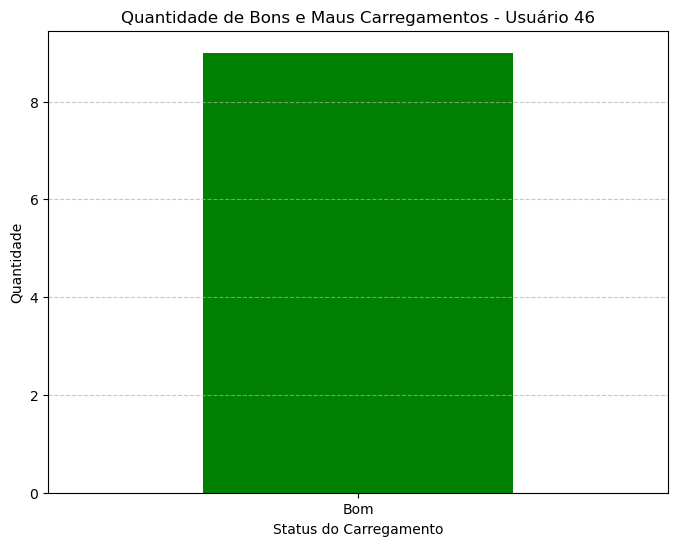

97.41140567780783


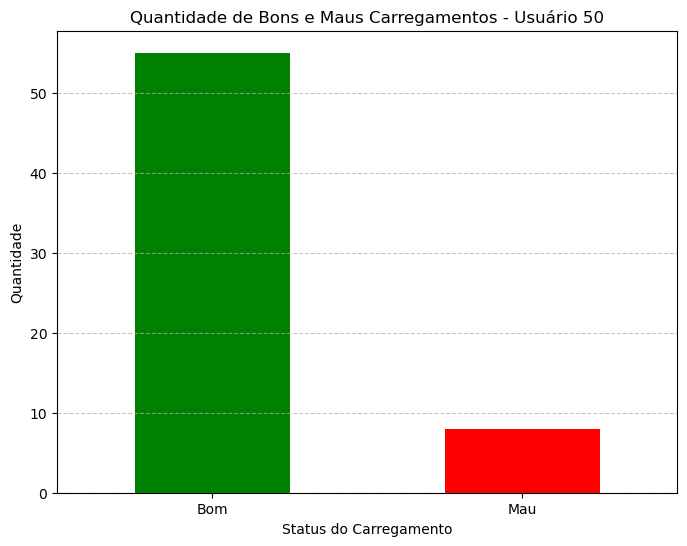

97.41140567780783


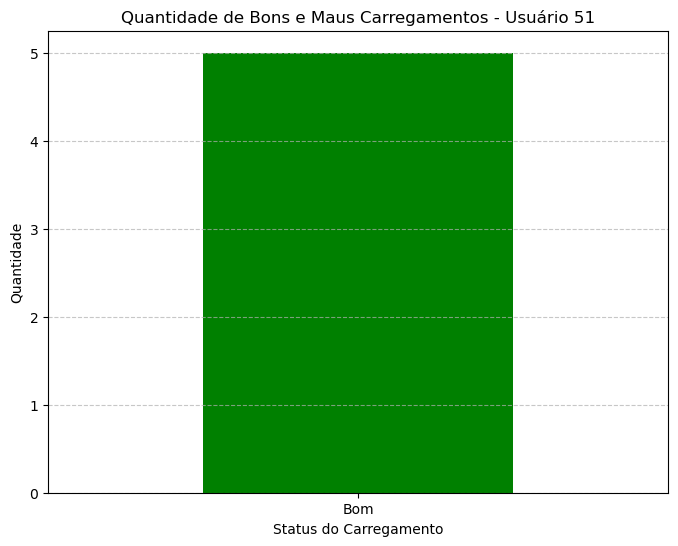

97.41140567780783


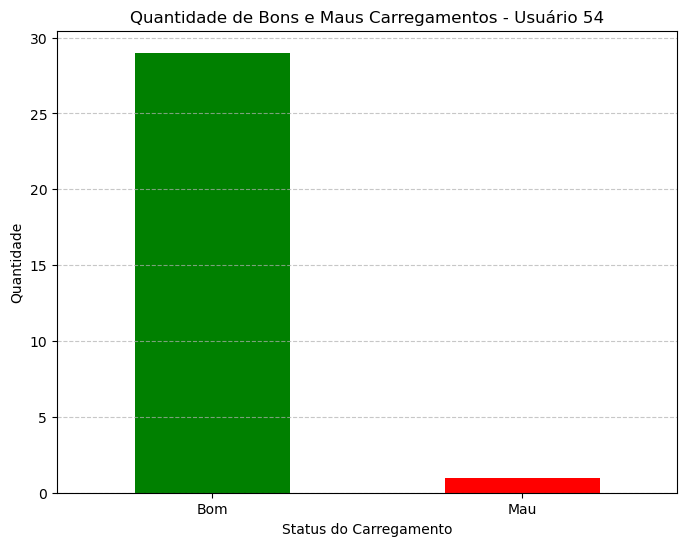

97.41140567780783


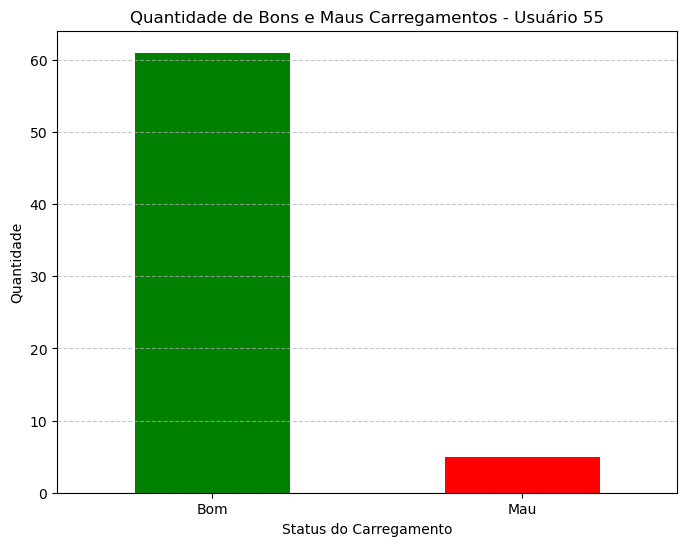

97.41140567780783


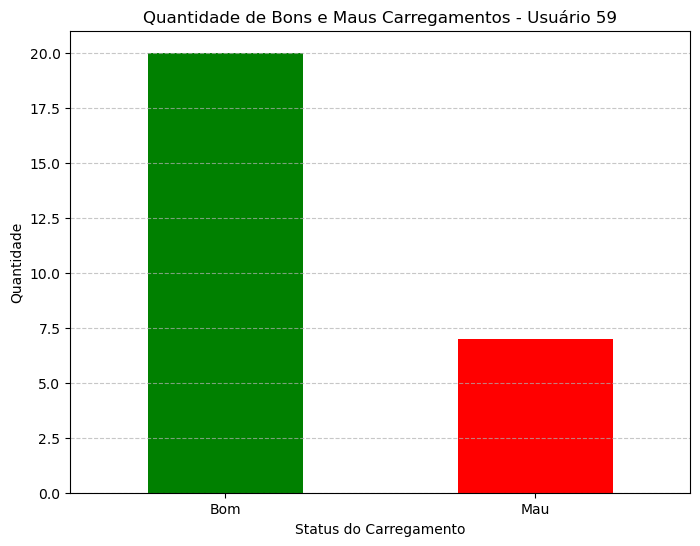

97.41140567780783


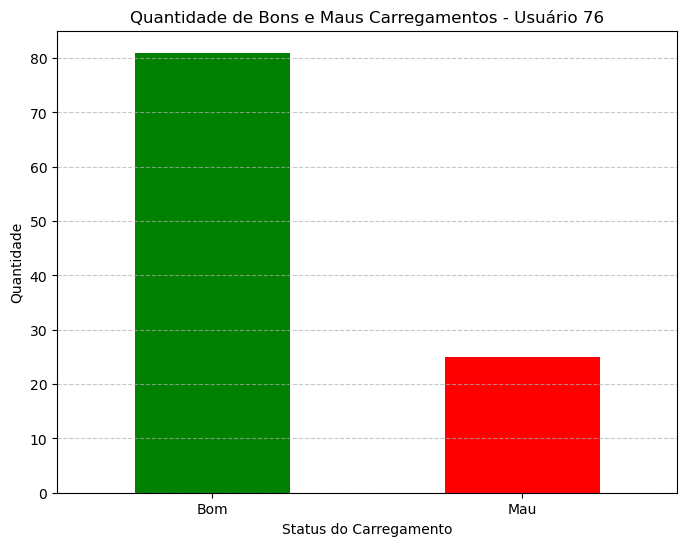

97.41140567780783


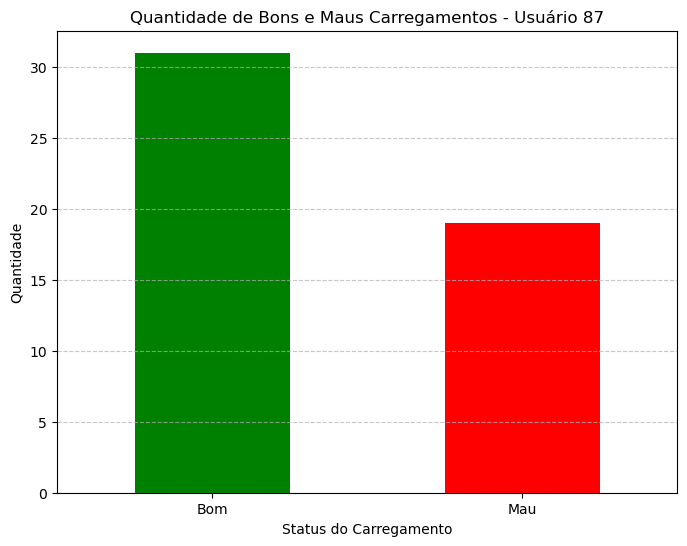

97.41140567780783


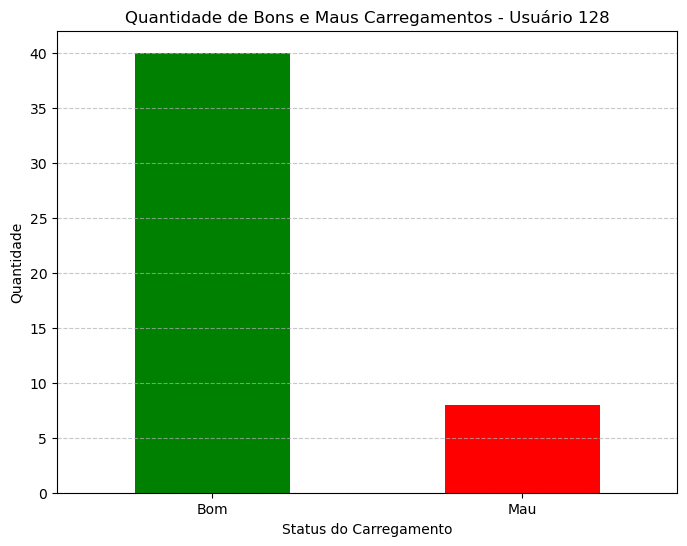

97.41140567780783


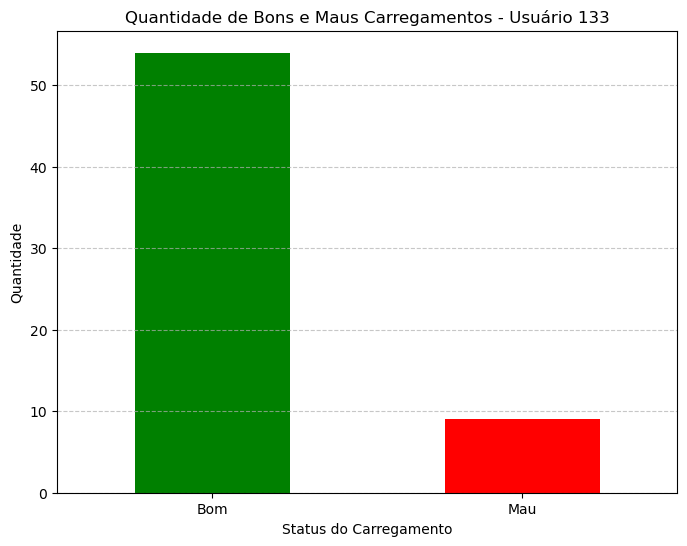

97.41140567780783


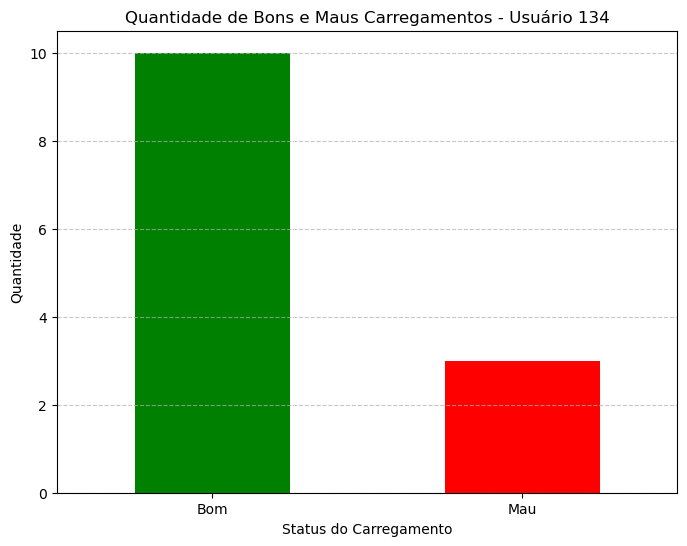

97.41140567780783


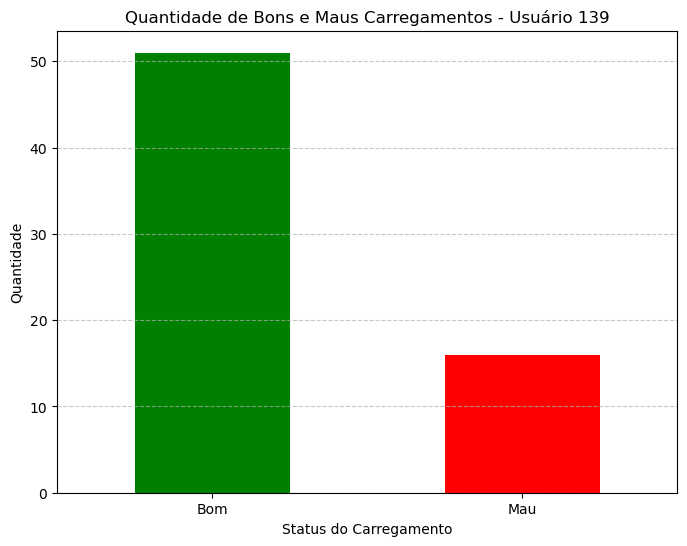

97.41140567780783


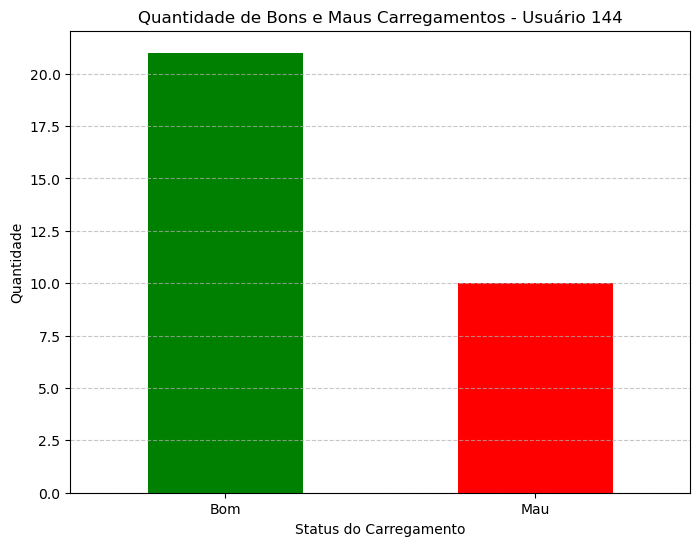

97.41140567780783


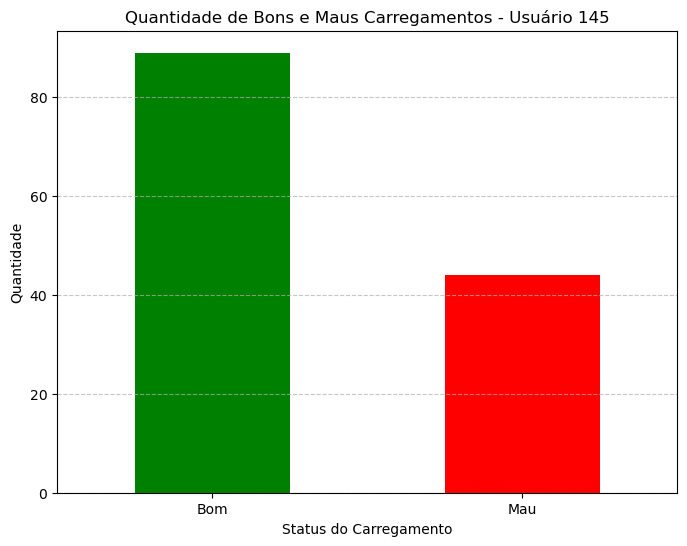

97.41140567780783


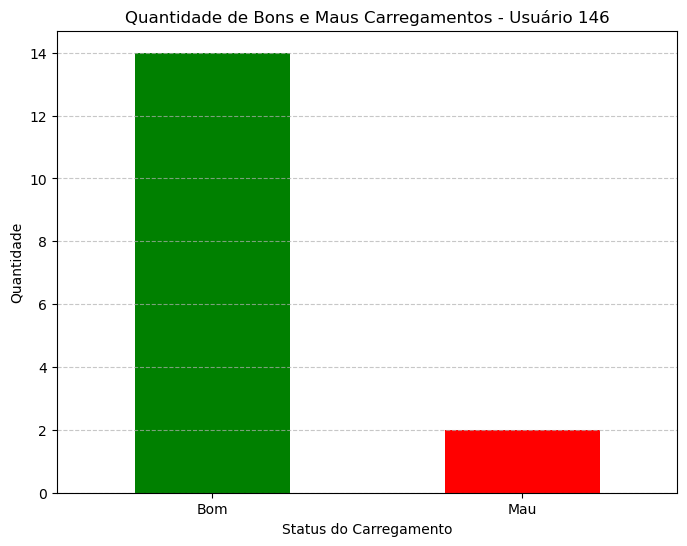

97.41140567780783


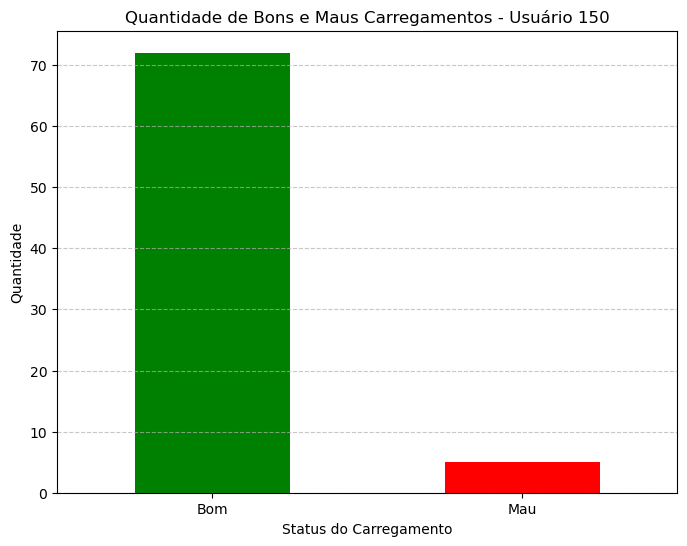

97.41140567780783


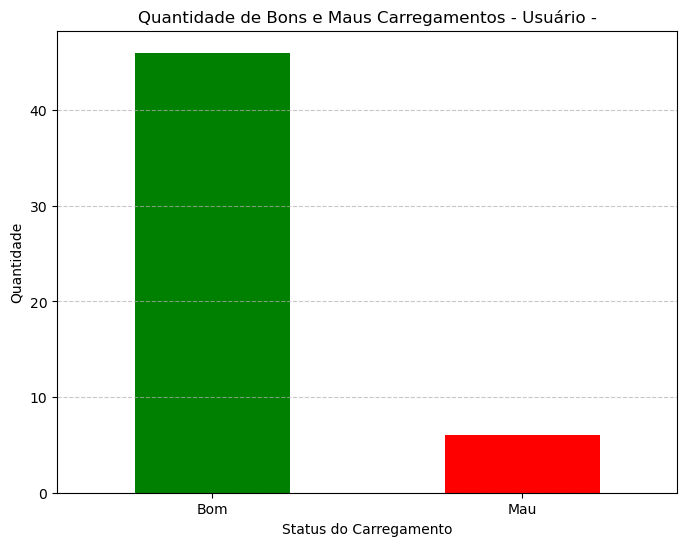

In [12]:
import pandas as pd
import matplotlib.pyplot as plt

# Carregar os dados do usuário
user_df = pd.read_excel('EVIO_history_01-03-2024_01-06-2024.xlsx')


# Carregar os dados de incentivos
incentivos_df = pd.read_csv('output_data_2024-03-01_to_2024-06-30.csv', sep=';')
#print(incentivos_df)

# Separar a coluna de incentivos em várias colunas
incentivos_df.columns = ['datetime', 'request', 'value', 'unit', 'quality', 'updated_at', 'Hour']
incentivos_df['datetime'] = pd.to_datetime(incentivos_df['datetime'], format='%Y-%m-%d %H:%M:%S')

# Remover fuso horário das datas de incentivos_df (ou ajustar fuso horário conforme necessário)
incentivos_df['datetime'] = incentivos_df['datetime'].dt.tz_localize(None)

# Preparação dos dados de User
user_df['Start date'] = pd.to_datetime(user_df['Start date'], format='%m/%d/%Y | %H:%M')
user_df['Stop date'] = pd.to_datetime(user_df['Stop date'], format='%m/%d/%Y | %H:%M')

# Remover fuso horário das datas de user_df (ou ajustar fuso horário conforme necessário)
user_df['Start date'] = user_df['Start date'].dt.tz_localize(None)
user_df['Stop date'] = user_df['Stop date'].dt.tz_localize(None)

# Substituir vírgulas por pontos e converter para float se necessário
incentivos_df['value'] = incentivos_df['value'].astype(str).str.replace(',', '.').astype(float)

# Agrupar dados de user_df por 'Nº cartão EVIO'
users_grouped = user_df.groupby('Nº cartão EVIO')

# Função para verificar se uma datetime está dentro de algum intervalo
def check_if_in_intervals(dt, intervals):
    for start, stop in intervals:
        if start <= dt <= stop:
            return 1
    return 0

# Iterar por cada usuário
for user_id, group in users_grouped:
    # Criar uma lista de intervalos de tempo de carregamento para o usuário atual
    intervals = [(start, stop) for start, stop in zip(group['Start date'], group['Stop date'])]
    
    # Aplicar a função em todas as datetimes do incentivos_df
    incentivos_df['Carregamento'] = incentivos_df['datetime'].apply(lambda x: check_if_in_intervals(x, intervals))
    print(incentivos_df['Carregamento'])
    
    # Selecionar apenas as colunas datetime e Carregamento
    resultado_df = incentivos_df[['datetime', 'Carregamento']]
    
    # Filtrar as linhas onde 'Carregamento' é igual a 1
    carregamentos = resultado_df[resultado_df['Carregamento'] == 1]
    
    # Realizar o merge dos DataFrames
    merged_df = pd.merge(carregamentos, incentivos_df[['datetime', 'value']], on='datetime', how='inner')
    
    # Calcular o quantil (50%) do máximo para cada dia
    incentivos_df['date'] = incentivos_df['datetime'].dt.date
    daily_max_quantile = incentivos_df.groupby('date')['value'].max().quantile(0.5)
    print(daily_max_quantile)
    
    # Verificar se os valores estão acima ou abaixo do quantil calculado
    merged_df['Status'] = merged_df['value'].apply(lambda x: 'Bom' if x < daily_max_quantile else 'Mau')

    
    # Verificar se os valores estão acima ou abaixo do valor de referência (50)
    #merged_df['Status'] = merged_df['value'].apply(lambda x: 'Bom' if x < 70 else 'Mau')
    
    # Contar bons e maus carregamentos
    status_counts = merged_df['Status'].value_counts()
    
    if not status_counts.empty:
        # Definir cores para o gráfico
        colors = ['green' if status == 'Bom' else 'red' for status in status_counts.index]
        
        # Plotar o gráfico de barras
        plt.figure(figsize=(8, 6))
        status_counts.plot(kind='bar', color=colors)
        plt.title(f'Quantidade de Bons e Maus Carregamentos - Usuário {user_id}')
        plt.xlabel('Status do Carregamento')
        plt.ylabel('Quantidade')
        plt.xticks(rotation=0)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        
        # Mostrar o gráfico
        plt.show()
    else:
        print(f'Nenhum dado para plotar para o usuário {user_id}')

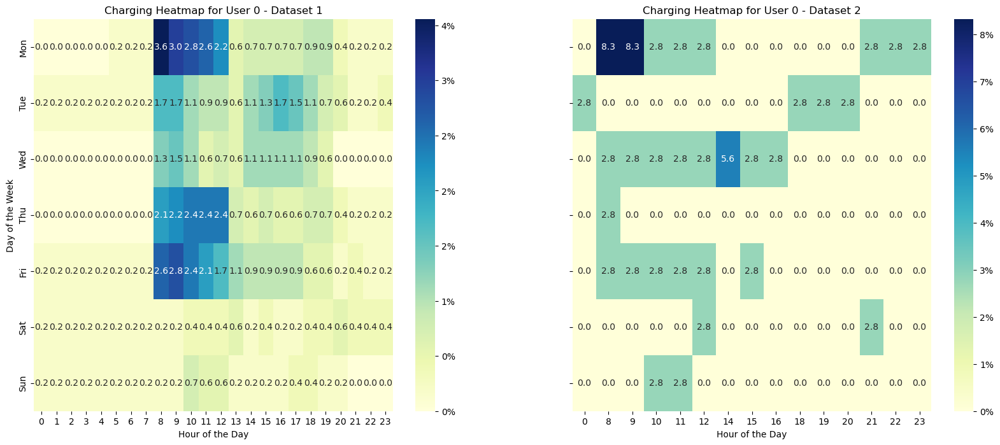

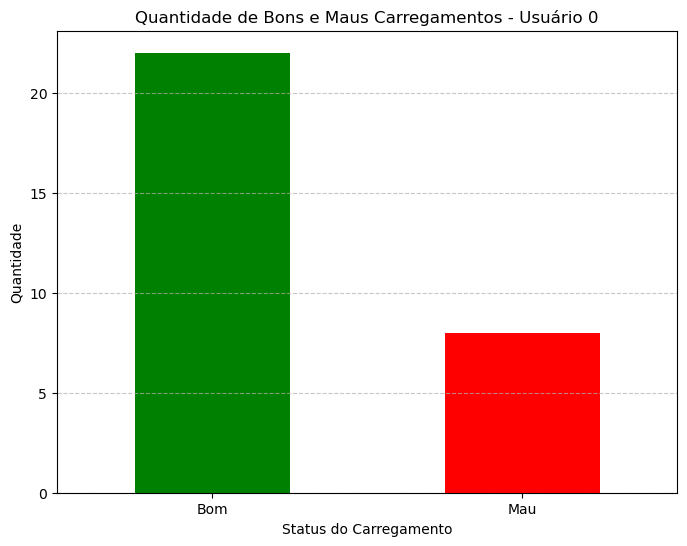

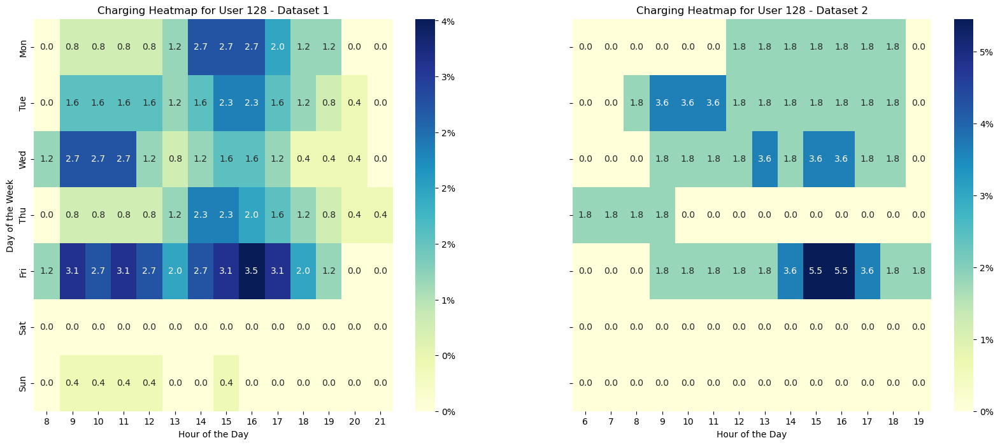

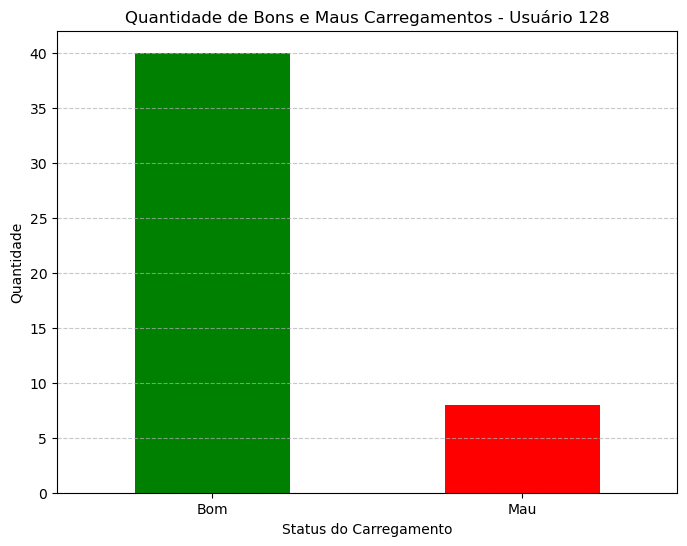

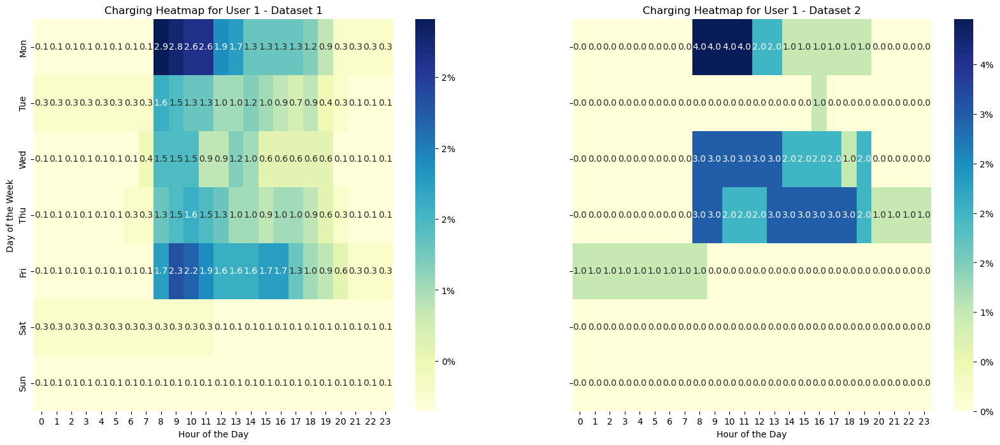

...

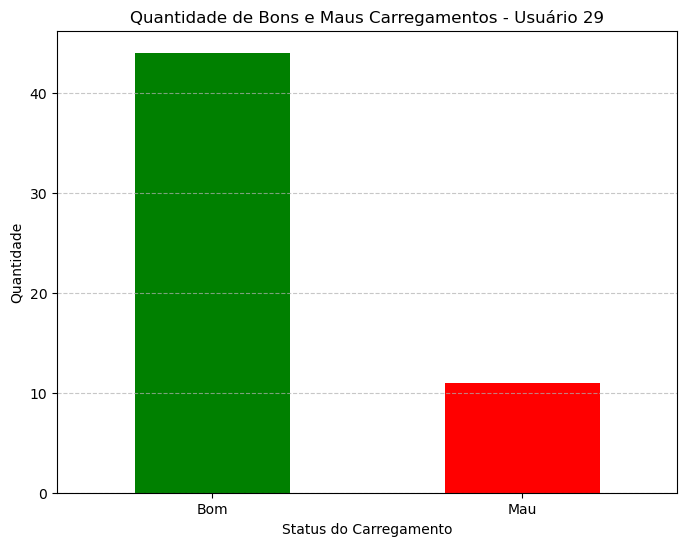

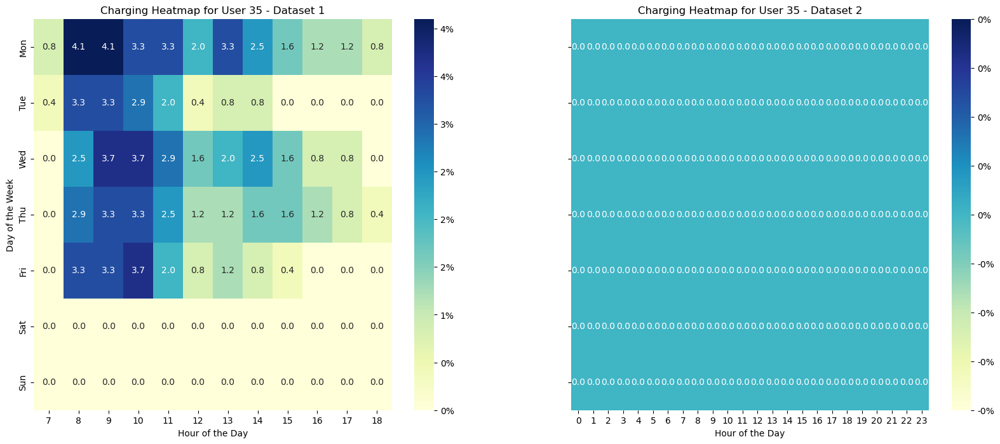

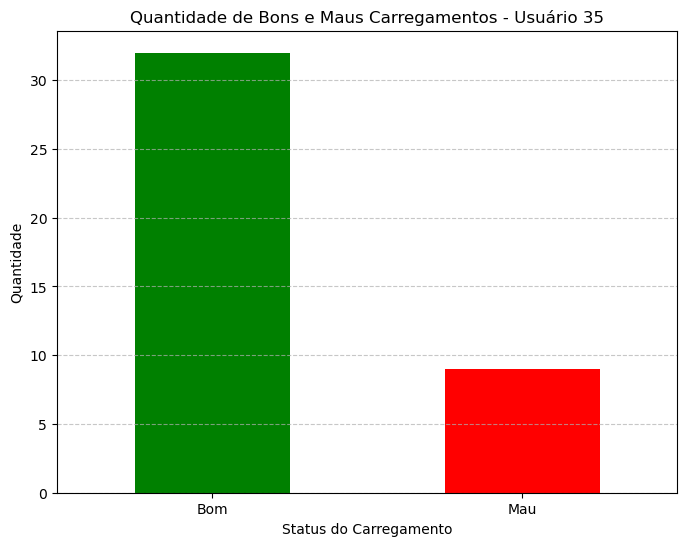

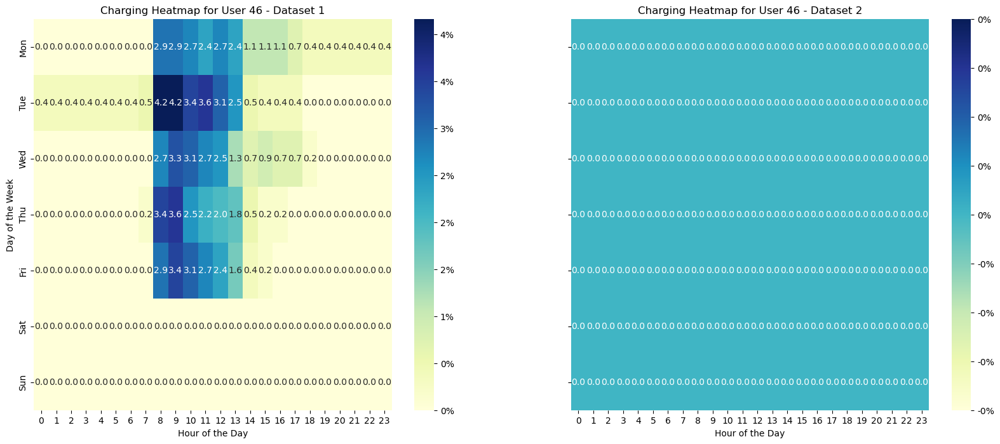

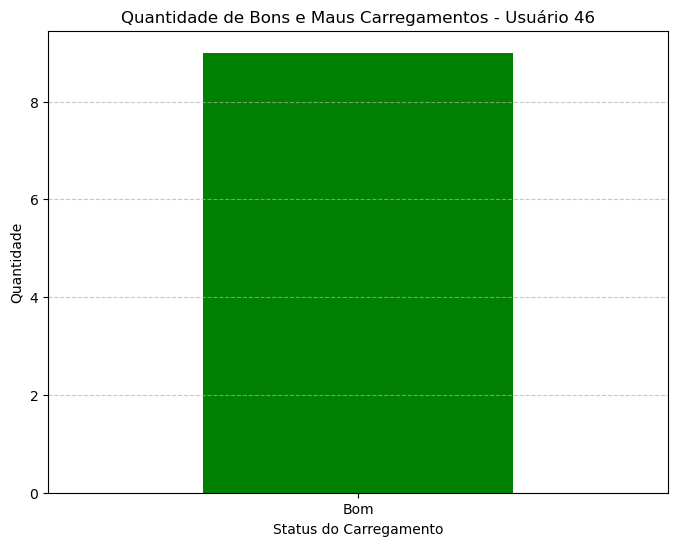

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\1632011558.py:128: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if usuario in data1['Nº cartão EVIO'].values and usuario in data2['Nº cartão EVIO'].values:


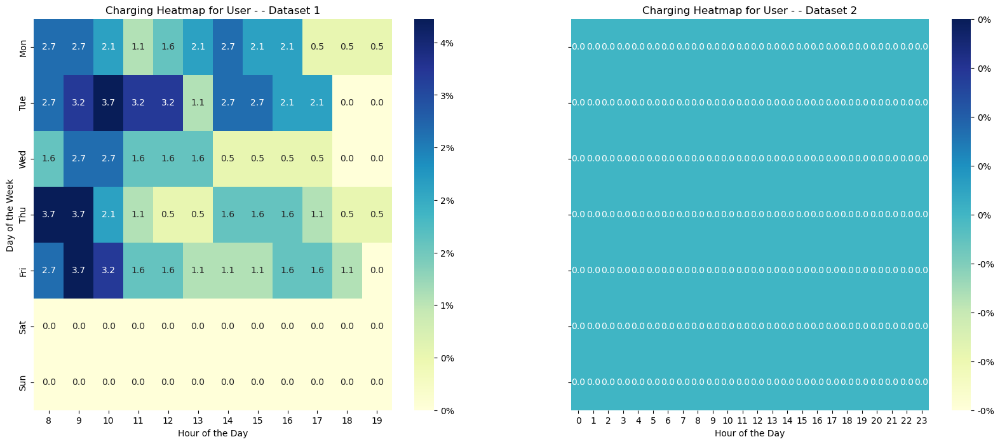

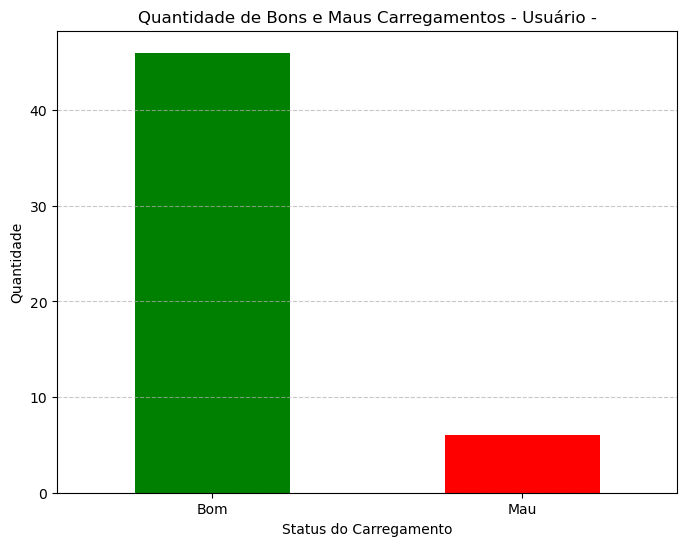

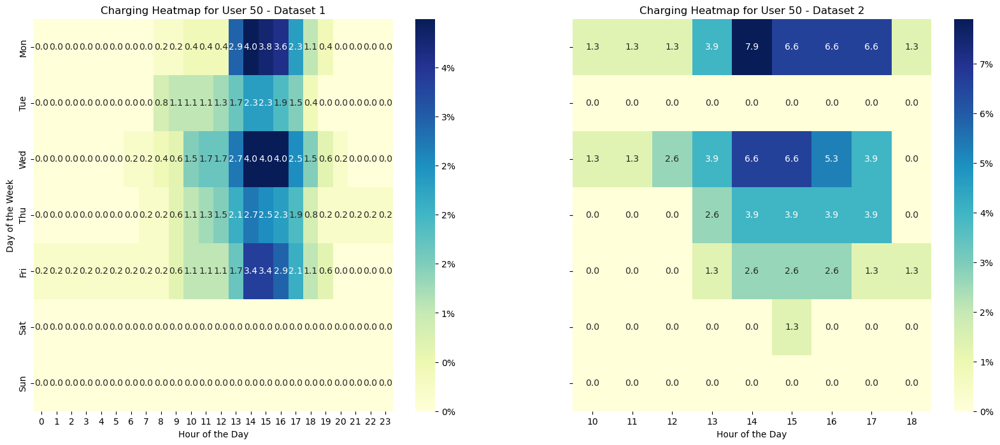

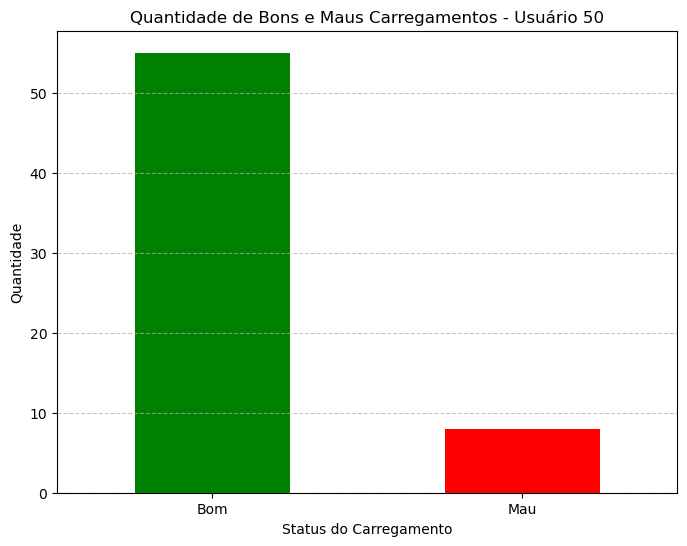

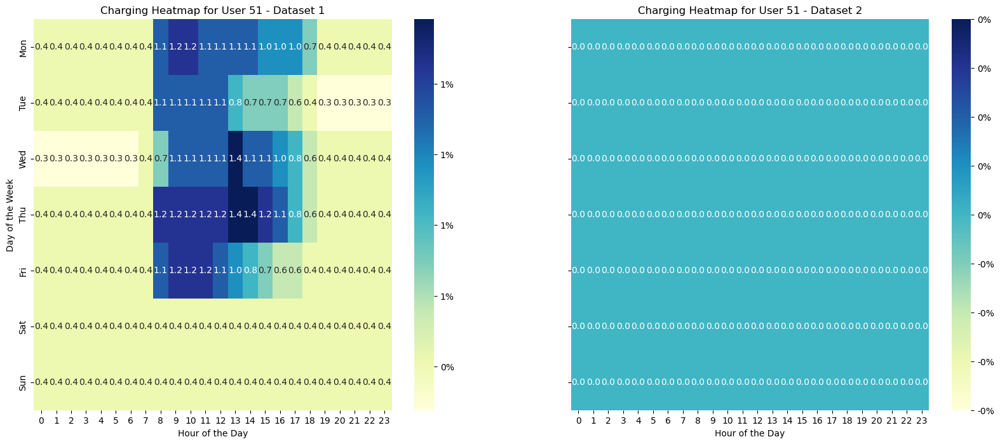

...

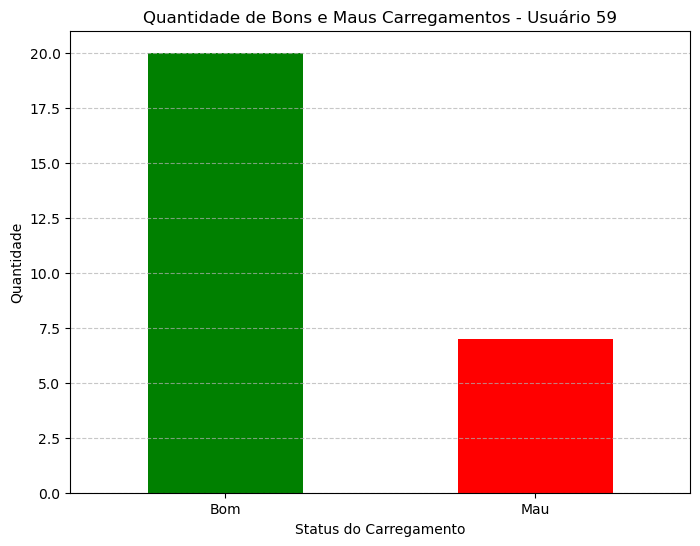

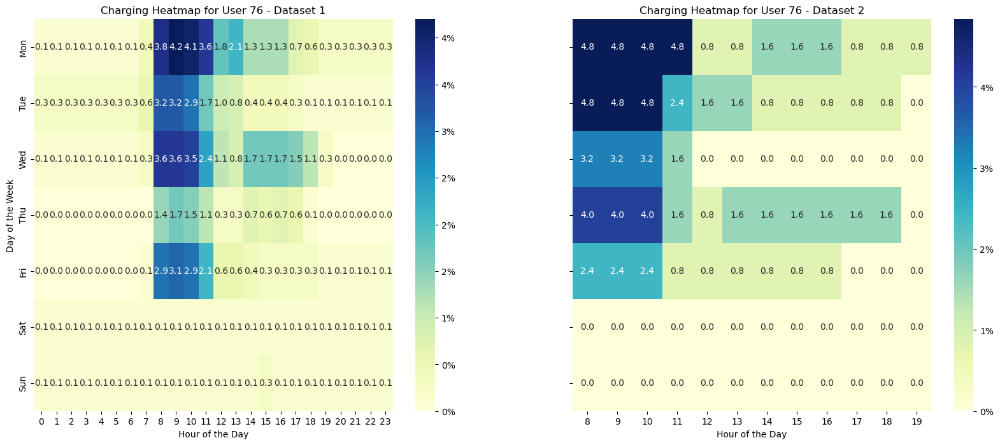

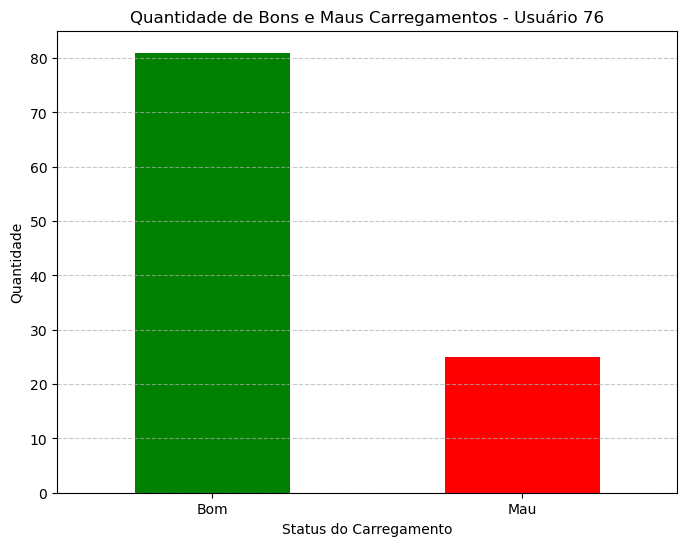

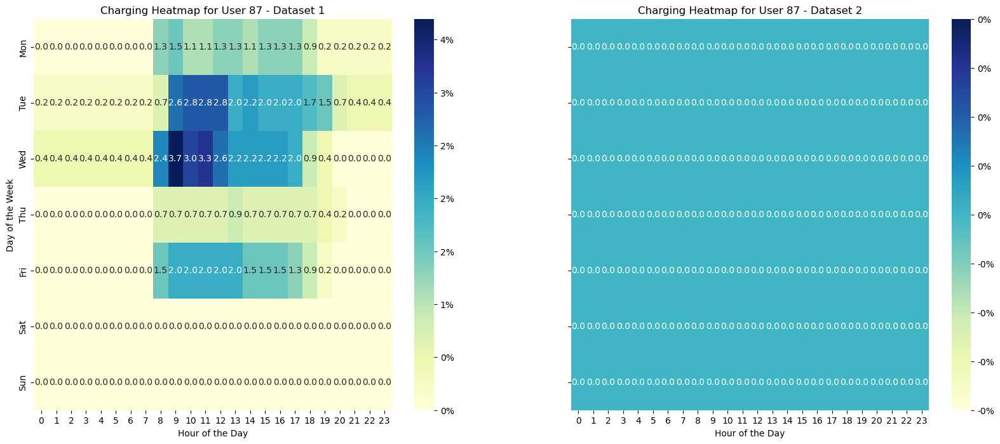

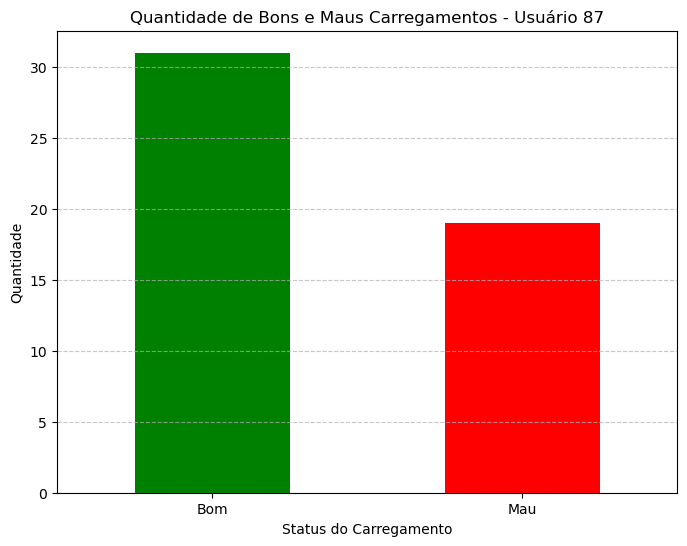

In [11]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Função para preprocessar os dados
def preprocess_data(file_path):
    User = pd.read_excel(file_path)
    User = User[User['Total Energy (kWh)'] >= 1]
    User = User[User['Duration (min)'] >= 5]

    User['Start date'] = pd.to_datetime(User['Start date'], format='%m/%d/%Y | %H:%M')
    User['Stop date'] = pd.to_datetime(User['Stop date'], format='%m/%d/%Y | %H:%M')

    user_counts = User['Nº cartão EVIO'].value_counts()
    users_with_more_than_10_observations = user_counts[user_counts > 10].index
    User = User[User['Nº cartão EVIO'].isin(users_with_more_than_10_observations)]

    User['Start hour'] = User['Start date'].dt.hour
    User['Weekday'] = User['Start date'].dt.dayofweek

    def expand_hours(row):
        start = row['Start date']
        stop = row['Stop date']
        hours = pd.date_range(start, stop, freq='H').tolist()
        return [(row['Nº cartão EVIO'], h.dayofweek, h.hour) for h in hours]

    expanded_data = User.apply(expand_hours, axis=1).explode().tolist()
    expanded_df = pd.DataFrame(expanded_data, columns=['Nº cartão EVIO', 'Weekday', 'Hour'])

    return expanded_df

def create_heatmap_data(data, user):
    if data.empty:
        return pd.DataFrame(index=['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'], columns=range(24)).fillna(0)

    User_usuario = data[data['Nº cartão EVIO'] == user]
    heatmap_data = User_usuario.groupby(['Weekday', 'Hour']).size().unstack(fill_value=0)
    all_weekdays = pd.Index(range(7), name='Weekday')
    heatmap_data = heatmap_data.reindex(all_weekdays, fill_value=0)
    total_hours = heatmap_data.values.sum()
    heatmap_data_percent = (heatmap_data / total_hours) * 100
    heatmap_data_percent.index = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']

    return heatmap_data_percent

def plot_heatmaps_side_by_side(data1, data2, user):
    heatmap_data1 = create_heatmap_data(data1, user)
    heatmap_data2 = create_heatmap_data(data2, user)

    fig, axes = plt.subplots(1, 2, figsize=(20, 8), sharey=True)

    sns.heatmap(heatmap_data1, cmap="YlGnBu", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'}, ax=axes[0])
    axes[0].set_title(f"Charging Heatmap for User {user} - Dataset 1")
    axes[0].set_xlabel("Hour of the Day")
    axes[0].set_ylabel("Day of the Week")

    sns.heatmap(heatmap_data2, cmap="YlGnBu", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'}, ax=axes[1])
    axes[1].set_title(f"Charging Heatmap for User {user} - Dataset 2")
    axes[1].set_xlabel("Hour of the Day")

    plt.show()

# Adicionando gráfico de bons e maus carregamentos
def plot_bom_mau_carregamentos(user_df, incentivos_df):
    # Agrupar dados de user_df por 'Nº cartão EVIO'
    users_grouped = user_df.groupby('Nº cartão EVIO')

    # Função para verificar se uma datetime está dentro de algum intervalo
    def check_if_in_intervals(dt, intervals):
        for start, stop in intervals:
            if start <= dt <= stop:
                return 1
        return 0

    for user_id, group in users_grouped:
        intervals = [(start, stop) for start, stop in zip(group['Start date'], group['Stop date'])]
        incentivos_df['Carregamento'] = incentivos_df['datetime'].apply(lambda x: check_if_in_intervals(x, intervals))
        resultado_df = incentivos_df[['datetime', 'Carregamento']]
        carregamentos = resultado_df[resultado_df['Carregamento'] == 1]
        merged_df = pd.merge(carregamentos, incentivos_df[['datetime', 'value']], on='datetime', how='inner')

        incentivos_df['date'] = incentivos_df['datetime'].dt.date
        daily_max_quantile = incentivos_df.groupby('date')['value'].max().quantile(0.5)

        merged_df['Status'] = merged_df['value'].apply(lambda x: 'Bom' if x < daily_max_quantile else 'Mau')
        status_counts = merged_df['Status'].value_counts()

        if not status_counts.empty:
            colors = ['green' if status == 'Bom' else 'red' for status in status_counts.index]
            plt.figure(figsize=(8, 6))
            status_counts.plot(kind='bar', color=colors)
            plt.title(f'Quantidade de Bons e Maus Carregamentos - Usuário {user_id}')
            plt.xlabel('Status do Carregamento')
            plt.ylabel('Quantidade')
            plt.xticks(rotation=0)
            plt.grid(axis='y', linestyle='--', alpha=0.7)
            plt.show()
        else:
            print(f'Nenhum dado para plotar para o usuário {user_id}')

# Load and preprocess the data for both datasets
file1 = 'EVIO_history_01-02-2023_29-02-2024.xlsx'
file2 = 'EVIO_history_01-03-2024_01-06-2024.xlsx'

data1 = preprocess_data(file1)
data2 = preprocess_data(file2)

# Carregar e preparar dados de incentivos
incentivos_file = 'output_data_2024-03-01_to_2024-06-30.csv'
incentivos_df = pd.read_csv(incentivos_file, sep=';')
incentivos_df.columns = ['datetime', 'request', 'value', 'unit', 'quality', 'updated_at', 'Hour']
incentivos_df['datetime'] = pd.to_datetime(incentivos_df['datetime'], format='%Y-%m-%d %H:%M:%S')
incentivos_df['datetime'] = incentivos_df['datetime'].dt.tz_localize(None)
incentivos_df['value'] = incentivos_df['value'].astype(str).str.replace(',', '.').astype(float)

# Carregar e preparar dados de usuários
user_df = pd.read_excel('EVIO_history_01-03-2024_01-06-2024.xlsx')
user_df['Start date'] = pd.to_datetime(user_df['Start date'], format='%m/%d/%Y | %H:%M')
user_df['Stop date'] = pd.to_datetime(user_df['Stop date'], format='%m/%d/%Y | %H:%M')
user_df['Start date'] = user_df['Start date'].dt.tz_localize(None)
user_df['Stop date'] = user_df['Stop date'].dt.tz_localize(None)

# Get unique list of users from both datasets
usuarios = set(data1['Nº cartão EVIO'].unique()).union(set(data2['Nº cartão EVIO'].unique()))

# Plot heatmaps and bons/maus carregamentos for each user
for usuario in usuarios:
    if usuario in data1['Nº cartão EVIO'].values and usuario in data2['Nº cartão EVIO'].values:
        plot_heatmaps_side_by_side(data1, data2, usuario)
        plot_bom_mau_carregamentos(user_df[user_df['Nº cartão EVIO'] == usuario], incentivos_df)
    elif usuario in data1['Nº cartão EVIO'].values:
        plot_heatmaps_side_by_side(data1, pd.DataFrame(), usuario)
        plot_bom_mau_carregamentos(user_df[user_df['Nº cartão EVIO'] == usuario], incentivos_df)
    elif usuario in data2['Nº cartão EVIO'].values:
        plot_heatmaps_side_by_side(pd.DataFrame(), data2, usuario)
        plot_bom_mau_carregamentos(user_df[user_df['Nº cartão EVIO'] == usuario], incentivos_df)


              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

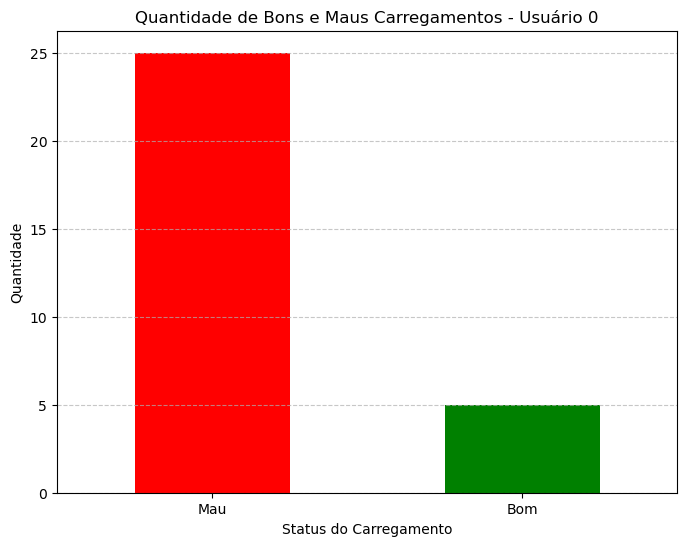

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

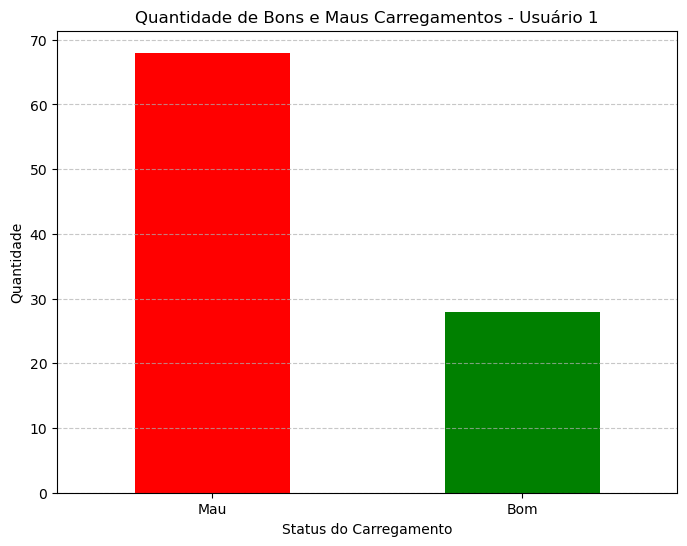

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

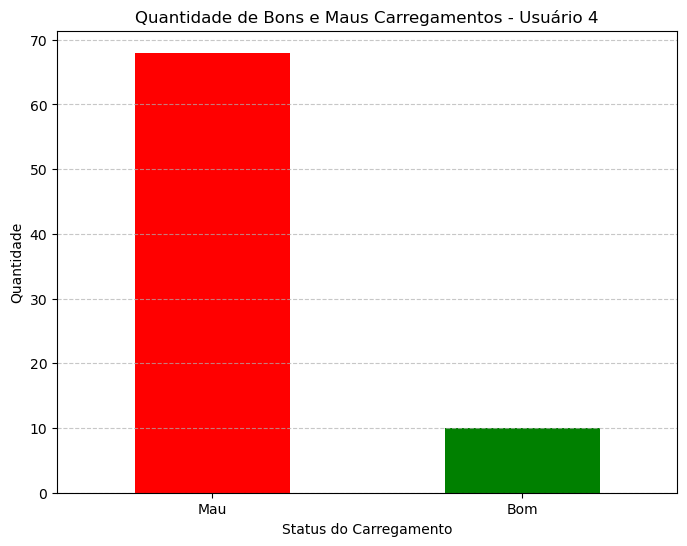

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

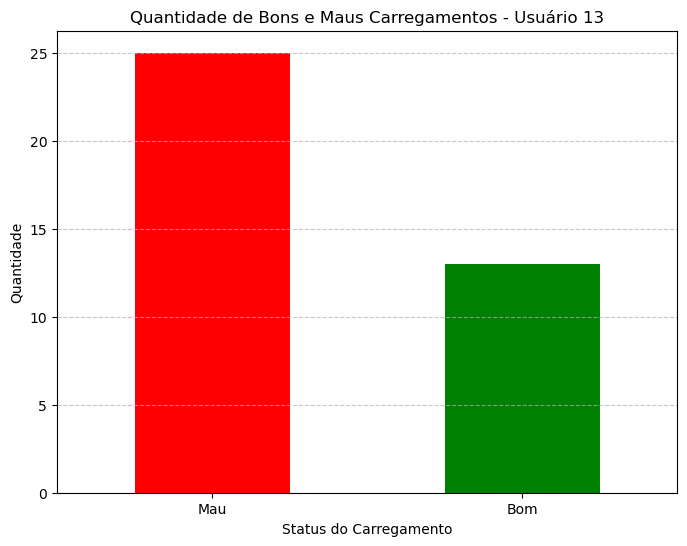

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

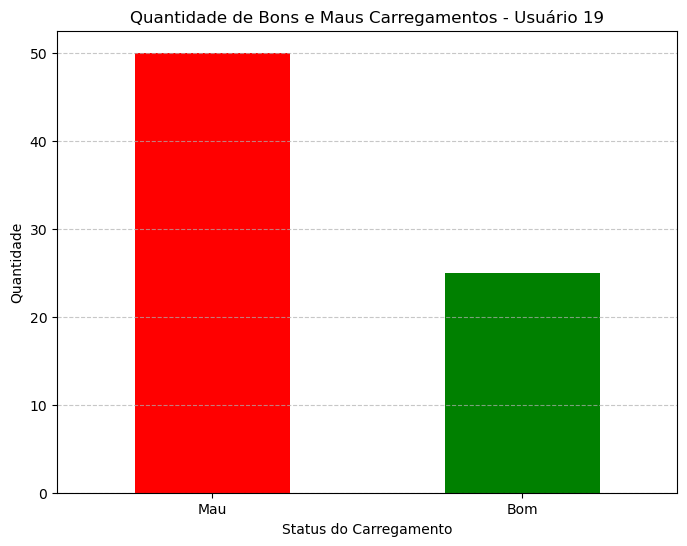

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

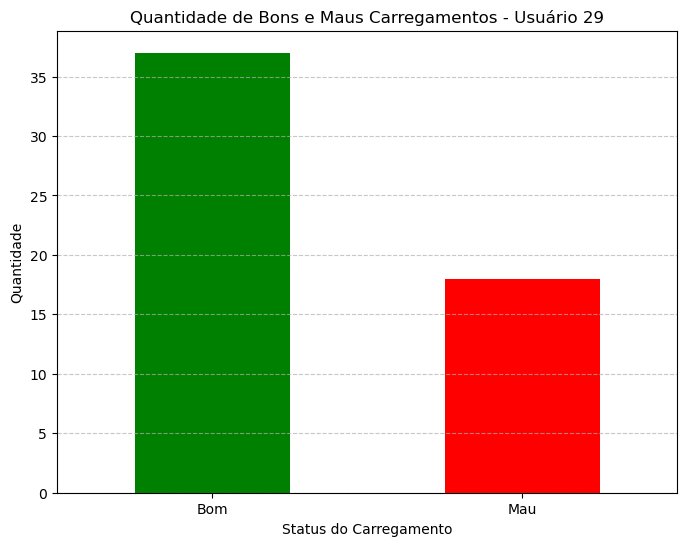

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

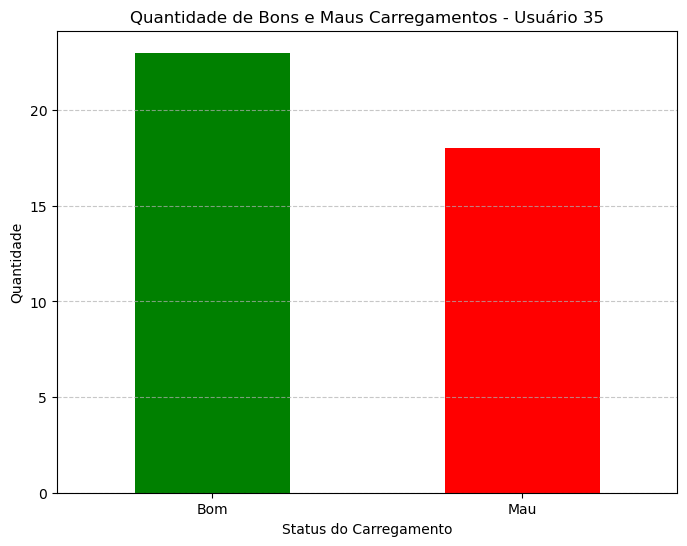

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

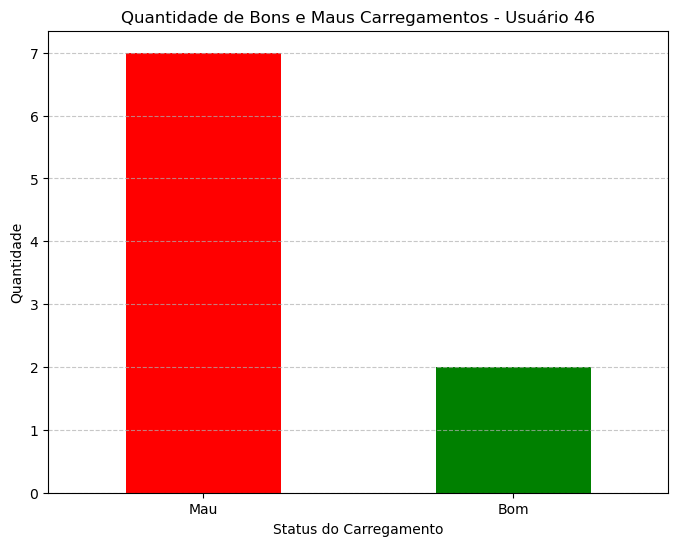

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

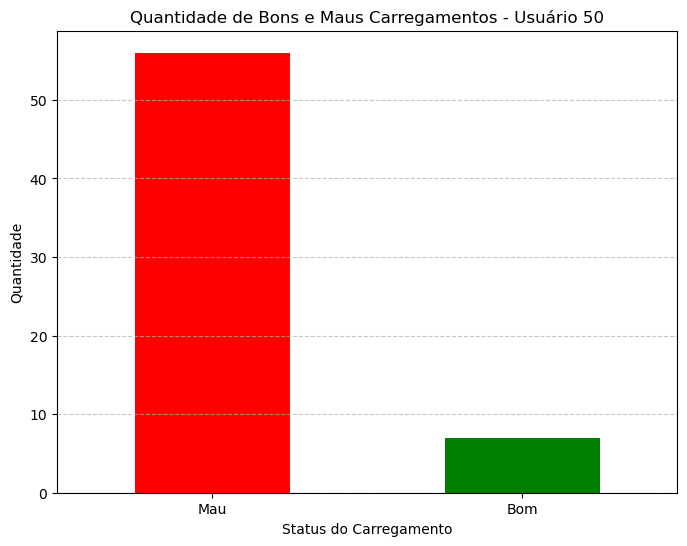

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

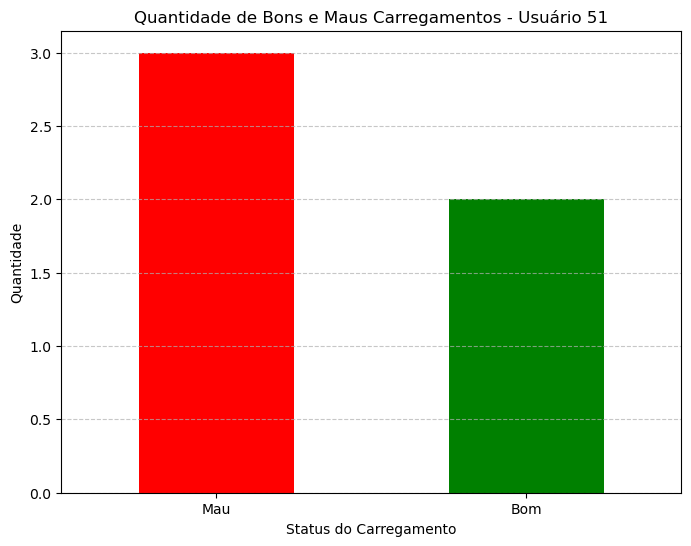

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

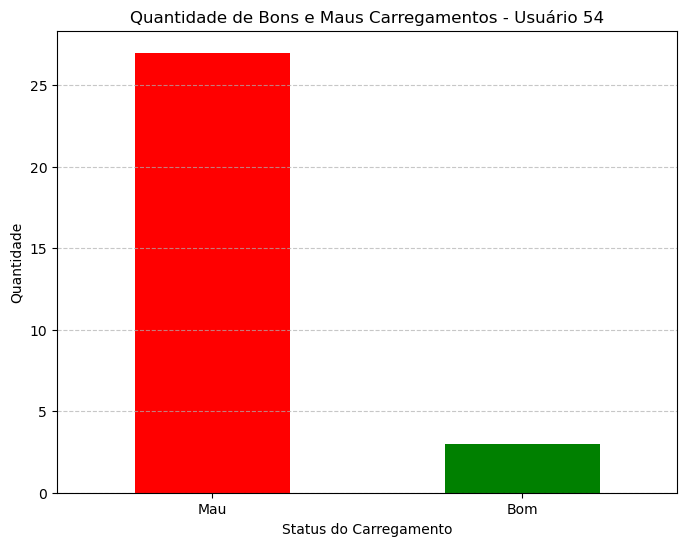

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

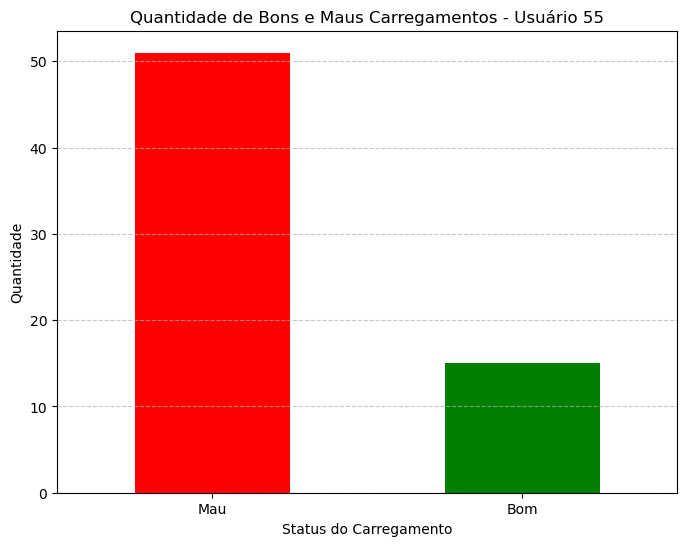

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

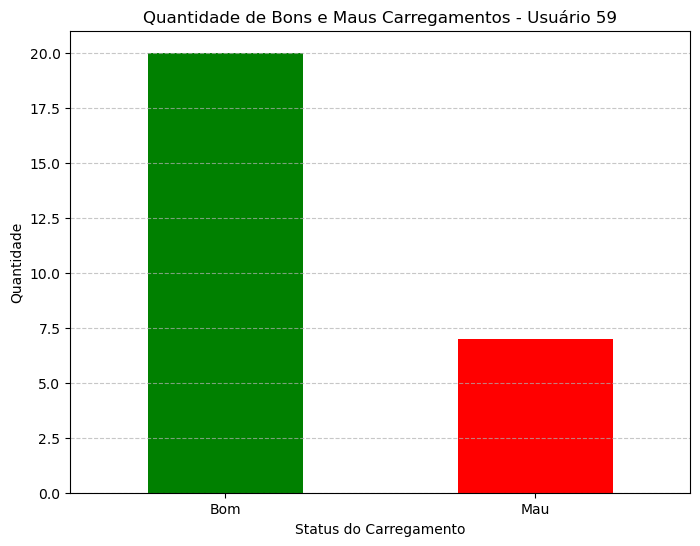

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

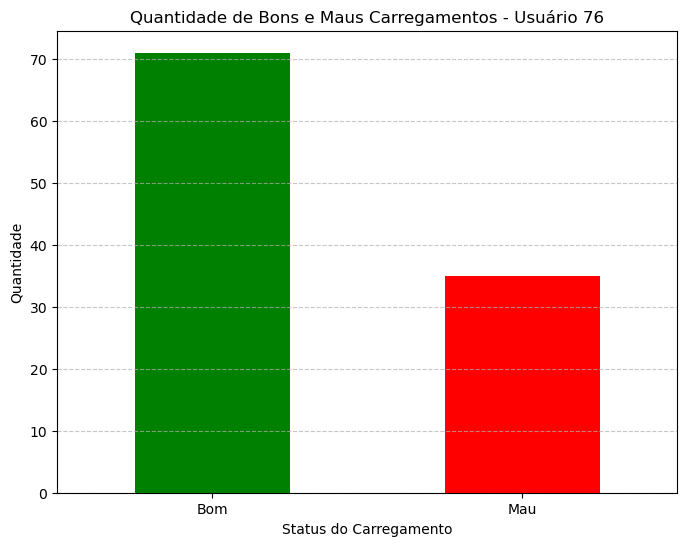

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

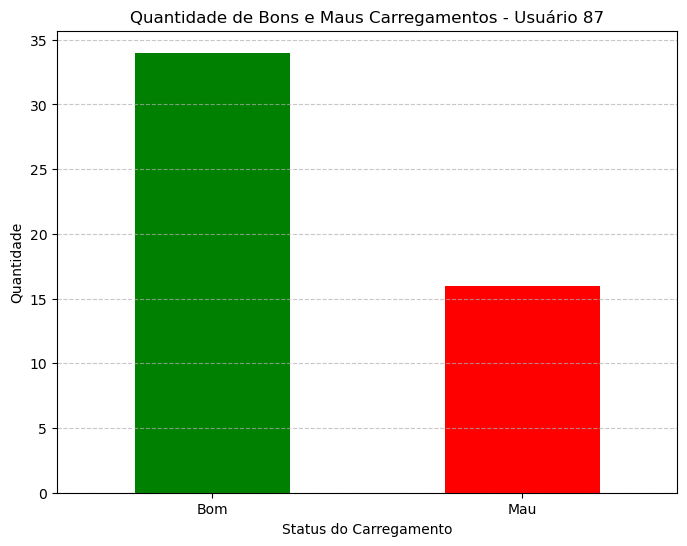

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

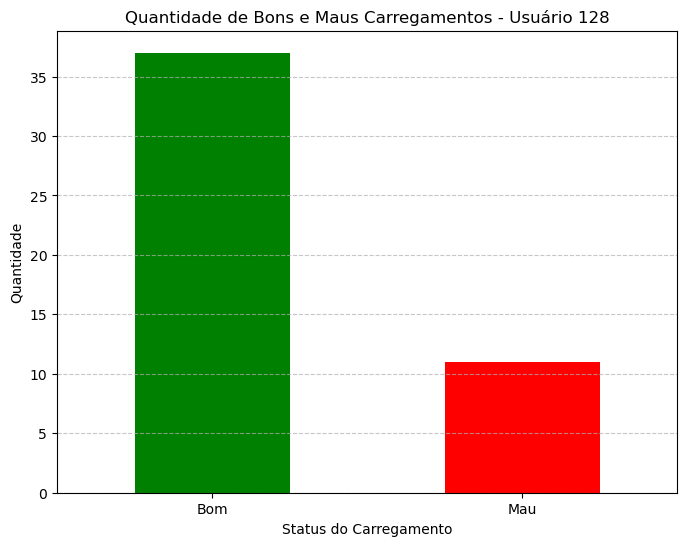

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

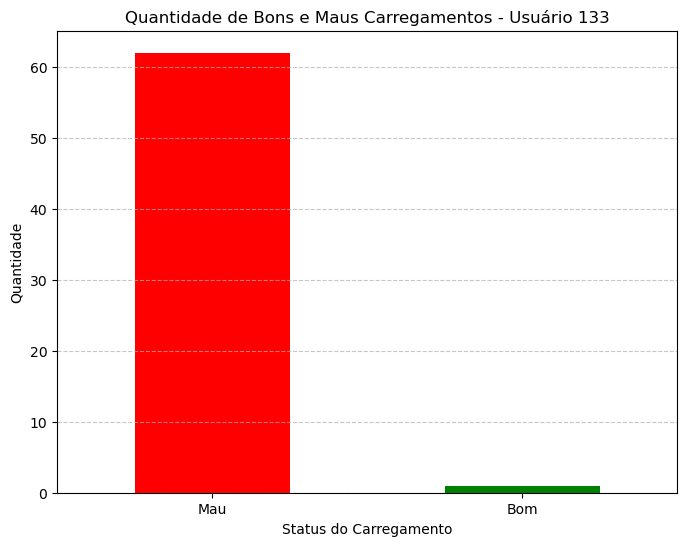

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

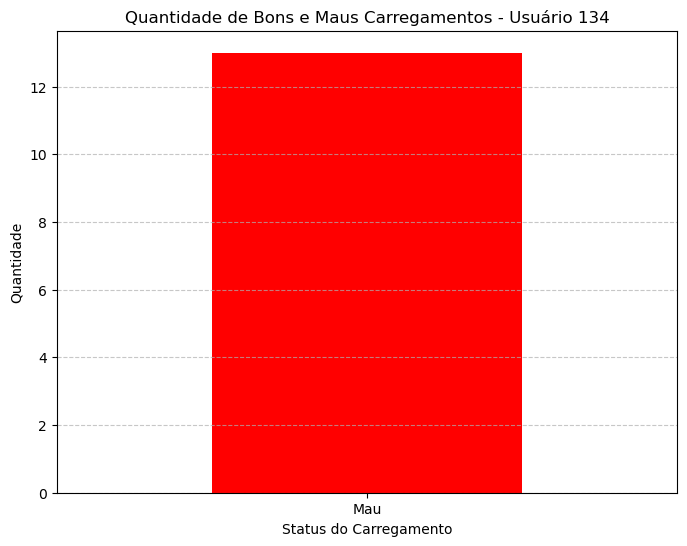

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

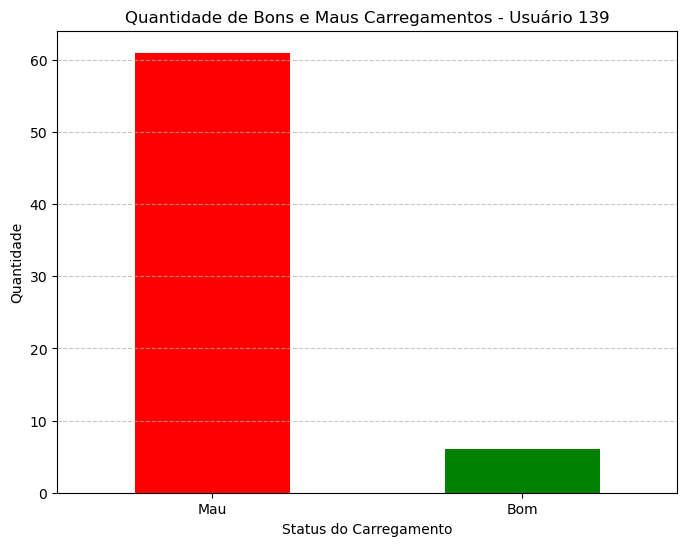

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

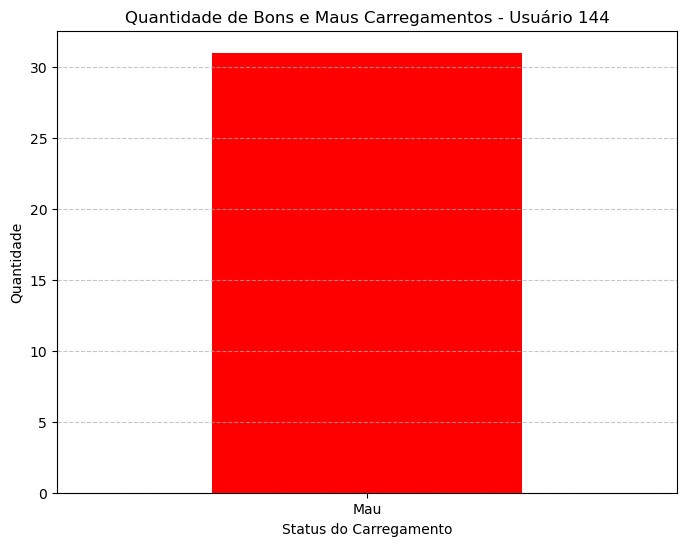

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

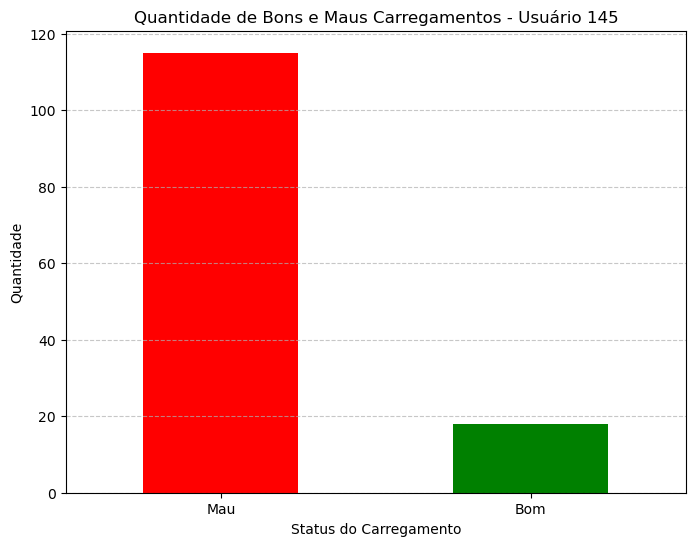

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

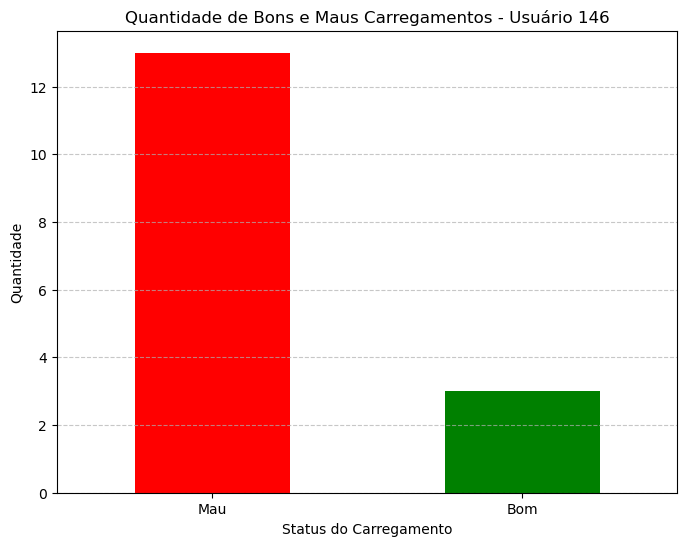

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

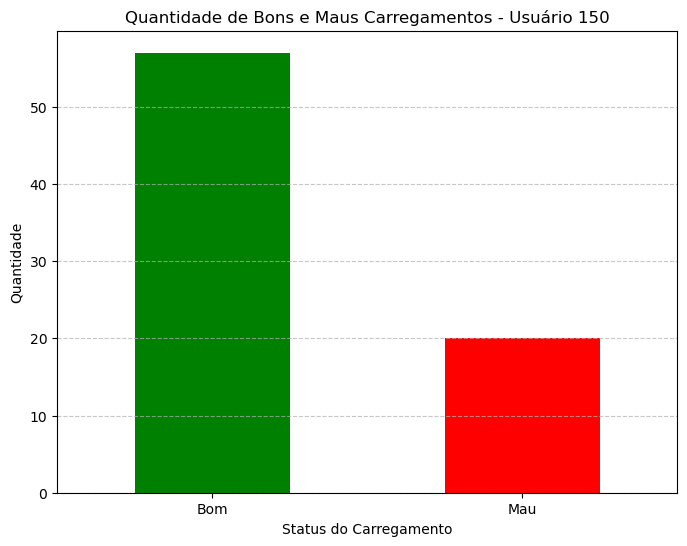

              datetime               request      value        unit  quality  \
0  2024-03-01 00:00:00  2024-02-29T20:15:02Z  59.096334  gCO₂eq/kWh        0   
1  2024-03-01 01:00:00  2024-02-29T20:15:02Z  62.827365  gCO₂eq/kWh        0   
2  2024-03-01 02:00:00  2024-02-29T20:15:02Z  65.317259  gCO₂eq/kWh        0   
3  2024-03-01 03:00:00  2024-02-29T20:15:02Z  65.180115  gCO₂eq/kWh        0   
4  2024-03-01 04:00:00  2024-02-29T20:15:02Z  65.154812  gCO₂eq/kWh        0   
5  2024-03-01 05:00:00  2024-02-29T20:15:02Z  49.861130  gCO₂eq/kWh        0   
6  2024-03-01 06:00:00  2024-02-29T20:15:02Z  50.115748  gCO₂eq/kWh        0   
7  2024-03-01 07:00:00  2024-02-29T20:15:02Z  55.833146  gCO₂eq/kWh        0   
8  2024-03-01 08:00:00  2024-02-29T20:15:02Z  52.985238  gCO₂eq/kWh        0   
9  2024-03-01 09:00:00  2024-02-29T20:15:02Z  59.441302  gCO₂eq/kWh        0   
10 2024-03-01 10:00:00  2024-02-29T20:15:02Z  63.493516  gCO₂eq/kWh        0   
11 2024-03-01 11:00:00  2024-02-29T20:15

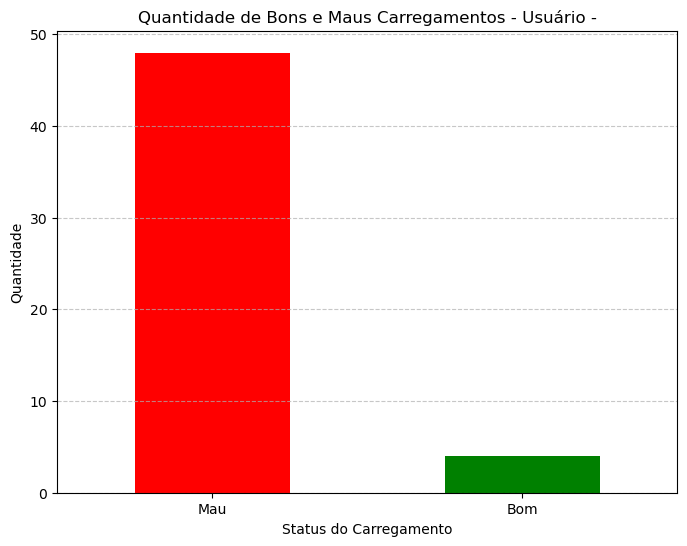

In [14]:
import pandas as pd
import matplotlib.pyplot as plt

# Carregar os dados do usuário
user_df = pd.read_excel('EVIO_history_01-03-2024_01-06-2024.xlsx')

# Carregar os dados de incentivos
incentivos_df = pd.read_csv('output_data_2024-03-01_to_2024-06-30.csv', sep=';')

# Separar a coluna de incentivos em várias colunas
incentivos_df.columns = ['datetime', 'request', 'value', 'unit', 'quality', 'updated_at', 'Hour']
incentivos_df['datetime'] = pd.to_datetime(incentivos_df['datetime'], format='%Y-%m-%d %H:%M:%S')

# Remover fuso horário das datas de incentivos_df (ou ajustar fuso horário conforme necessário)
incentivos_df['datetime'] = incentivos_df['datetime'].dt.tz_localize(None)

# Preparação dos dados de User
user_df['Start date'] = pd.to_datetime(user_df['Start date'], format='%m/%d/%Y | %H:%M')
user_df['Stop date'] = pd.to_datetime(user_df['Stop date'], format='%m/%d/%Y | %H:%M')

# Remover fuso horário das datas de user_df (ou ajustar fuso horário conforme necessário)
user_df['Start date'] = user_df['Start date'].dt.tz_localize(None)
user_df['Stop date'] = user_df['Stop date'].dt.tz_localize(None)

# Substituir vírgulas por pontos e converter para float se necessário
incentivos_df['value'] = incentivos_df['value'].astype(str).str.replace(',', '.').astype(float)

# Agrupar dados de user_df por 'Nº cartão EVIO'
users_grouped = user_df.groupby('Nº cartão EVIO')

# Função para verificar se uma datetime está dentro de algum intervalo
def check_if_in_intervals(dt, intervals):
    for start, stop in intervals:
        if start <= dt <= stop:
            return 1
    return 0

# Iterar por cada usuário
for user_id, group in users_grouped:
    # Criar uma lista de intervalos de tempo de carregamento para o usuário atual
    intervals = [(start, stop) for start, stop in zip(group['Start date'], group['Stop date'])]
    
    # Aplicar a função em todas as datetimes do incentivos_df
    incentivos_df['Carregamento'] = incentivos_df['datetime'].apply(lambda x: check_if_in_intervals(x, intervals))
    # Filtrar os dados para a data específica de 2024-03-01
    #incentivos_dia = incentivos_df[incentivos_df['datetime'].dt.date == pd.to_datetime('2024-03-01').date()]

    # Exibir os dados desse dia
    print(incentivos_dia)
    
    # Selecionar apenas as colunas datetime e Carregamento
    resultado_df = incentivos_df[['datetime', 'Carregamento']]
    
    # Filtrar as linhas onde 'Carregamento' é igual a 1
    carregamentos = resultado_df[resultado_df['Carregamento'] == 1]
    
    # Realizar o merge dos DataFrames
    merged_df = pd.merge(carregamentos, incentivos_df[['datetime', 'value']], on='datetime', how='inner')
    
    # Calcular o quantil (50%) do máximo para cada dia
    incentivos_df['date'] = incentivos_df['datetime'].dt.date
    quantil_diario = incentivos_df.groupby('date')['value'].quantile(0.5).reset_index()
    quantil_diario.columns = ['date', 'daily_quantile']
    print(quantil_diario)
    
    
    # Adicionar a coluna 'date' ao merged_df
    merged_df['date'] = merged_df['datetime'].dt.date
    
    # Mesclar os dados do quantil diário com os dados mesclados
    merged_df = pd.merge(merged_df, quantil_diario, on='date', how='left')
    
    # Verificar se os valores estão acima ou abaixo do quantil diário
    merged_df['Status'] = merged_df['value'].apply(lambda x: 'Bom' if x < merged_df['daily_quantile'].values[0] else 'Mau')
    
    # Contar bons e maus carregamentos
    status_counts = merged_df['Status'].value_counts()
    
    if not status_counts.empty:
        # Definir cores para o gráfico
        colors = ['green' if status == 'Bom' else 'red' for status in status_counts.index]
        
        # Plotar o gráfico de barras
        plt.figure(figsize=(8, 6))
        status_counts.plot(kind='bar', color=colors)
        plt.title(f'Quantidade de Bons e Maus Carregamentos - Usuário {user_id}')
        plt.xlabel('Status do Carregamento')
        plt.ylabel('Quantidade')
        plt.xticks(rotation=0)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        
        # Mostrar o gráfico
        plt.show()
    else:
        print(f'Nenhum dado para plotar para o usuário {user_id}')


C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

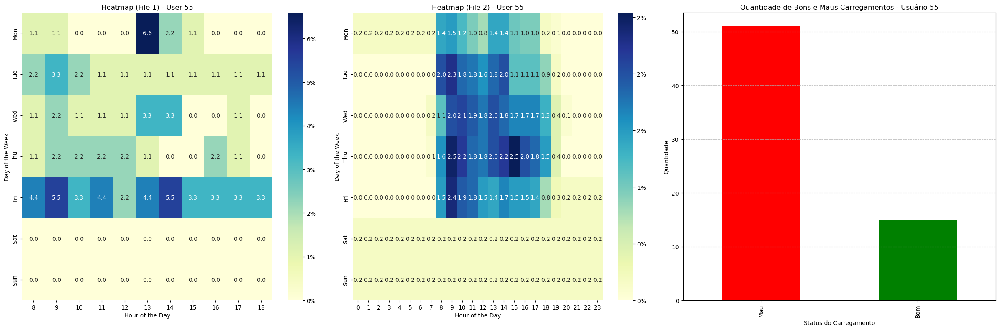

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

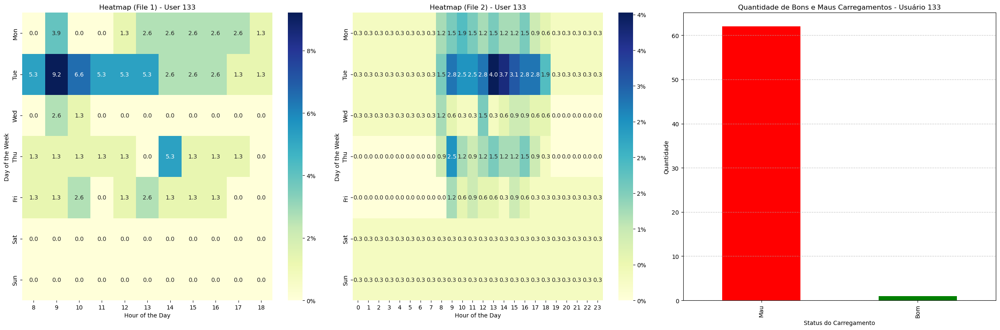

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

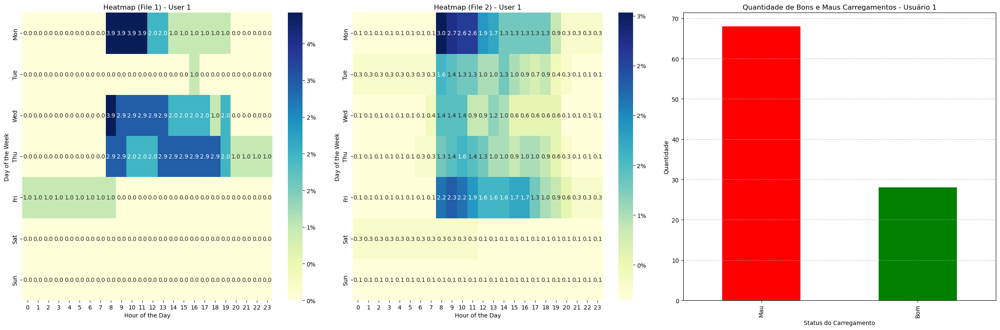

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

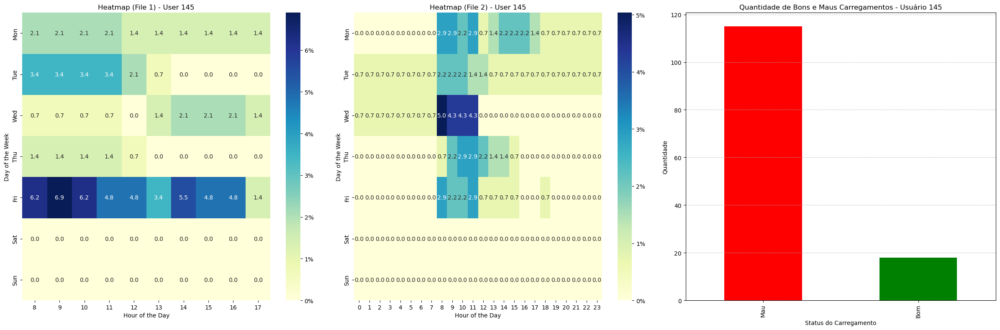

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

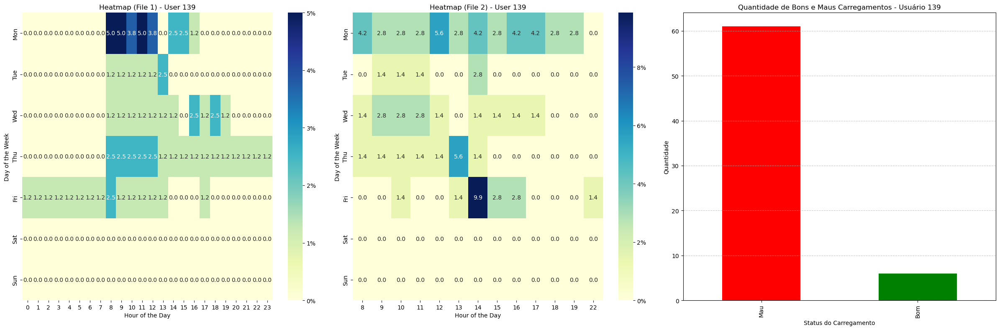

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

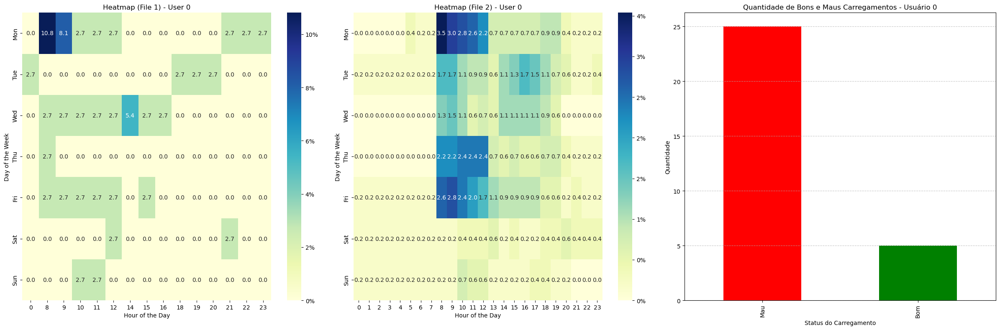

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

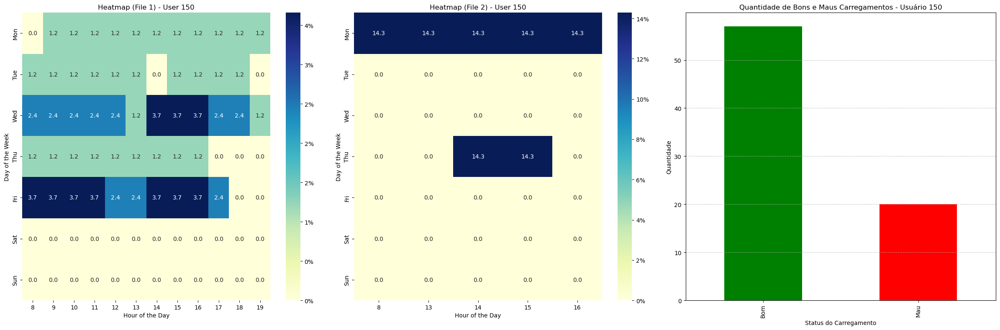

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

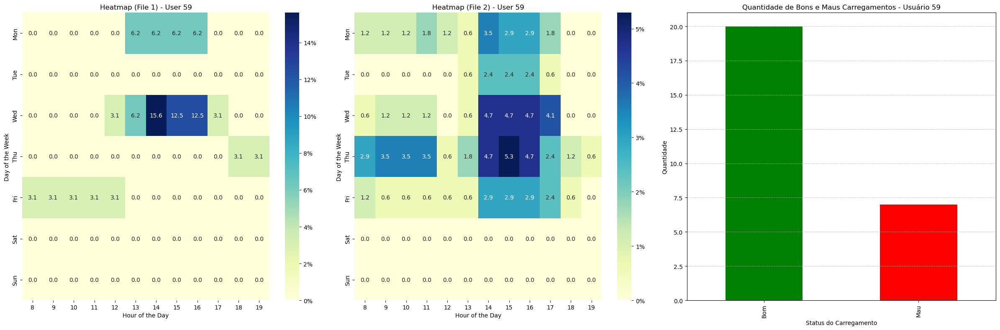

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

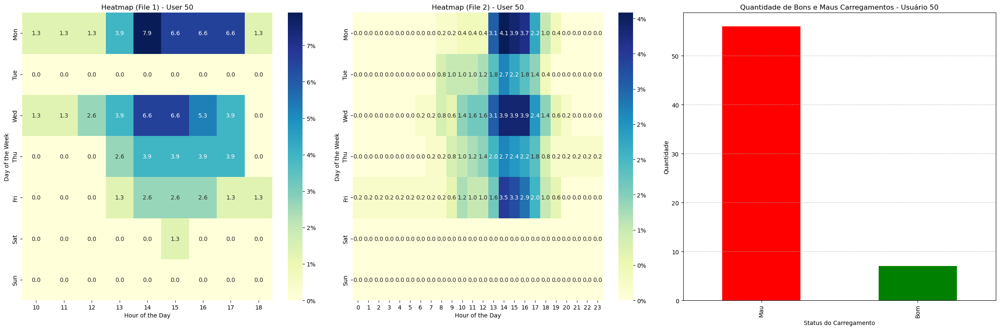

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

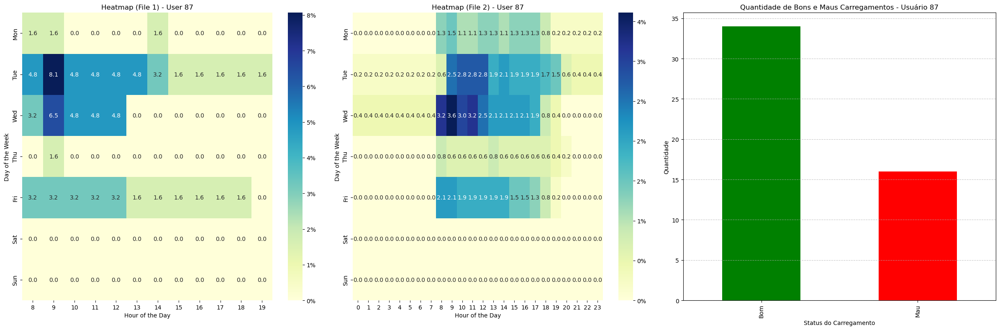

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

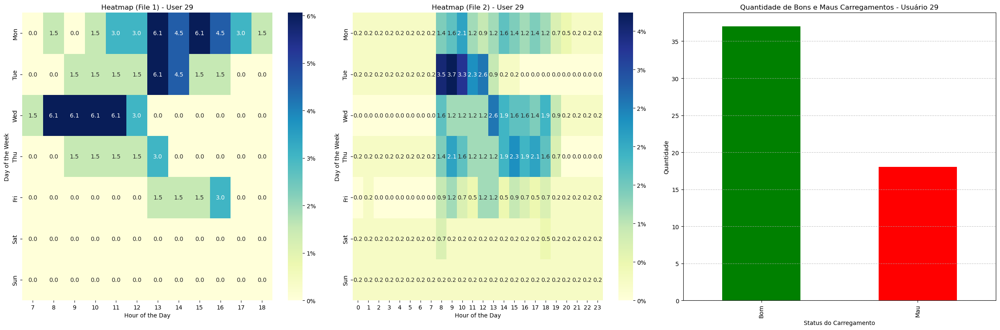

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

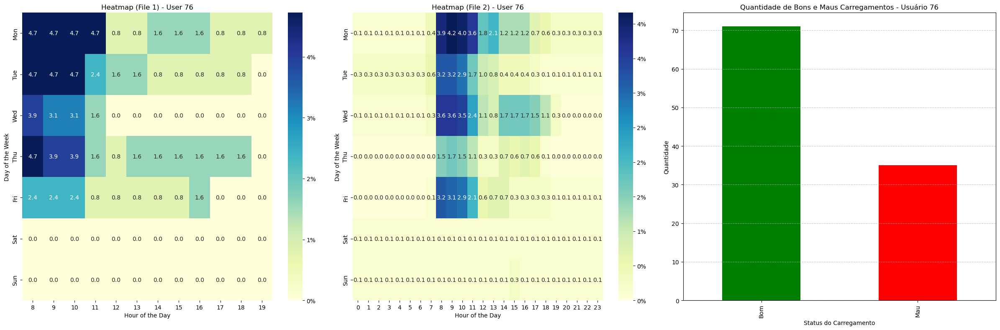

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

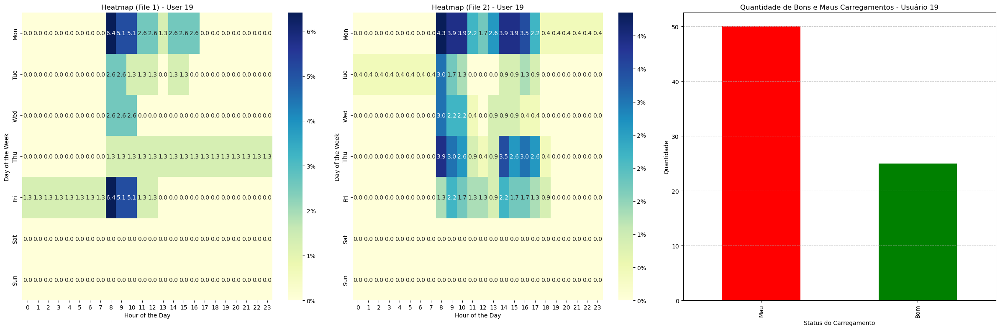

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

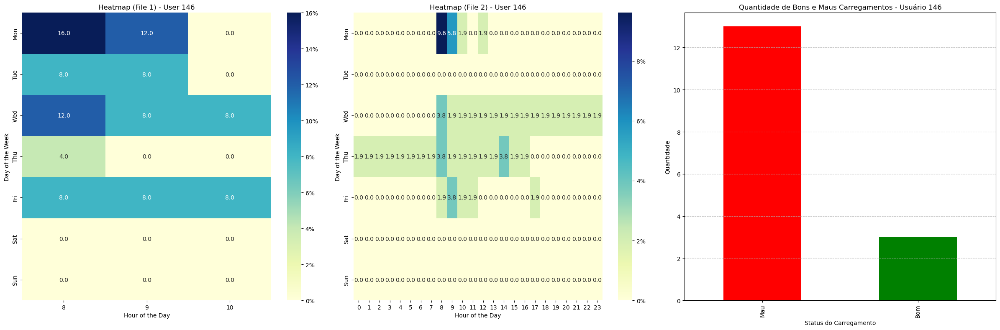

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

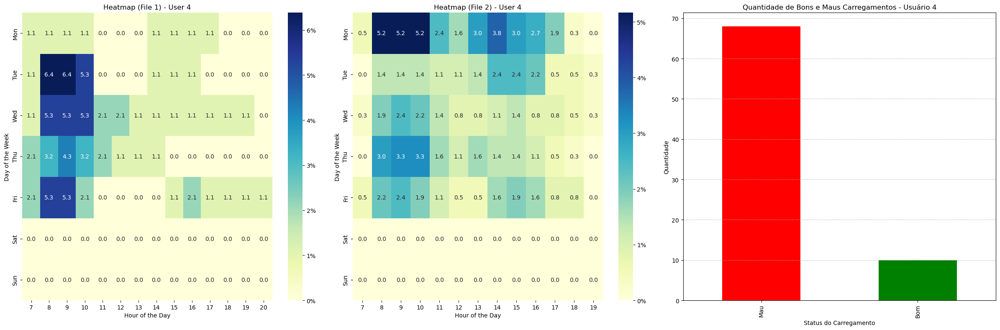

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

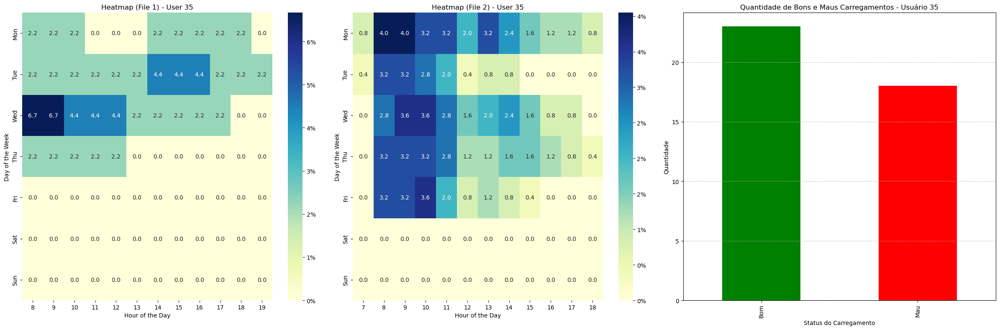

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

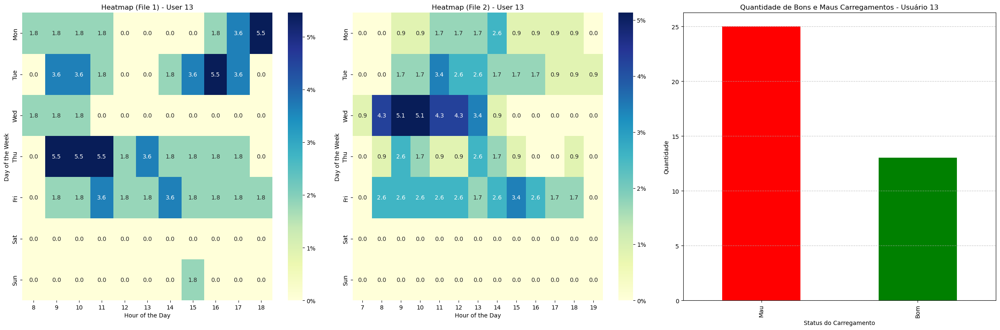

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

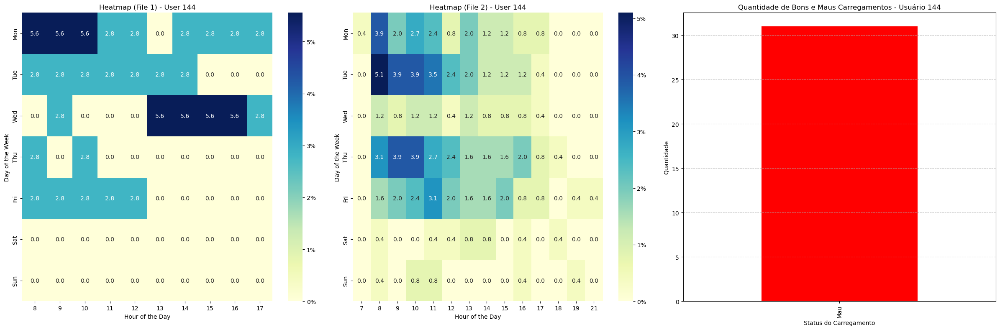

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

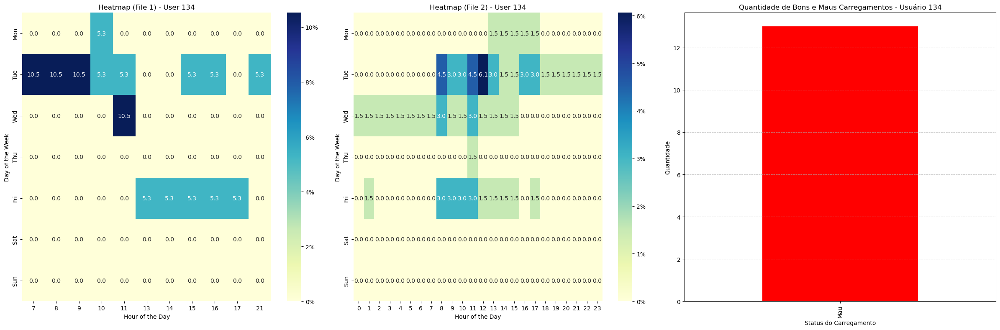

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

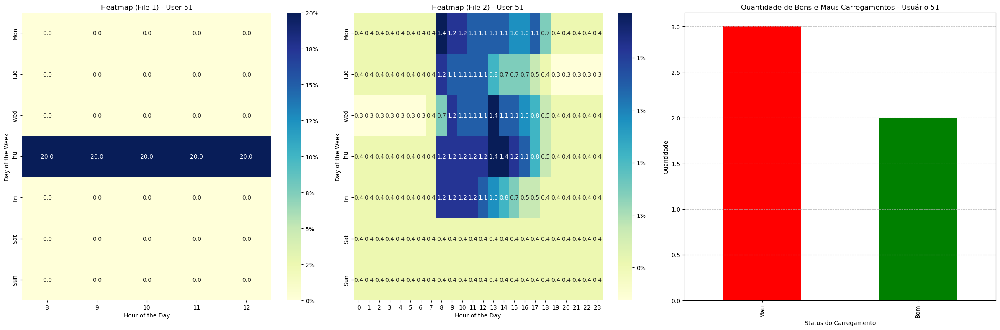

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

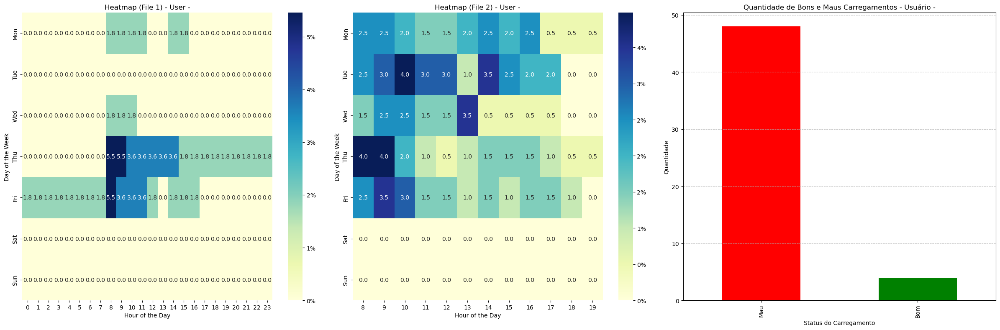

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

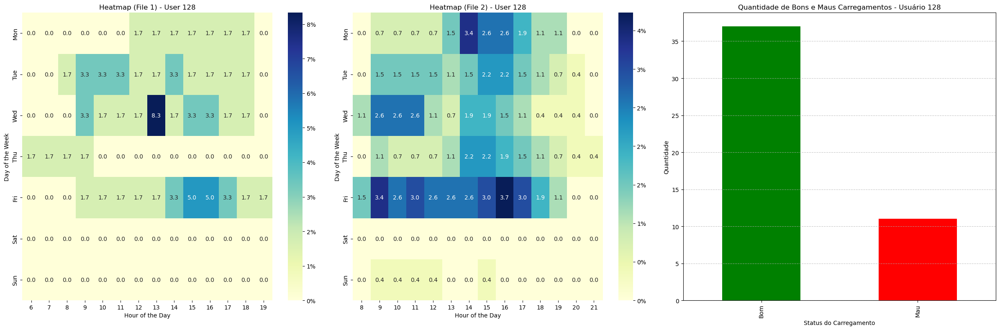

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

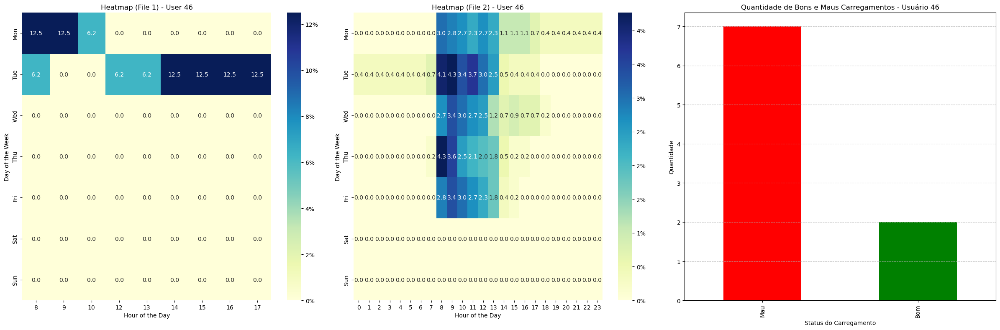

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

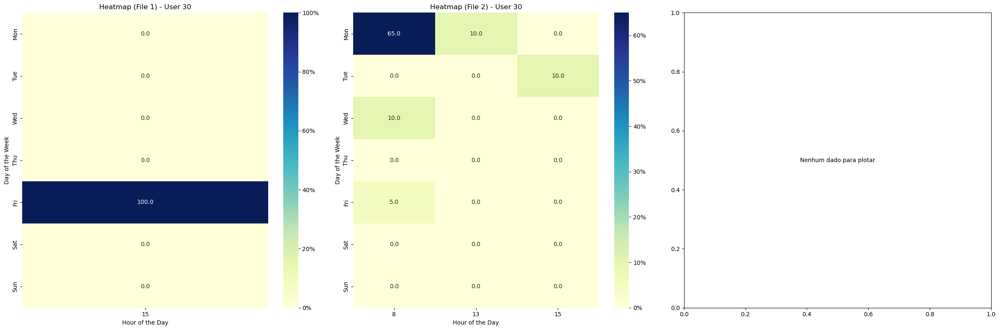

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\496133771.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


TypeError: explode() missing 1 required positional argument: 'column'

In [20]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Função para carregar e preparar os dados
def prepare_data(user_file, incentives_file):
    user_df = pd.read_excel(user_file)
    incentivos_df = pd.read_csv(incentives_file, sep=';')
    
    incentivos_df.columns = ['datetime', 'request', 'value', 'unit', 'quality', 'updated_at', 'Hour']
    incentivos_df['datetime'] = pd.to_datetime(incentivos_df['datetime'], format='%Y-%m-%d %H:%M:%S')
    incentivos_df['datetime'] = incentivos_df['datetime'].dt.tz_localize(None)
    
    user_df['Start date'] = pd.to_datetime(user_df['Start date'], format='%m/%d/%Y | %H:%M')
    user_df['Stop date'] = pd.to_datetime(user_df['Stop date'], format='%m/%d/%Y | %H:%M')
    user_df['Start date'] = user_df['Start date'].dt.tz_localize(None)
    user_df['Stop date'] = user_df['Stop date'].dt.tz_localize(None)
    
    incentivos_df['value'] = incentivos_df['value'].astype(str).str.replace(',', '.').astype(float)
    
    return user_df, incentivos_df

# Função para criar heatmap de dados de carregamento
def create_heatmap_data(data, user):
    user_data = data[data['Nº cartão EVIO'] == user]
    user_data['Start hour'] = user_data['Start date'].dt.hour
    user_data['Weekday'] = user_data['Start date'].dt.dayofweek

    def expand_hours(row):
        start = row['Start date']
        stop = row['Stop date']
        hours = pd.date_range(start, stop, freq='H').tolist()
        return [(row['Nº cartão EVIO'], h.dayofweek, h.hour) for h in hours]

    expanded_data = user_data.apply(expand_hours, axis=1).explode().tolist()
    expanded_df = pd.DataFrame(expanded_data, columns=['Nº cartão EVIO', 'Weekday', 'Hour'])
    
    heatmap_data = expanded_df.groupby(['Weekday', 'Hour']).size().unstack(fill_value=0)
    all_weekdays = pd.Index(range(7), name='Weekday')
    heatmap_data = heatmap_data.reindex(all_weekdays, fill_value=0)
    total_hours = heatmap_data.values.sum()
    heatmap_data_percent = (heatmap_data / total_hours) * 100
    heatmap_data_percent.index = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']

    return heatmap_data_percent

# Função para verificar se uma datetime está dentro de algum intervalo
def check_if_in_intervals(dt, intervals):
    for start, stop in intervals:
        if start <= dt <= stop:
            return 1
    return 0

# Função para plotar gráficos lado a lado
def plot_combined(data1, data2, incentives_df, user):
    heatmap_data1 = create_heatmap_data(data1, user)
    heatmap_data2 = create_heatmap_data(data2, user)

    # Criar a lista de intervalos de tempo de carregamento para o usuário
    user_data = data1[data1['Nº cartão EVIO'] == user]
    intervals = [(start, stop) for start, stop in zip(user_data['Start date'], user_data['Stop date'])]
    incentives_df['Carregamento'] = incentives_df['datetime'].apply(lambda x: check_if_in_intervals(x, intervals))
    resultado_df = incentives_df[['datetime', 'Carregamento']]
    carregamentos = resultado_df[resultado_df['Carregamento'] == 1]
    merged_df = pd.merge(carregamentos, incentives_df[['datetime', 'value']], on='datetime', how='inner')
    incentives_df['date'] = incentives_df['datetime'].dt.date
    quantil_diario = incentives_df.groupby('date')['value'].quantile(0.5).reset_index()
    quantil_diario.columns = ['date', 'daily_quantile']
    merged_df['date'] = merged_df['datetime'].dt.date
    merged_df = pd.merge(merged_df, quantil_diario, on='date', how='left')
    merged_df['Status'] = merged_df['value'].apply(lambda x: 'Bom' if x < merged_df['daily_quantile'].values[0] else 'Mau')
    status_counts = merged_df['Status'].value_counts()
    
    fig, axes = plt.subplots(1, 3, figsize=(24, 8), sharey=False)
    
    sns.heatmap(heatmap_data1, cmap="YlGnBu", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'}, ax=axes[0])
    axes[0].set_title(f"Heatmap (File 1) - User {user}")
    axes[0].set_xlabel("Hour of the Day")
    axes[0].set_ylabel("Day of the Week")
    
    sns.heatmap(heatmap_data2, cmap="YlGnBu", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'}, ax=axes[1])
    axes[1].set_title(f"Heatmap (File 2) - User {user}")
    axes[1].set_xlabel("Hour of the Day")
    axes[1].set_ylabel("Day of the Week")
    
    if not status_counts.empty:
        colors = ['green' if status == 'Bom' else 'red' for status in status_counts.index]
        status_counts.plot(kind='bar', color=colors, ax=axes[2])
        axes[2].set_title(f'Quantidade de Bons e Maus Carregamentos - Usuário {user}')
        axes[2].set_xlabel('Status do Carregamento')
        axes[2].set_ylabel('Quantidade')
        axes[2].grid(axis='y', linestyle='--', alpha=0.7)
    else:
        axes[2].text(0.5, 0.5, 'Nenhum dado para plotar', horizontalalignment='center', verticalalignment='center', transform=axes[2].transAxes)

    plt.tight_layout()
    plt.show()

# Preparar os dados
user_df1, incentivos_df1 = prepare_data('EVIO_history_01-03-2024_01-06-2024.xlsx', 'output_data_2024-03-01_to_2024-06-30.csv')
user_df2, incentivos_df2 = prepare_data('EVIO_history_01-02-2023_29-02-2024.xlsx', 'output_data_2024-03-01_to_2024-06-30.csv')

# Iterar por cada usuário e plotar os gráficos
usuarios = pd.concat([user_df1['Nº cartão EVIO'], user_df2['Nº cartão EVIO']]).unique()

for usuario in usuarios:
    plot_combined(user_df1, user_df2, incentivos_df1, usuario)


C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

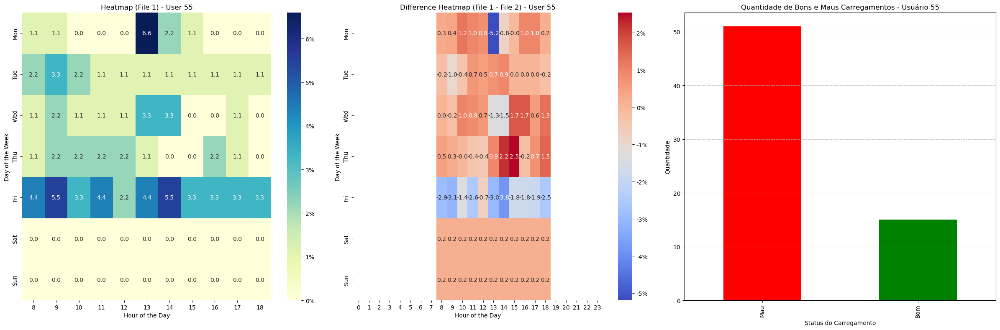

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

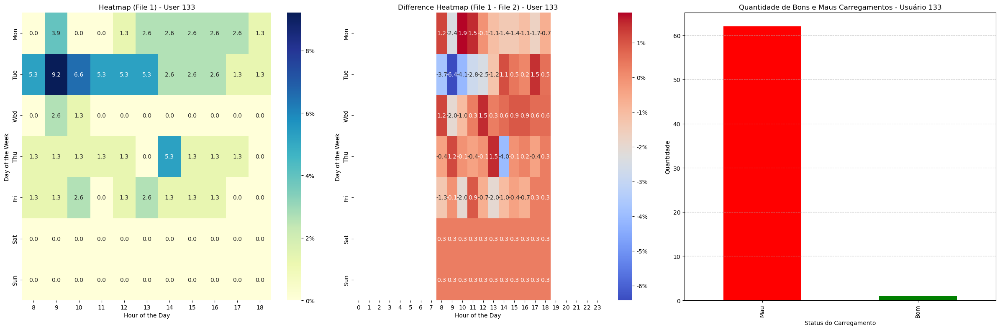

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

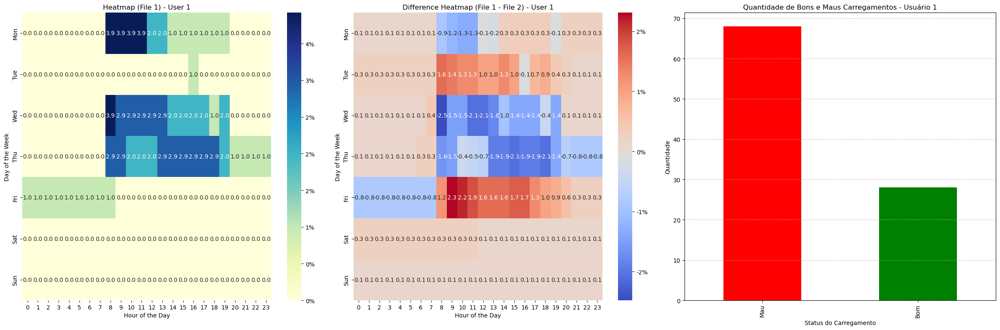

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

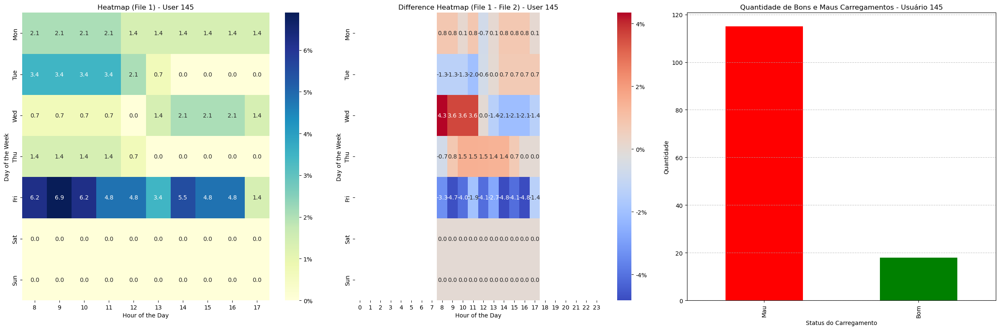

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

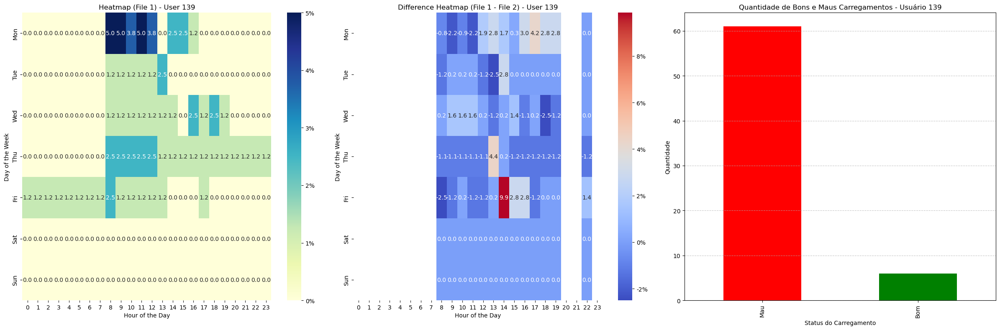

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

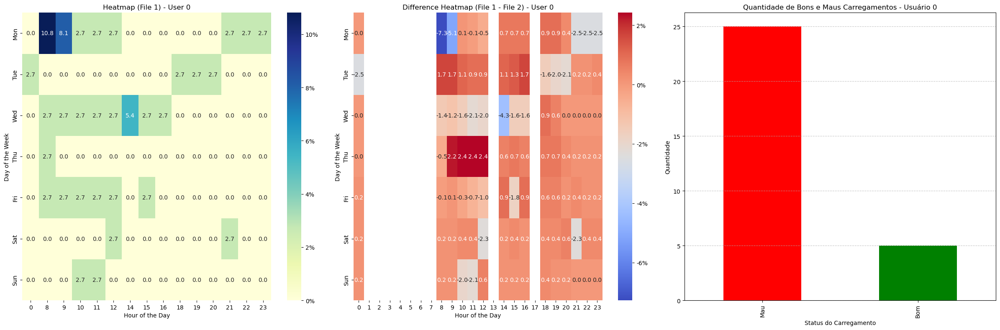

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

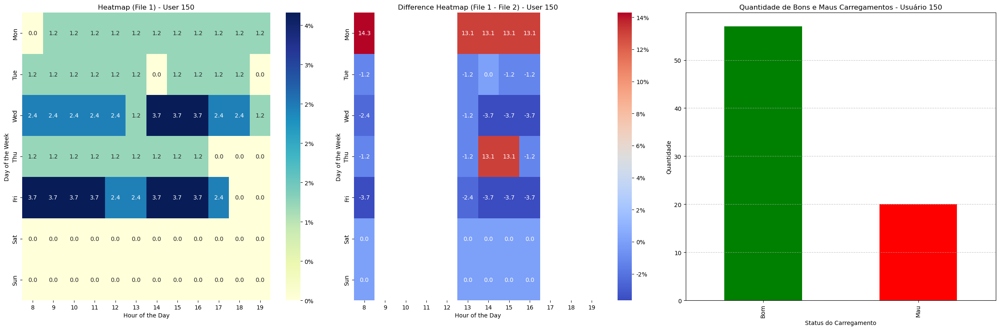

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

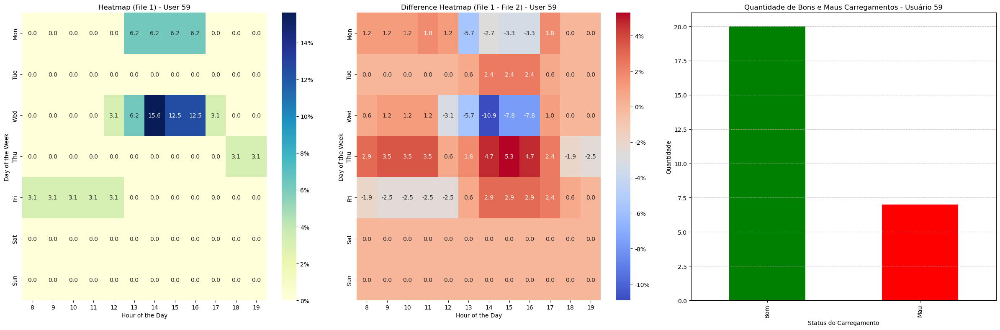

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

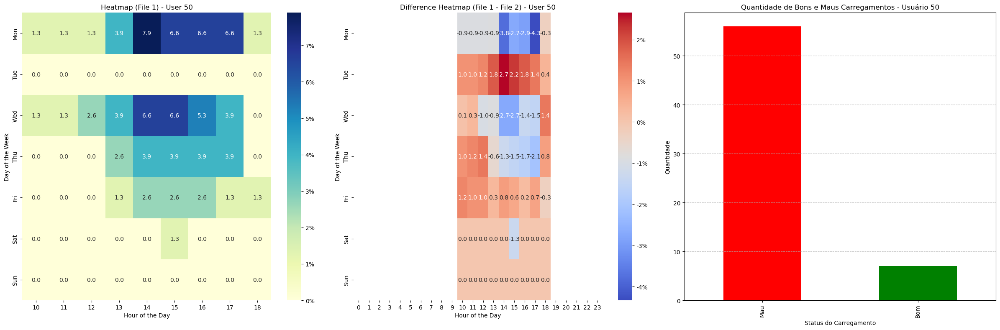

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

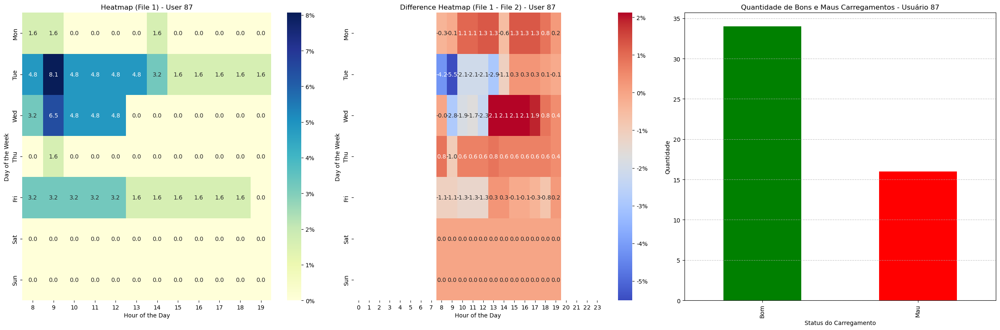

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

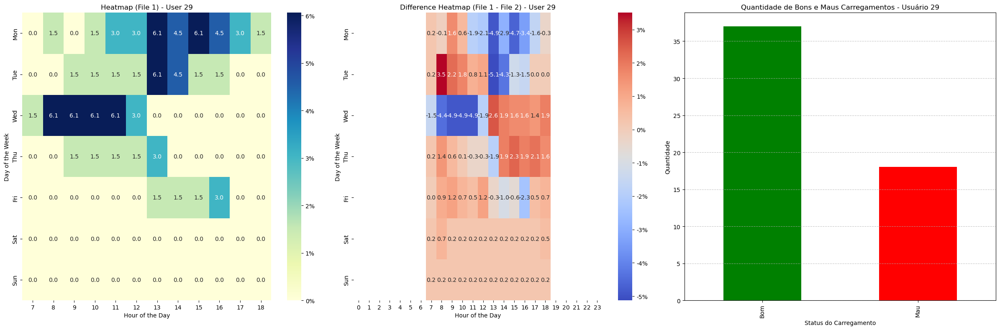

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

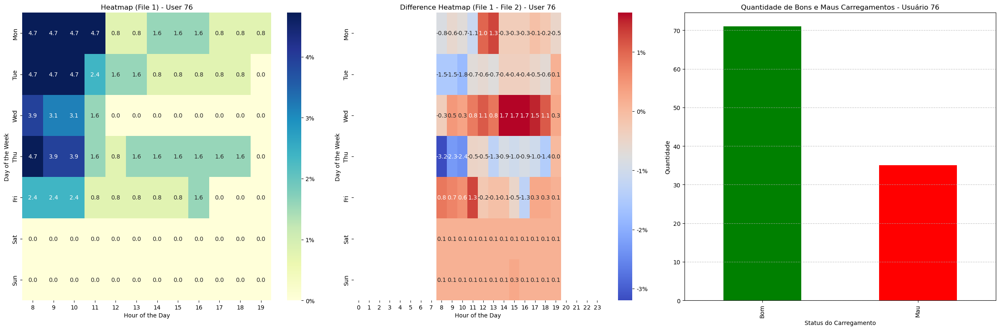

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

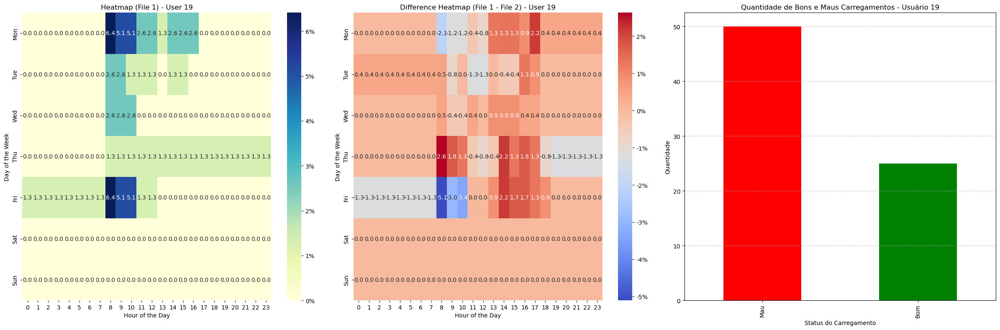

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

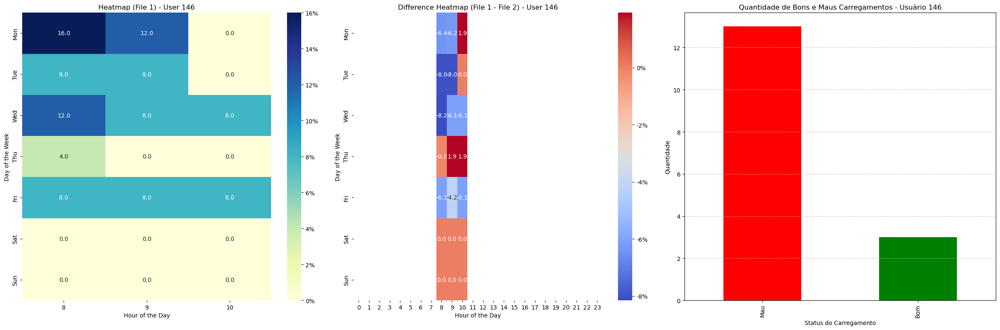

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

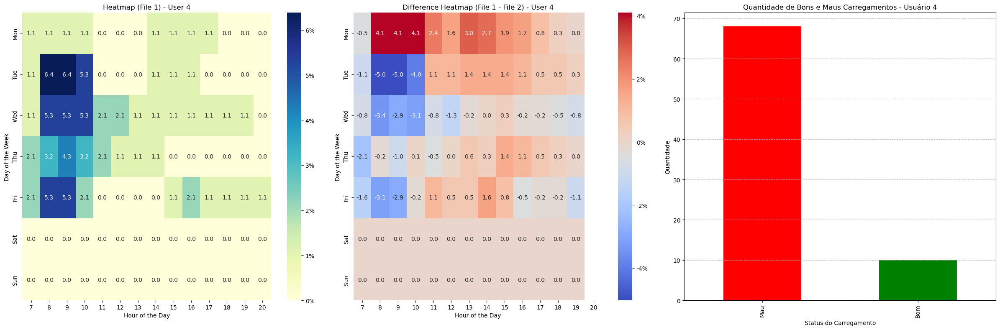

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

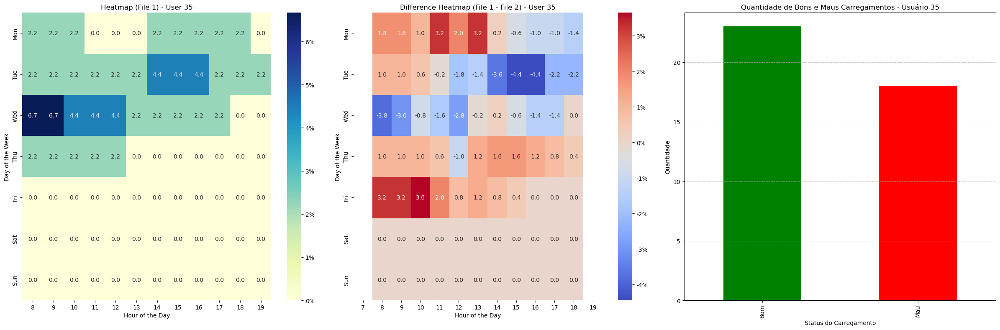

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

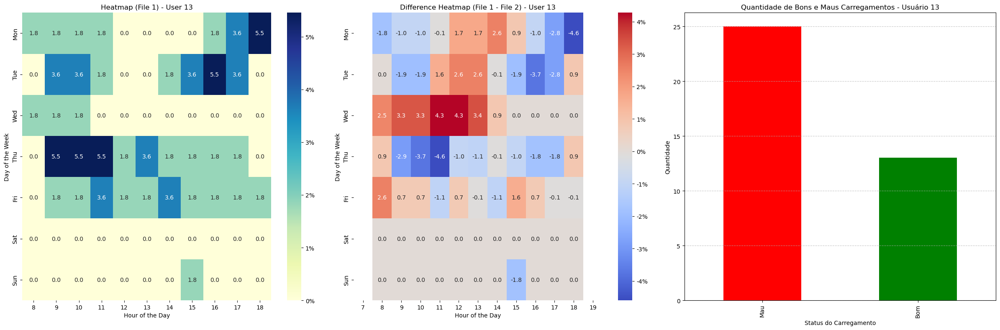

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

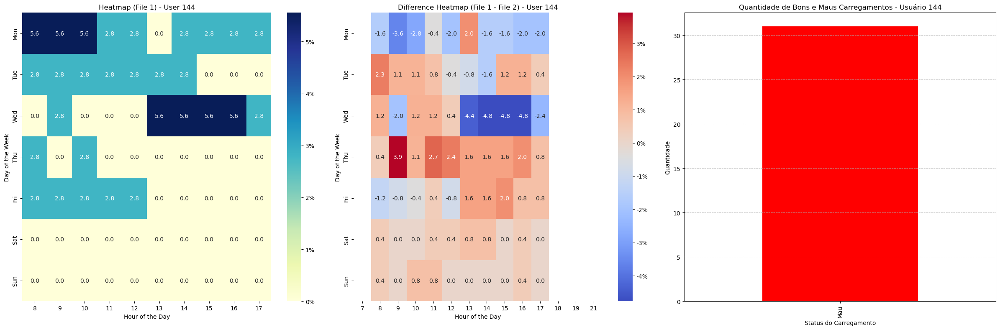

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

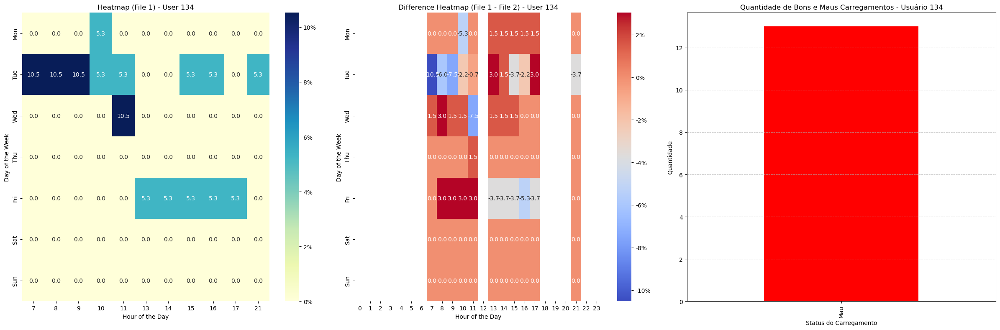

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

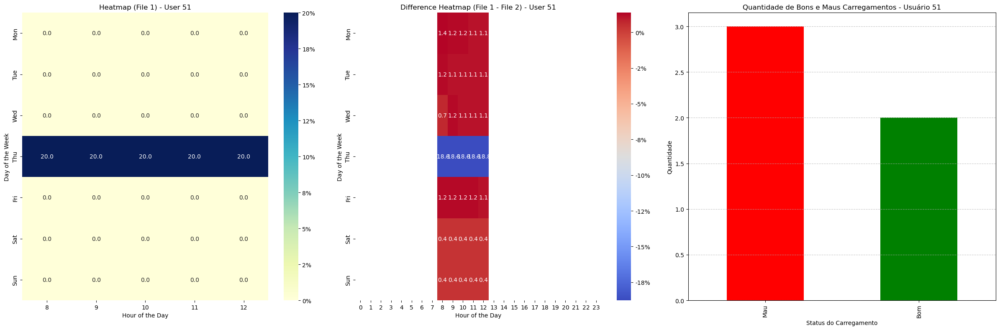

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

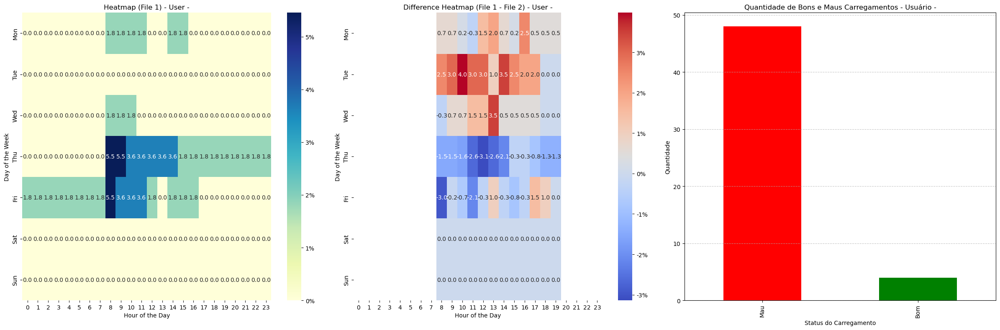

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

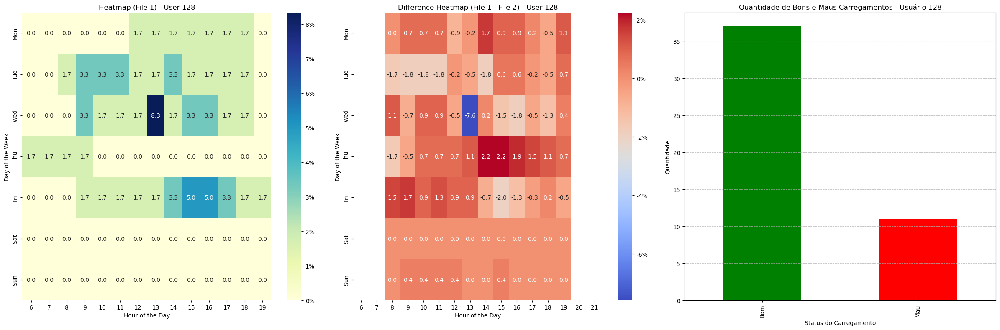

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

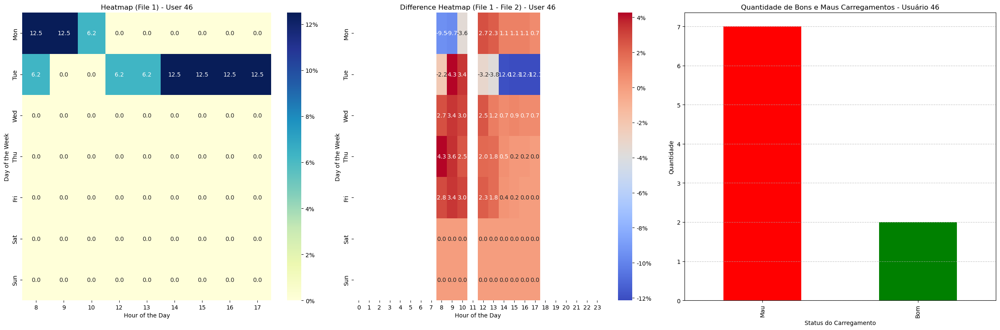

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

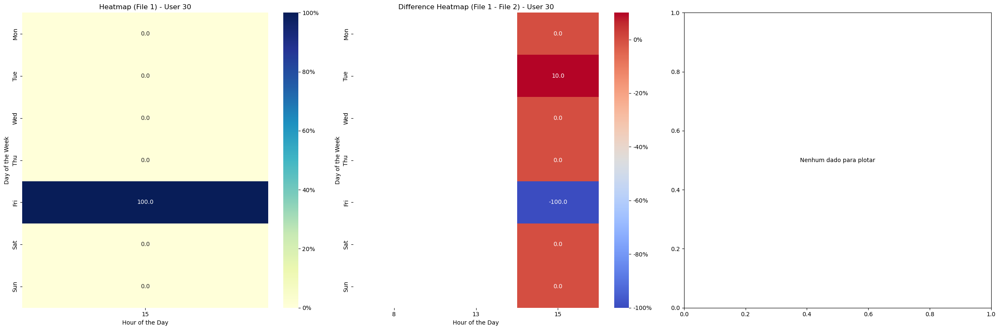

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\350587124.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


TypeError: explode() missing 1 required positional argument: 'column'

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Função para carregar e preparar os dados
def prepare_data(user_file, incentives_file):
    user_df = pd.read_excel(user_file)
    incentivos_df = pd.read_csv(incentives_file, sep=';')
    
    incentivos_df.columns = ['datetime', 'request', 'value', 'unit', 'quality', 'updated_at', 'Hour']
    incentivos_df['datetime'] = pd.to_datetime(incentivos_df['datetime'], format='%Y-%m-%d %H:%M:%S')
    incentivos_df['datetime'] = incentivos_df['datetime'].dt.tz_localize(None)
    
    user_df['Start date'] = pd.to_datetime(user_df['Start date'], format='%m/%d/%Y | %H:%M')
    user_df['Stop date'] = pd.to_datetime(user_df['Stop date'], format='%m/%d/%Y | %H:%M')
    user_df['Start date'] = user_df['Start date'].dt.tz_localize(None)
    user_df['Stop date'] = user_df['Stop date'].dt.tz_localize(None)
    
    incentivos_df['value'] = incentivos_df['value'].astype(str).str.replace(',', '.').astype(float)
    
    return user_df, incentivos_df

# Função para criar heatmap de dados de carregamento
def create_heatmap_data(data, user):
    user_data = data[data['Nº cartão EVIO'] == user]
    user_data['Start hour'] = user_data['Start date'].dt.hour
    user_data['Weekday'] = user_data['Start date'].dt.dayofweek

    def expand_hours(row):
        start = row['Start date']
        stop = row['Stop date']
        hours = pd.date_range(start, stop, freq='H').tolist()
        return [(row['Nº cartão EVIO'], h.dayofweek, h.hour) for h in hours]

    expanded_data = user_data.apply(expand_hours, axis=1).explode().tolist()
    expanded_df = pd.DataFrame(expanded_data, columns=['Nº cartão EVIO', 'Weekday', 'Hour'])
    
    heatmap_data = expanded_df.groupby(['Weekday', 'Hour']).size().unstack(fill_value=0)
    all_weekdays = pd.Index(range(7), name='Weekday')
    heatmap_data = heatmap_data.reindex(all_weekdays, fill_value=0)
    total_hours = heatmap_data.values.sum()
    heatmap_data_percent = (heatmap_data / total_hours) * 100
    heatmap_data_percent.index = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']

    return heatmap_data_percent

# Função para verificar se uma datetime está dentro de algum intervalo
def check_if_in_intervals(dt, intervals):
    for start, stop in intervals:
        if start <= dt <= stop:
            return 1
    return 0

# Função para plotar gráficos lado a lado
def plot_combined(data1, data2, incentives_df, user):
    heatmap_data1 = create_heatmap_data(data1, user)
    heatmap_data2 = create_heatmap_data(data2, user)

    # Criar a lista de intervalos de tempo de carregamento para o usuário
    user_data = data1[data1['Nº cartão EVIO'] == user]
    intervals = [(start, stop) for start, stop in zip(user_data['Start date'], user_data['Stop date'])]
    incentives_df['Carregamento'] = incentives_df['datetime'].apply(lambda x: check_if_in_intervals(x, intervals))
    resultado_df = incentives_df[['datetime', 'Carregamento']]
    carregamentos = resultado_df[resultado_df['Carregamento'] == 1]
    merged_df = pd.merge(carregamentos, incentives_df[['datetime', 'value']], on='datetime', how='inner')
    incentives_df['date'] = incentives_df['datetime'].dt.date
    quantil_diario = incentives_df.groupby('date')['value'].quantile(0.5).reset_index()
    quantil_diario.columns = ['date', 'daily_quantile']
    merged_df['date'] = merged_df['datetime'].dt.date
    merged_df = pd.merge(merged_df, quantil_diario, on='date', how='left')
    merged_df['Status'] = merged_df['value'].apply(lambda x: 'Bom' if x < merged_df['daily_quantile'].values[0] else 'Mau')
    status_counts = merged_df['Status'].value_counts()

    # Subtração dos Heatmaps
    heatmap_diff = heatmap_data2 - heatmap_data1
    
    fig, axes = plt.subplots(1, 3, figsize=(24, 8), sharey=False)
    
    sns.heatmap(heatmap_data1, cmap="YlGnBu", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'}, ax=axes[0])
    axes[0].set_title(f"Heatmap (File 1) - User {user}")
    axes[0].set_xlabel("Hour of the Day")
    axes[0].set_ylabel("Day of the Week")
    
    sns.heatmap(heatmap_diff, cmap="coolwarm", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'}, ax=axes[1])
    axes[1].set_title(f"Difference Heatmap (File 1 - File 2) - User {user}")
    axes[1].set_xlabel("Hour of the Day")
    axes[1].set_ylabel("Day of the Week")
    
    if not status_counts.empty:
        colors = ['green' if status == 'Bom' else 'red' for status in status_counts.index]
        status_counts.plot(kind='bar', color=colors, ax=axes[2])
        axes[2].set_title(f'Quantidade de Bons e Maus Carregamentos - Usuário {user}')
        axes[2].set_xlabel('Status do Carregamento')
        axes[2].set_ylabel('Quantidade')
        axes[2].grid(axis='y', linestyle='--', alpha=0.7)
    else:
        axes[2].text(0.5, 0.5, 'Nenhum dado para plotar', horizontalalignment='center', verticalalignment='center', transform=axes[2].transAxes)

    plt.tight_layout()
    plt.show()


    
# Preparar os dados
user_df1, incentivos_df1 = prepare_data('EVIO_history_01-03-2024_01-06-2024.xlsx', 'output_data_2024-03-01_to_2024-06-30.csv')
user_df2, _ = prepare_data('EVIO_history_01-02-2023_29-02-2024.xlsx', 'output_data_2024-03-01_to_2024-06-30.csv')
# Iterar por cada usuário e plotar os gráficos
usuarios = user_df1['Nº cartão EVIO'].unique()

for usuario in usuarios:
    plot_combined(user_df1, user_df2, incentivos_df1, usuario)


C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

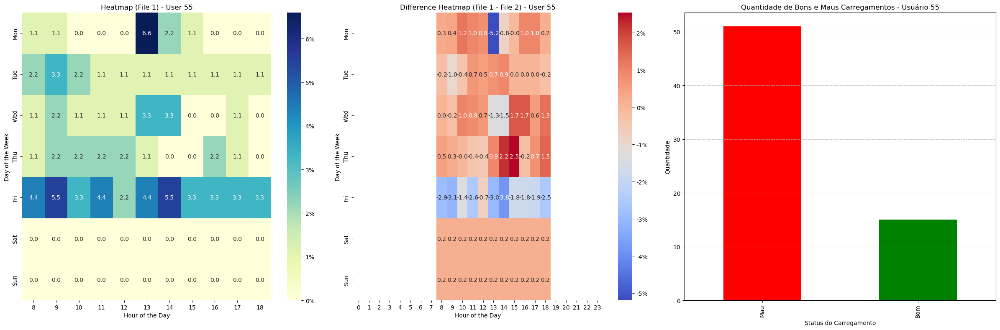

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

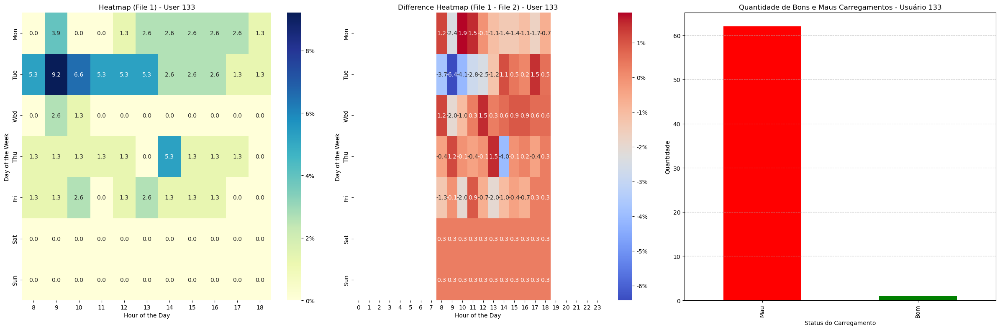

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

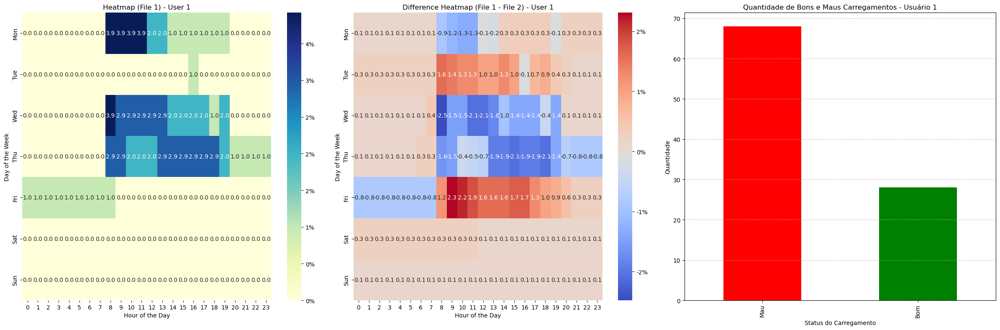

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

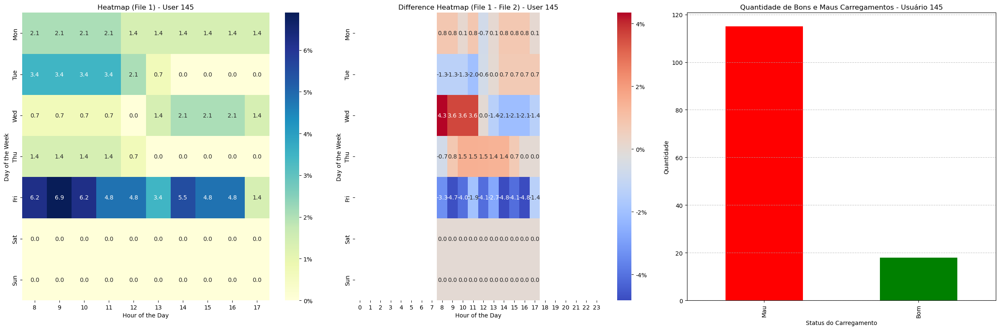

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

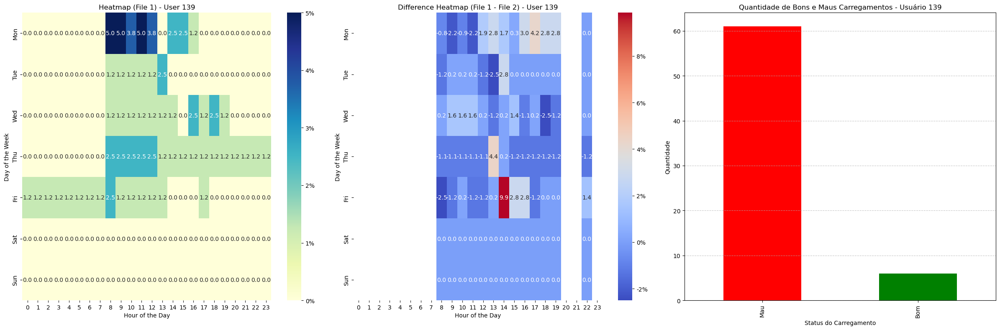

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

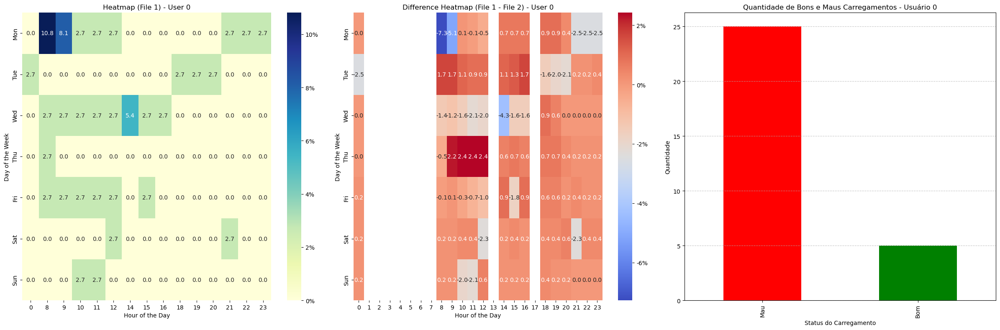

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

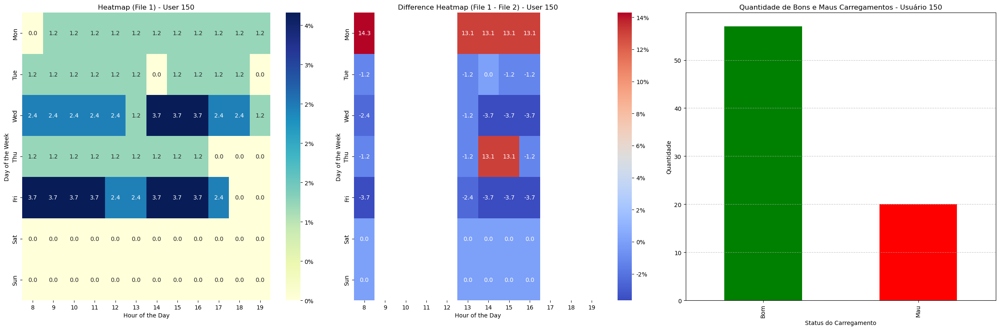

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

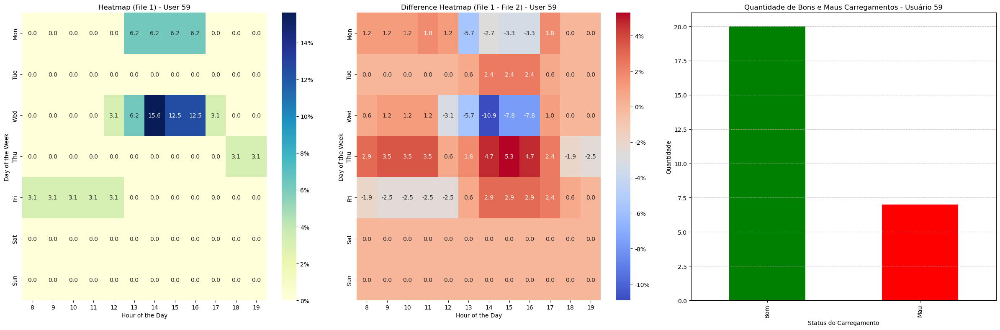

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

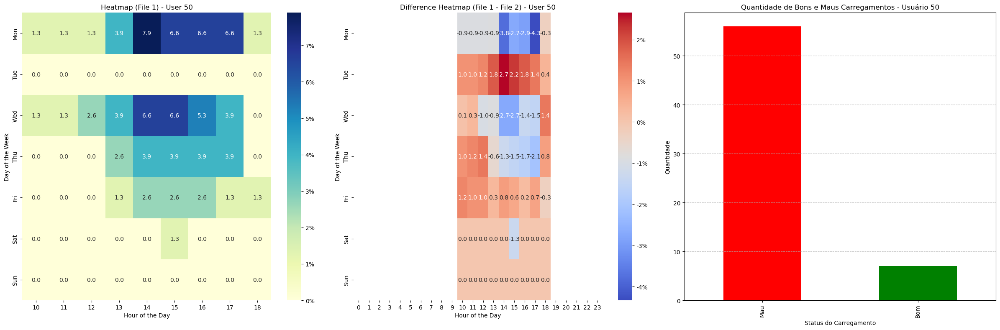

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

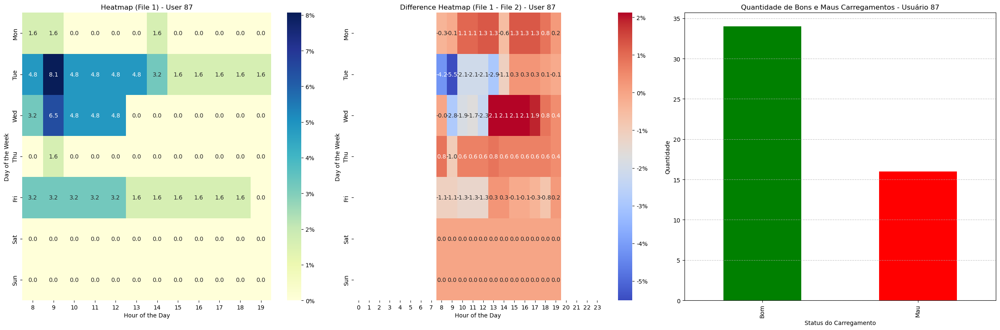

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

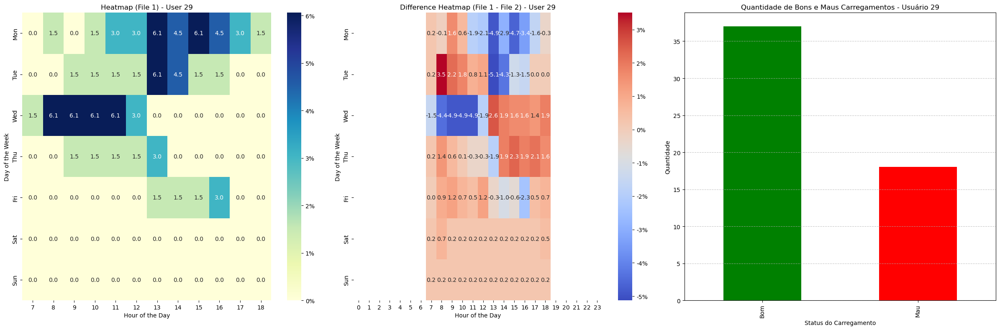

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

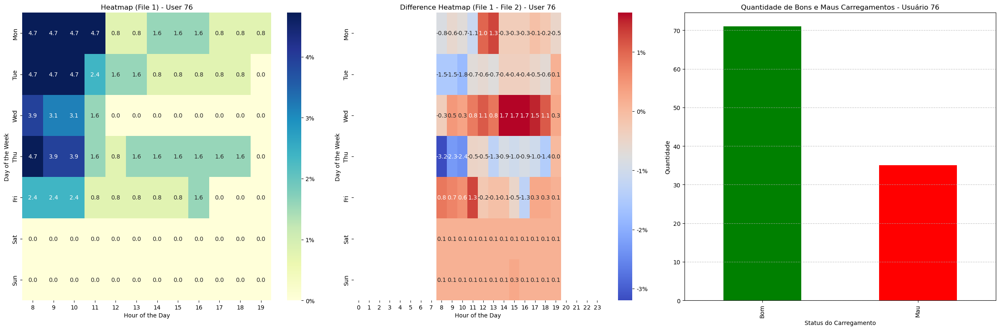

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

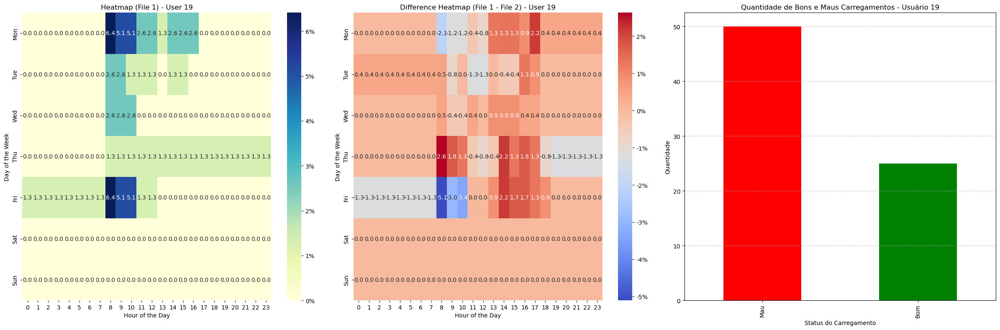

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

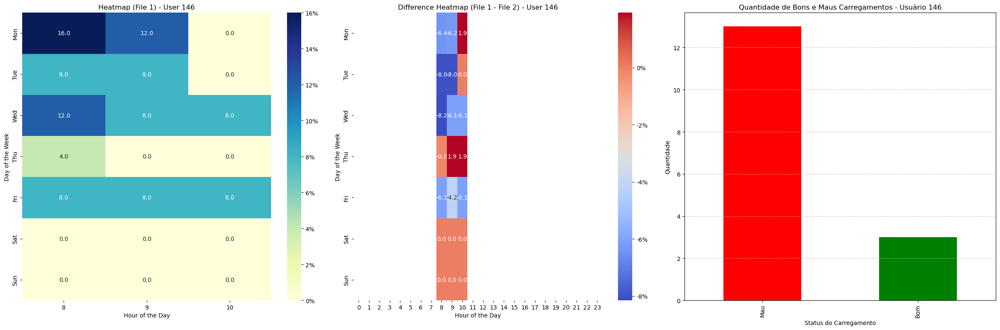

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

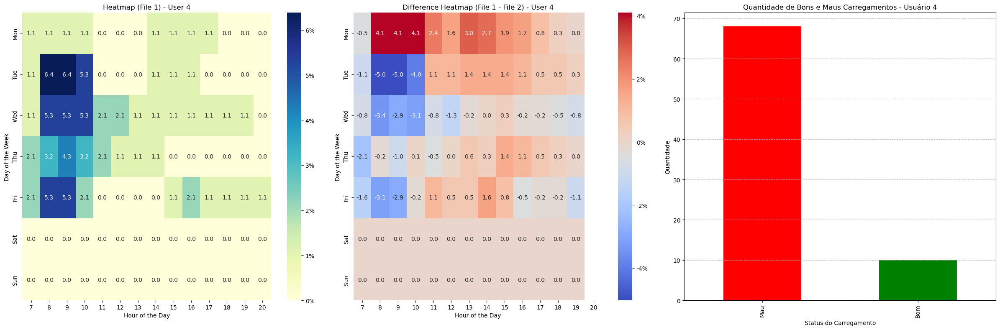

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

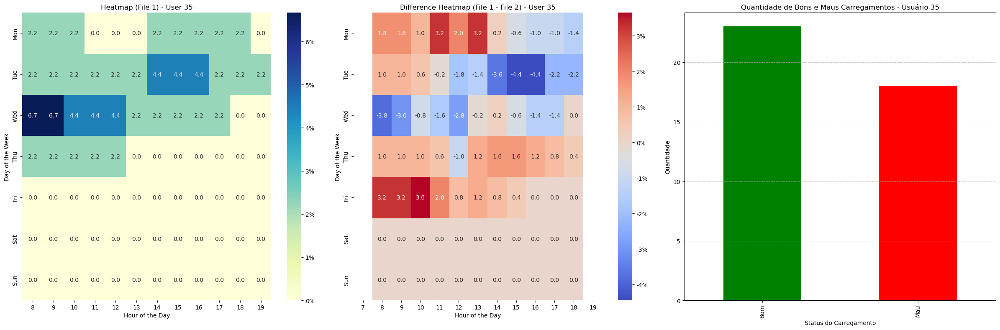

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

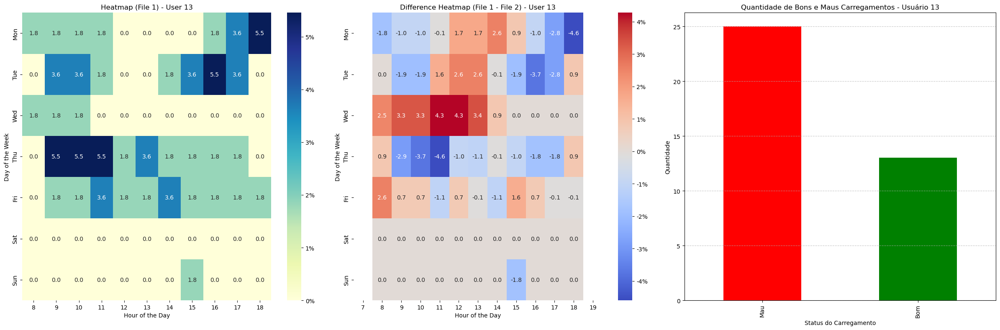

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

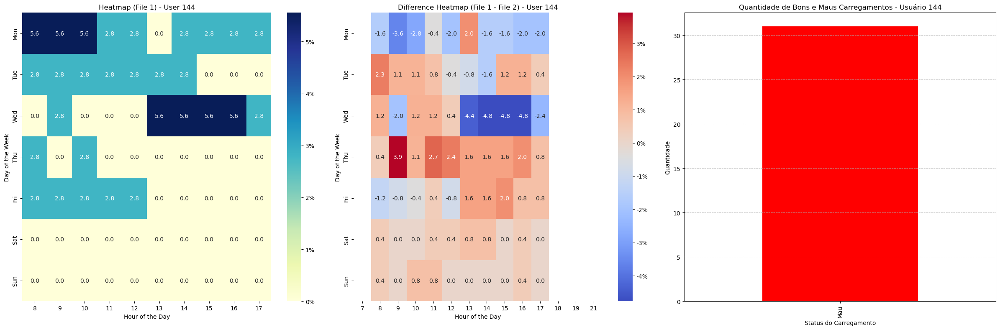

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

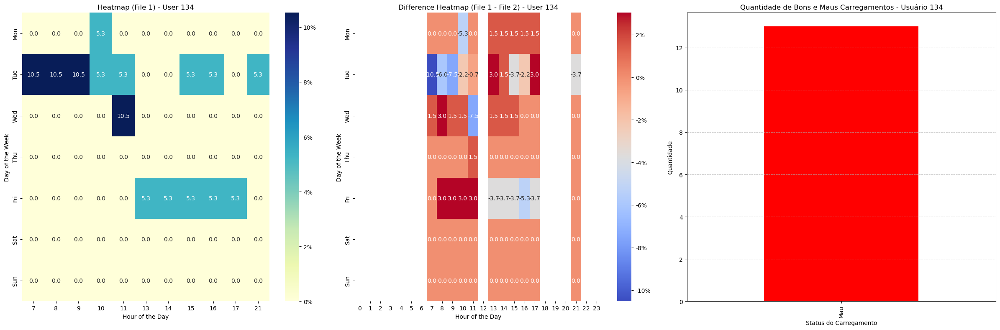

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

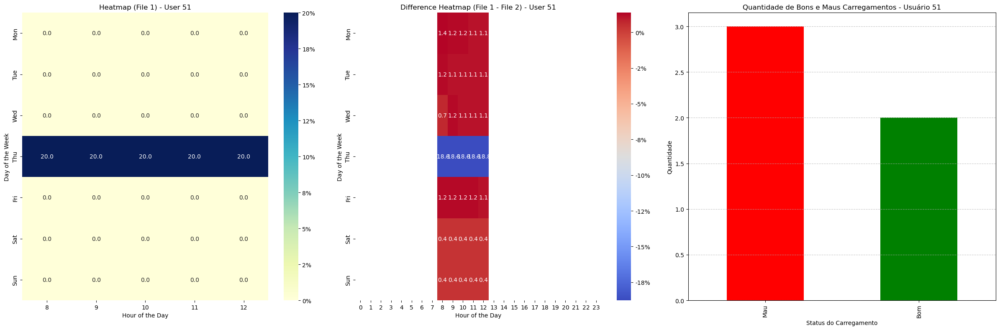

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

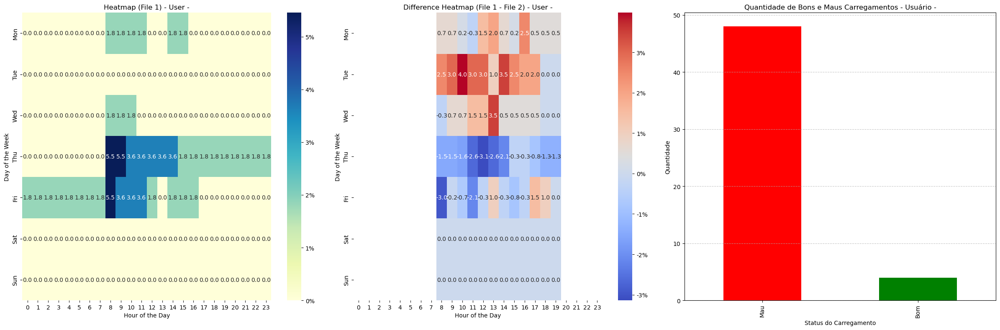

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

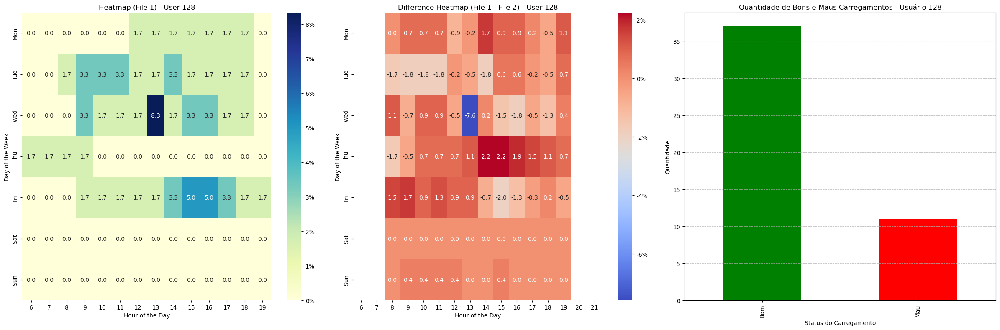

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

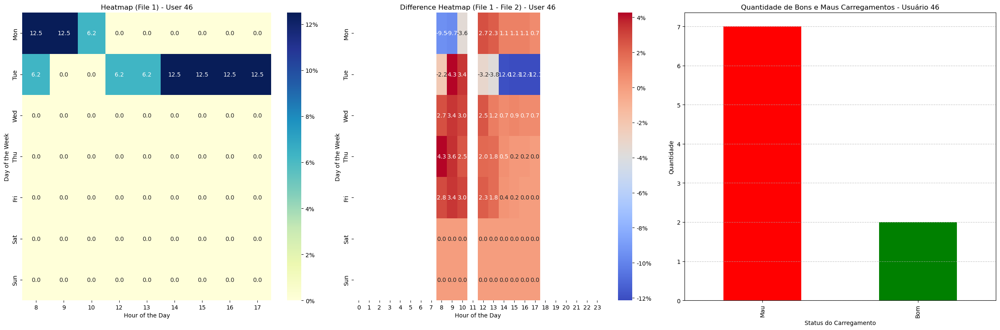

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

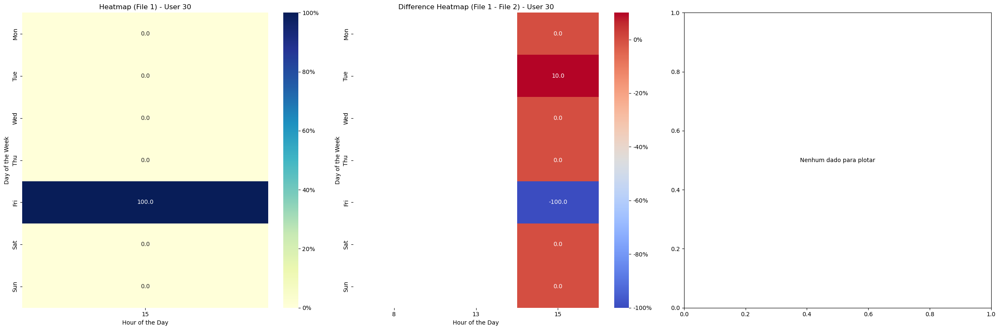

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\Anaconda3\lib\site-packages\seaborn\matrix.py:198: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
C:\Users\mi

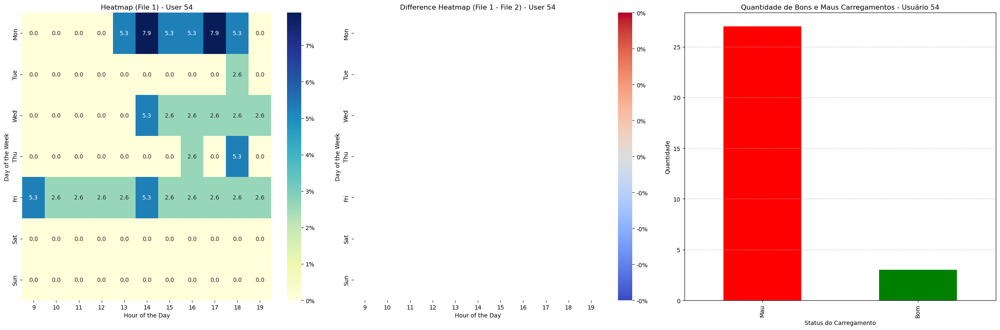

In [7]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Função para carregar e preparar os dados
def prepare_data(user_file, incentives_file):
    user_df = pd.read_excel(user_file)
    incentivos_df = pd.read_csv(incentives_file, sep=';')
    
    incentivos_df.columns = ['datetime', 'request', 'value', 'unit', 'quality', 'updated_at', 'Hour']
    incentivos_df['datetime'] = pd.to_datetime(incentivos_df['datetime'], format='%Y-%m-%d %H:%M:%S')
    incentivos_df['datetime'] = incentivos_df['datetime'].dt.tz_localize(None)
    
    user_df['Start date'] = pd.to_datetime(user_df['Start date'], format='%m/%d/%Y | %H:%M')
    user_df['Stop date'] = pd.to_datetime(user_df['Stop date'], format='%m/%d/%Y | %H:%M')
    user_df['Start date'] = user_df['Start date'].dt.tz_localize(None)
    user_df['Stop date'] = user_df['Stop date'].dt.tz_localize(None)
    
    incentivos_df['value'] = incentivos_df['value'].astype(str).str.replace(',', '.').astype(float)
    
    return user_df, incentivos_df
def create_heatmap_data(data, user):
    user_data = data[data['Nº cartão EVIO'] == user]
    user_data['Start hour'] = user_data['Start date'].dt.hour
    user_data['Weekday'] = user_data['Start date'].dt.dayofweek

    expanded_data = []

    for _, row in user_data.iterrows():
        start = row['Start date']
        stop = row['Stop date']
        hours = pd.date_range(start, stop, freq='H').tolist()
        expanded_data.extend([(row['Nº cartão EVIO'], h.dayofweek, h.hour) for h in hours])

    expanded_df = pd.DataFrame(expanded_data, columns=['Nº cartão EVIO', 'Weekday', 'Hour'])
    
    heatmap_data = expanded_df.groupby(['Weekday', 'Hour']).size().unstack(fill_value=0)
    all_weekdays = pd.Index(range(7), name='Weekday')
    heatmap_data = heatmap_data.reindex(all_weekdays, fill_value=0)
    total_hours = heatmap_data.values.sum()
    heatmap_data_percent = (heatmap_data / total_hours) * 100
    heatmap_data_percent.index = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']

    return heatmap_data_percent


# Função para verificar se uma datetime está dentro de algum intervalo
def check_if_in_intervals(dt, intervals):
    for start, stop in intervals:
        if start <= dt <= stop:
            return 1
    return 0

# Função para plotar gráficos lado a lado
def plot_combined(data1, data2, incentives_df, user):
    heatmap_data1 = create_heatmap_data(data1, user)
    heatmap_data2 = create_heatmap_data(data2, user)

    # Criar a lista de intervalos de tempo de carregamento para o usuário
    user_data = data1[data1['Nº cartão EVIO'] == user]
    intervals = [(start, stop) for start, stop in zip(user_data['Start date'], user_data['Stop date'])]
    incentives_df['Carregamento'] = incentives_df['datetime'].apply(lambda x: check_if_in_intervals(x, intervals))
    resultado_df = incentives_df[['datetime', 'Carregamento']]
    carregamentos = resultado_df[resultado_df['Carregamento'] == 1]
    merged_df = pd.merge(carregamentos, incentives_df[['datetime', 'value']], on='datetime', how='inner')
    incentives_df['date'] = incentives_df['datetime'].dt.date
    quantil_diario = incentives_df.groupby('date')['value'].quantile(0.5).reset_index()
    quantil_diario.columns = ['date', 'daily_quantile']
    merged_df['date'] = merged_df['datetime'].dt.date
    merged_df = pd.merge(merged_df, quantil_diario, on='date', how='left')
    merged_df['Status'] = merged_df['value'].apply(lambda x: 'Bom' if x < merged_df['daily_quantile'].values[0] else 'Mau')
    status_counts = merged_df['Status'].value_counts()

    # Subtração dos Heatmaps
    heatmap_diff = heatmap_data2 - heatmap_data1
    
    fig, axes = plt.subplots(1, 3, figsize=(24, 8), sharey=False)
    
    sns.heatmap(heatmap_data1, cmap="YlGnBu", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'}, ax=axes[0])
    axes[0].set_title(f"Heatmap (File 1) - User {user}")
    axes[0].set_xlabel("Hour of the Day")
    axes[0].set_ylabel("Day of the Week")
    
    sns.heatmap(heatmap_diff, cmap="coolwarm", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'}, ax=axes[1])
    axes[1].set_title(f"Difference Heatmap (File 1 - File 2) - User {user}")
    axes[1].set_xlabel("Hour of the Day")
    axes[1].set_ylabel("Day of the Week")
    
    if not status_counts.empty:
        colors = ['green' if status == 'Bom' else 'red' for status in status_counts.index]
        status_counts.plot(kind='bar', color=colors, ax=axes[2])
        axes[2].set_title(f'Quantidade de Bons e Maus Carregamentos - Usuário {user}')
        axes[2].set_xlabel('Status do Carregamento')
        axes[2].set_ylabel('Quantidade')
        axes[2].grid(axis='y', linestyle='--', alpha=0.7)
    else:
        axes[2].text(0.5, 0.5, 'Nenhum dado para plotar', horizontalalignment='center', verticalalignment='center', transform=axes[2].transAxes)

    plt.tight_layout()
    plt.show()


    
# Preparar os dados
user_df1, incentivos_df1 = prepare_data('EVIO_history_01-03-2024_01-06-2024.xlsx', 'output_data_2024-03-01_to_2024-06-30.csv')
user_df2, _ = prepare_data('EVIO_history_01-02-2023_29-02-2024.xlsx', 'output_data_2024-03-01_to_2024-06-30.csv')
# Iterar por cada usuário e plotar os gráficos
usuarios = user_df1['Nº cartão EVIO'].unique()

for usuario in usuarios:
    plot_combined(user_df1, user_df2, incentivos_df1, usuario)


In [ ]:
A ideia portanto seria est? dUM LADO A DIFFRENÇA ENTRE OS HEATMAPSS E do outro o plot com base nas emissoes fornecidas, sendo que por exemplo aqui temos 2 casos, um em que segue e outro que não segue 

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

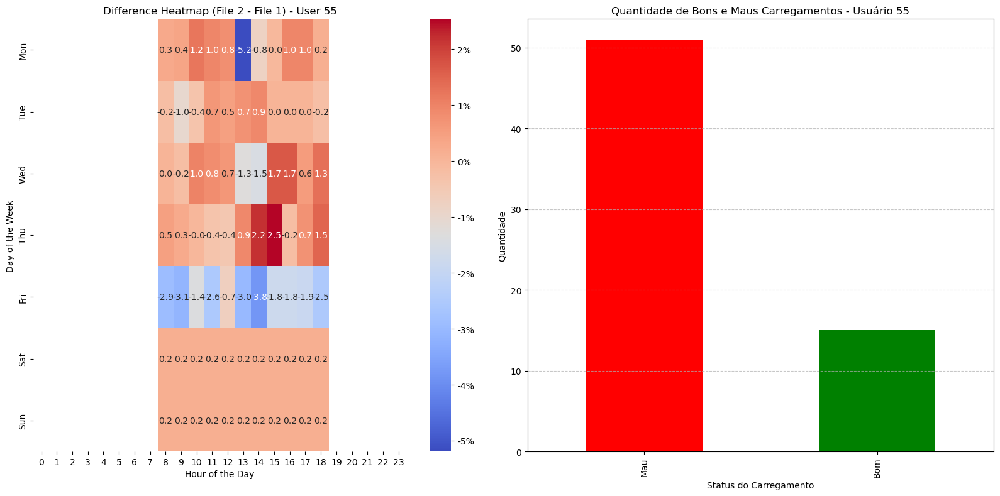

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

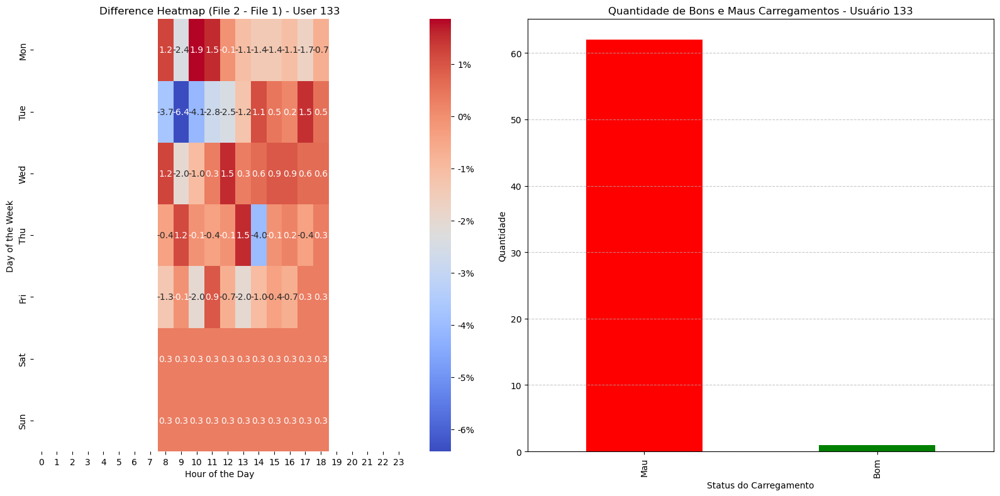

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

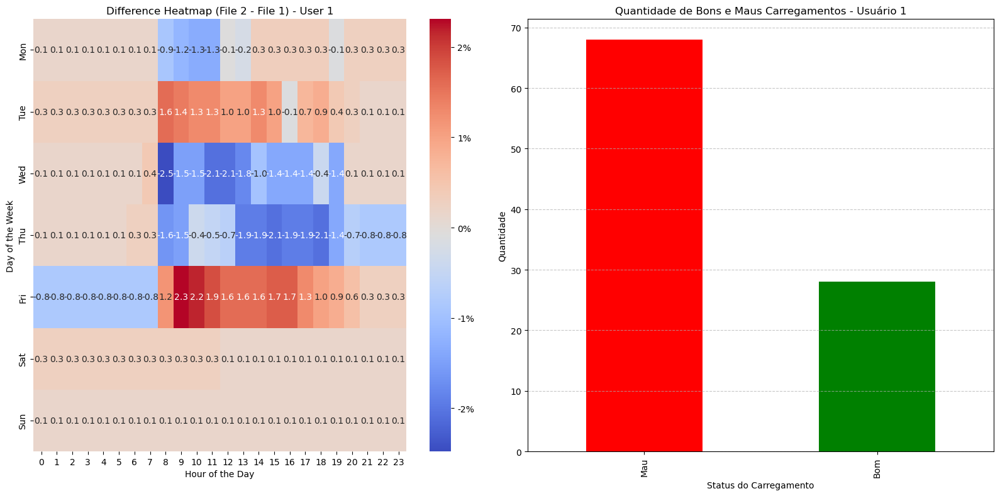

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

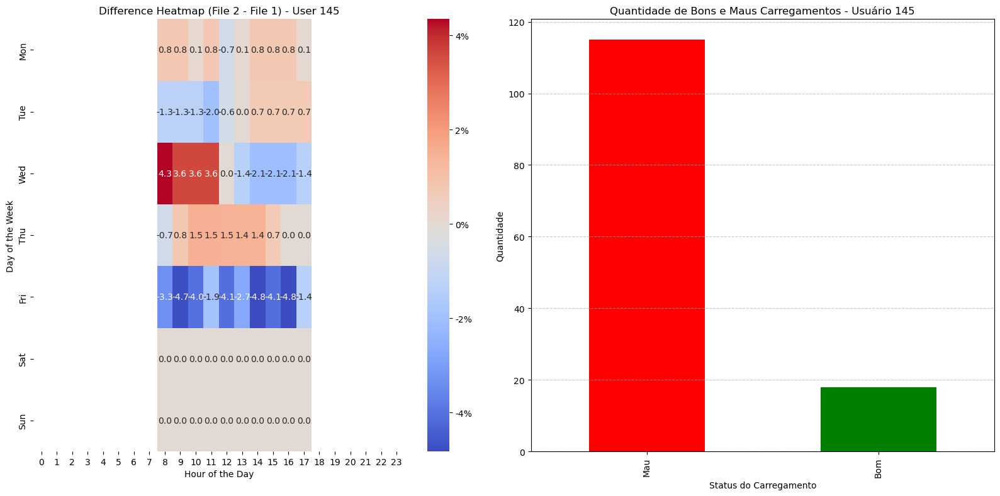

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

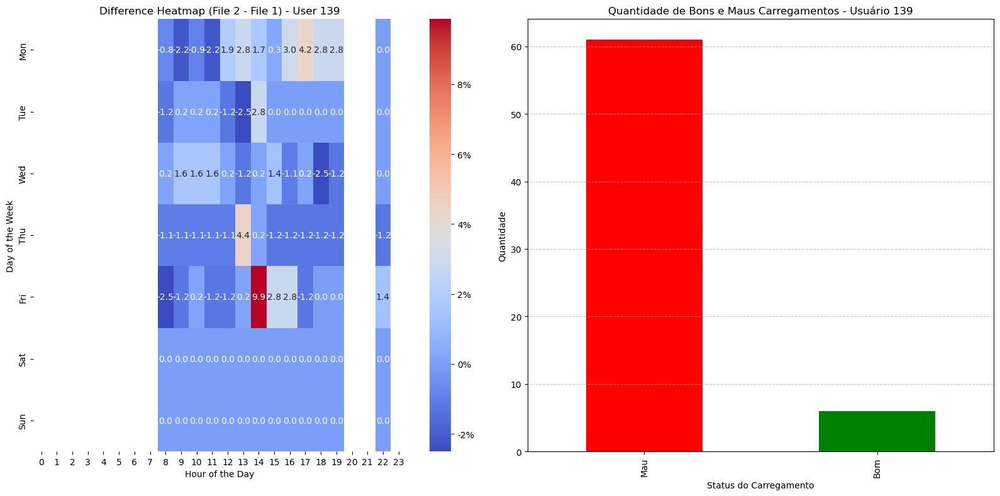

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

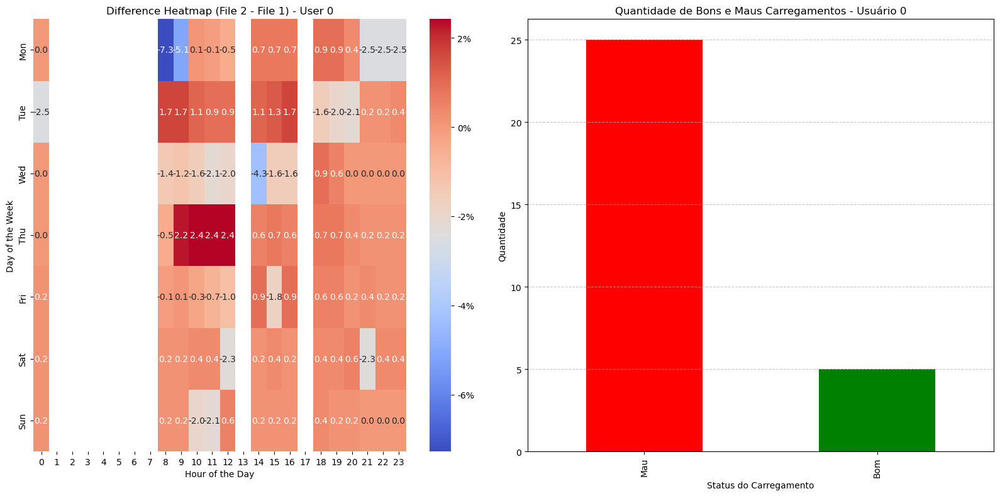

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

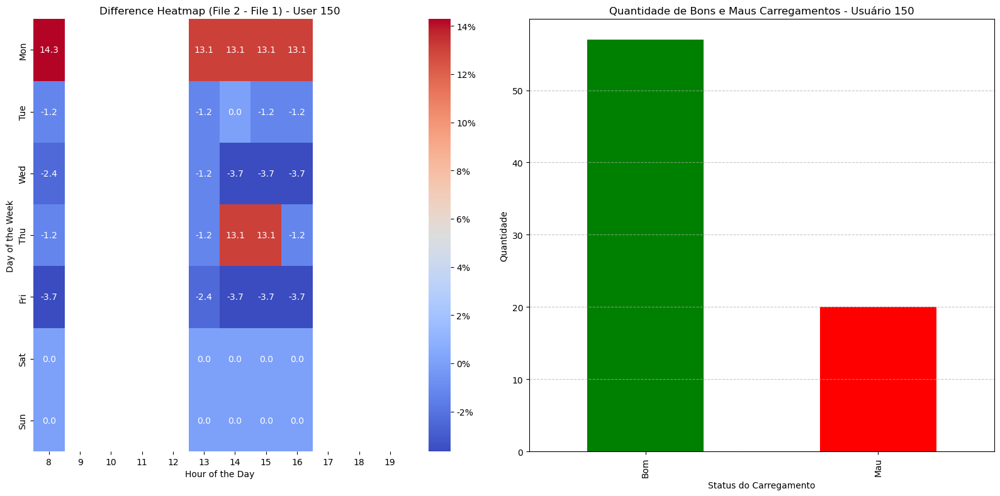

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

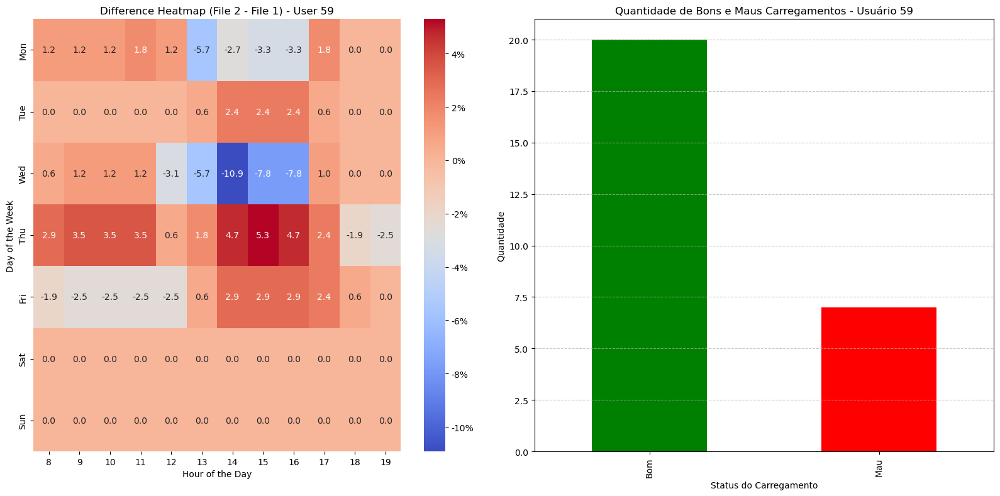

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

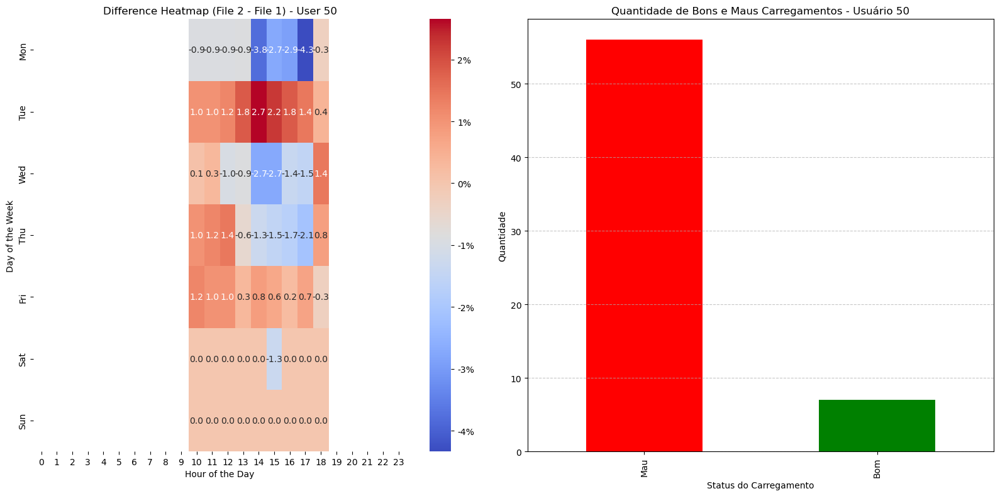

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

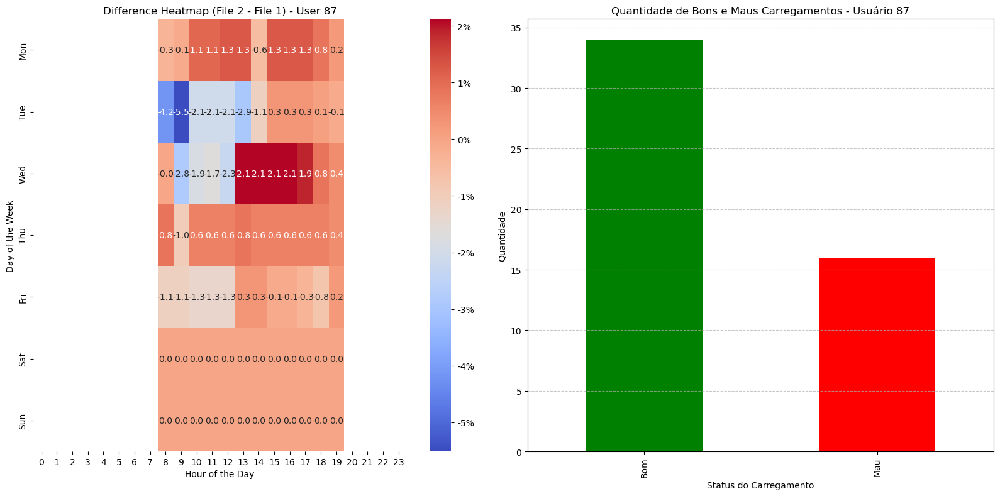

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

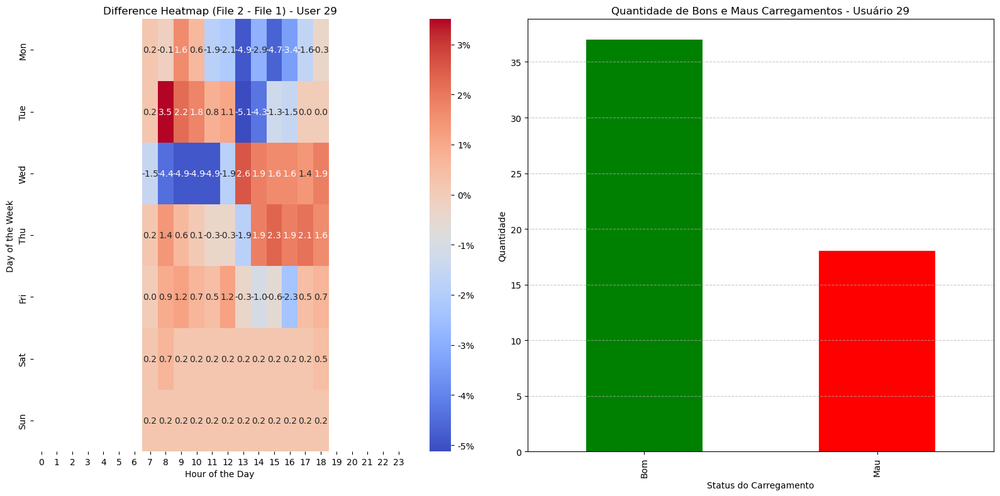

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

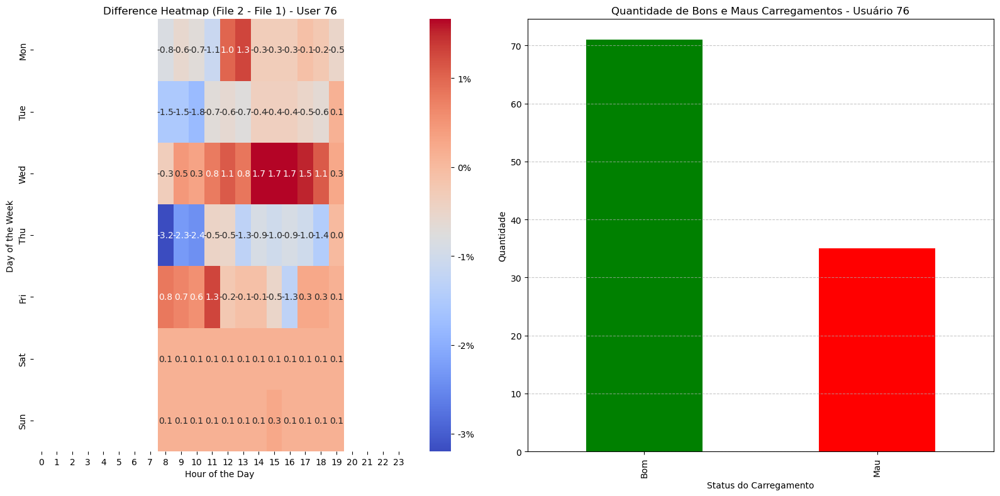

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

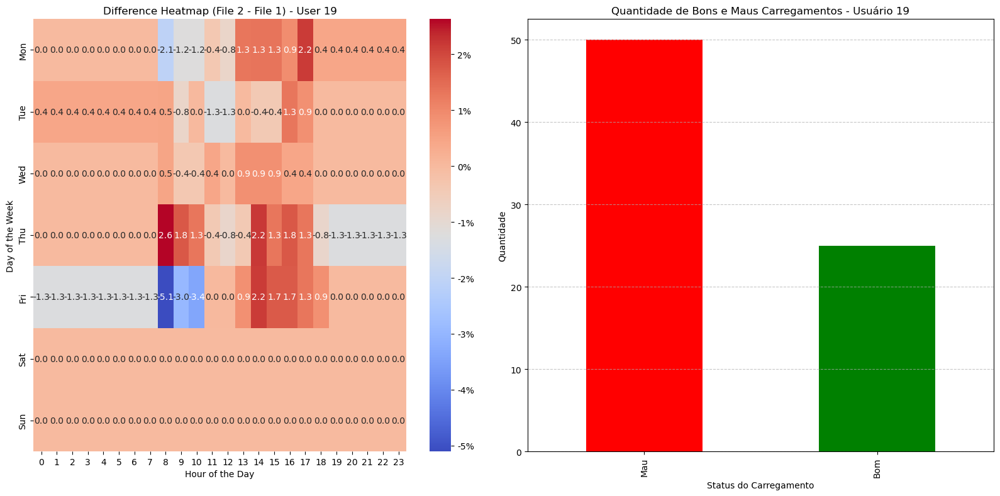

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

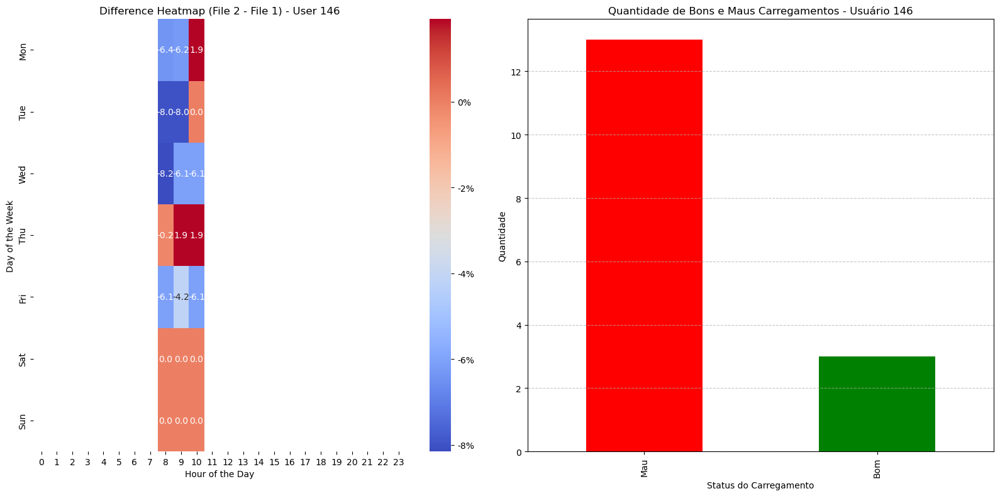

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

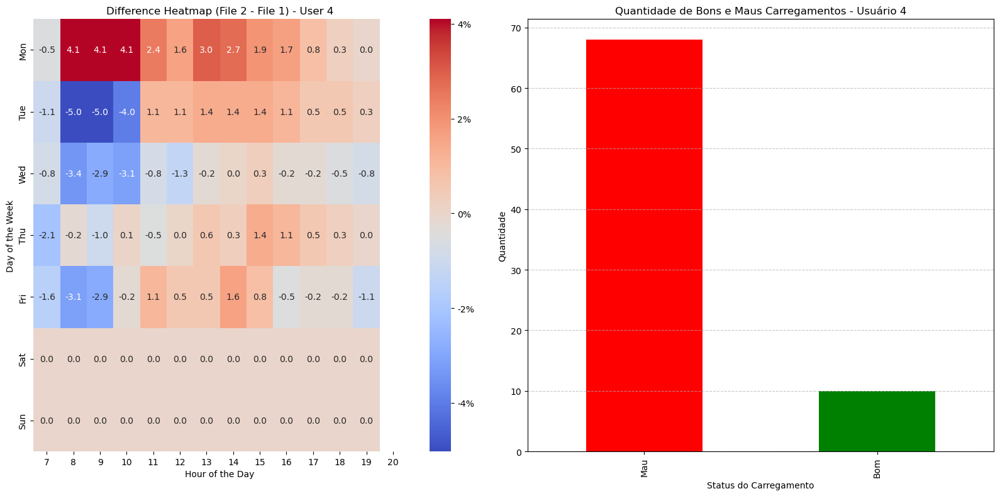

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

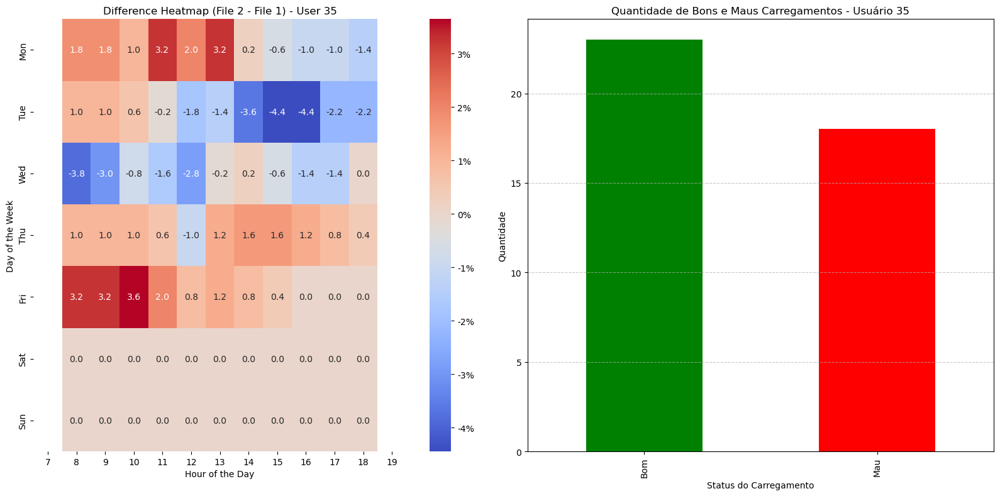

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

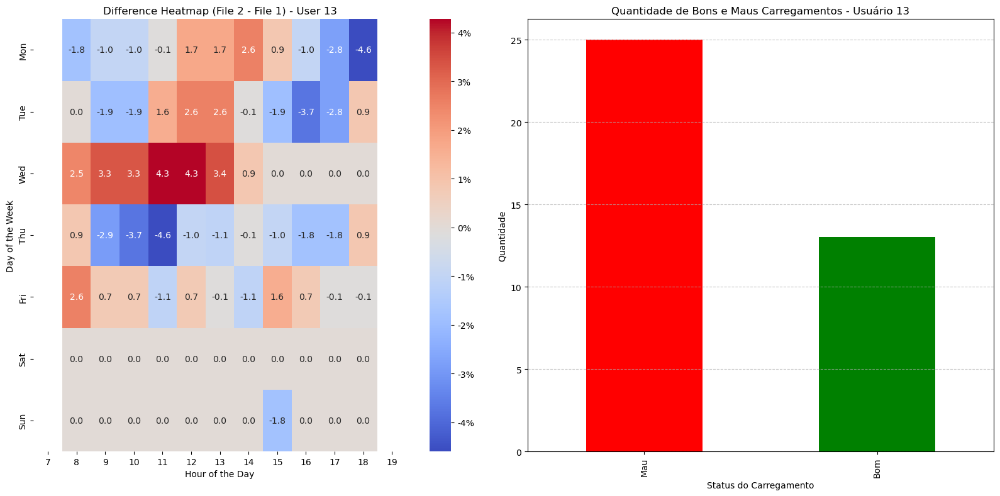

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

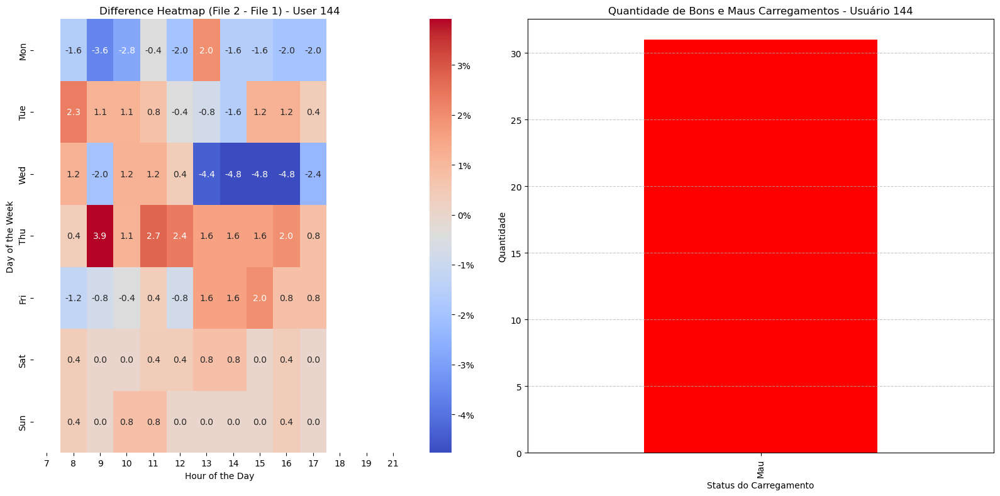

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

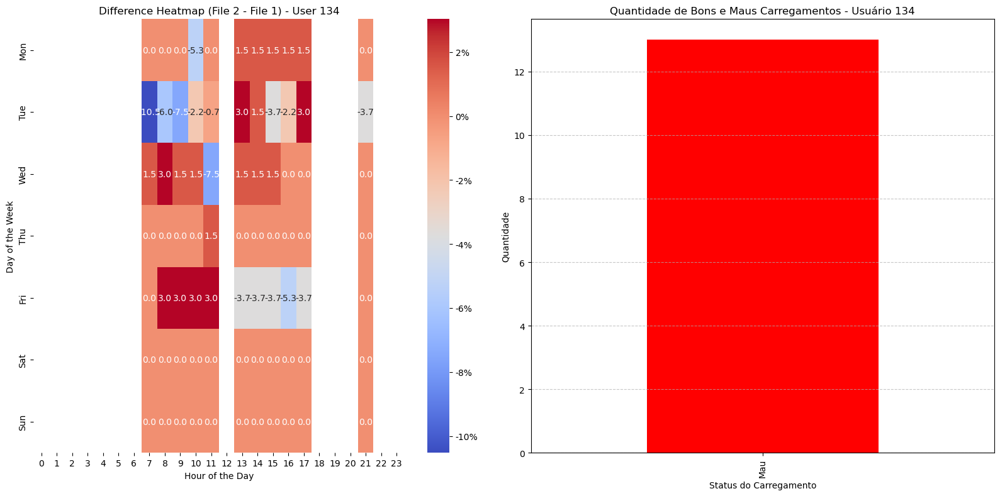

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

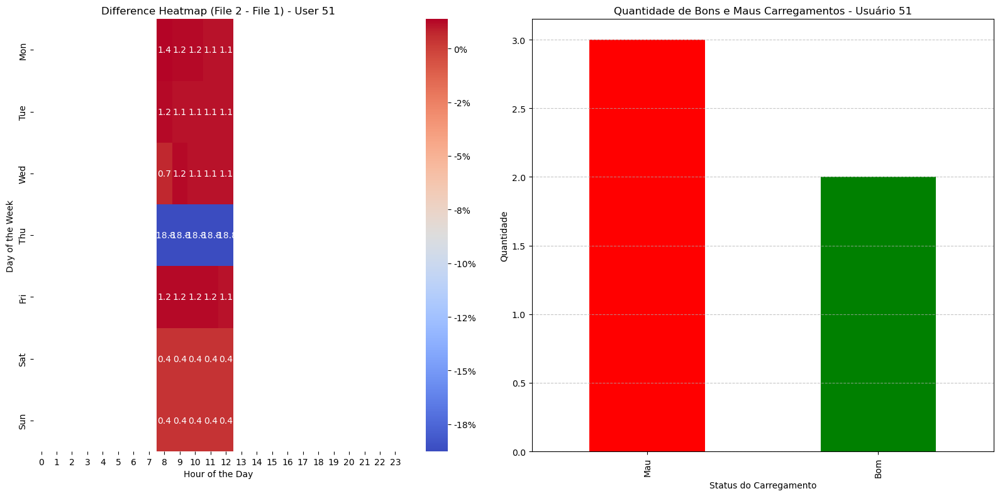

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

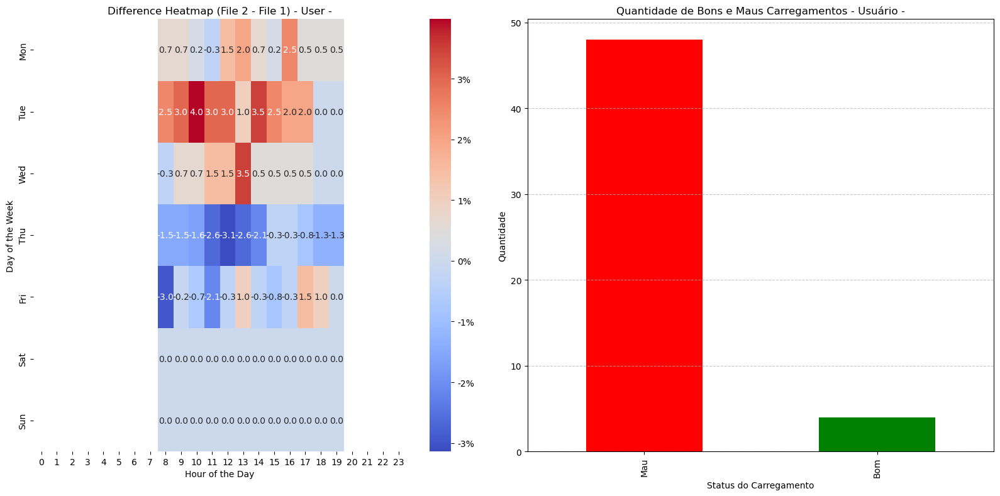

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

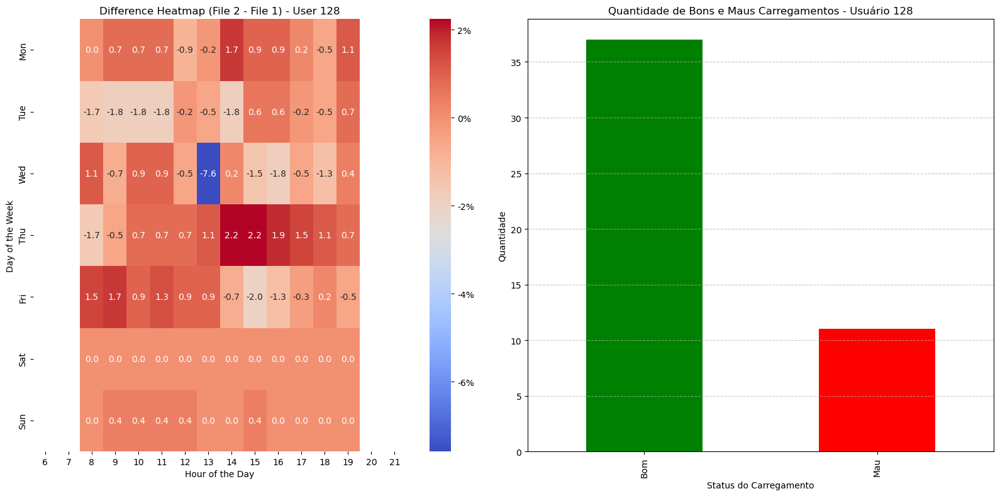

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

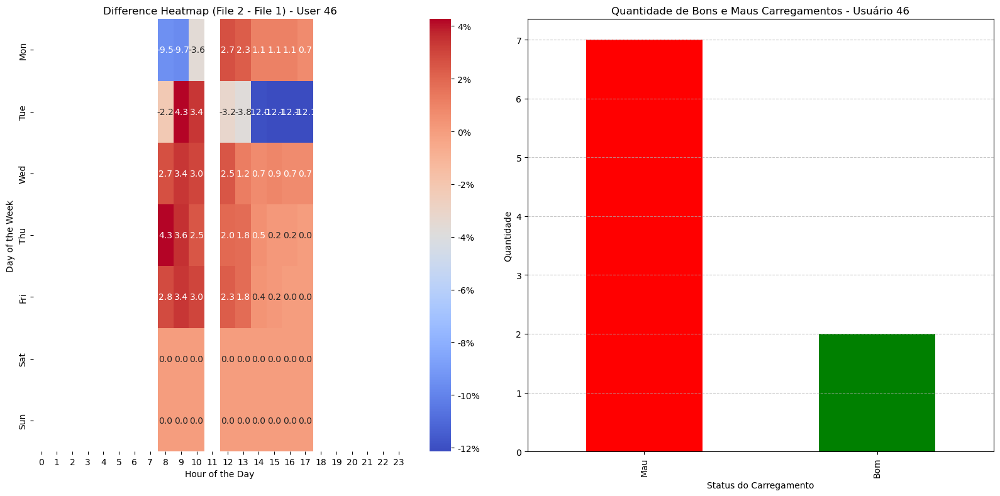

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

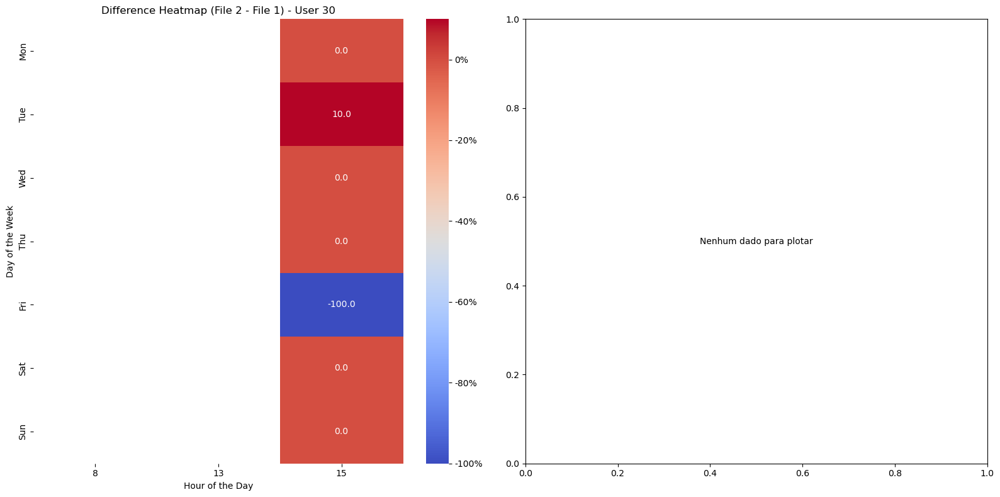

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_996\3313815938.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek
C:\Users\miguel.preto\Anaconda3\lib\site-packages\seaborn\matrix.py:198: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
C:\Users\mi

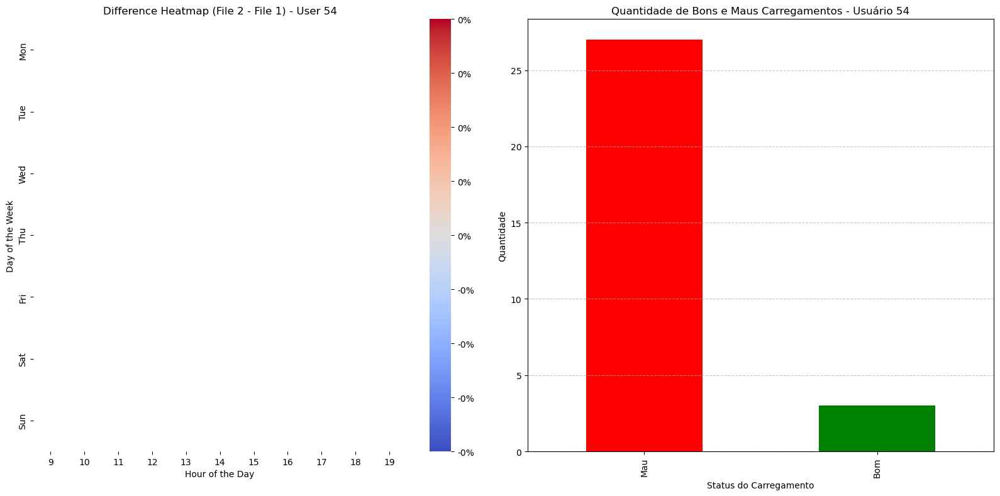

In [8]:
def plot_combined(data1, data2, incentives_df, user):
    heatmap_data1 = create_heatmap_data(data1, user)
    heatmap_data2 = create_heatmap_data(data2, user)

    # Criar a lista de intervalos de tempo de carregamento para o usuário
    user_data = data1[data1['Nº cartão EVIO'] == user]
    intervals = [(start, stop) for start, stop in zip(user_data['Start date'], user_data['Stop date'])]
    incentives_df['Carregamento'] = incentives_df['datetime'].apply(lambda x: check_if_in_intervals(x, intervals))
    resultado_df = incentives_df[['datetime', 'Carregamento']]
    carregamentos = resultado_df[resultado_df['Carregamento'] == 1]
    merged_df = pd.merge(carregamentos, incentives_df[['datetime', 'value']], on='datetime', how='inner')
    incentives_df['date'] = incentives_df['datetime'].dt.date
    quantil_diario = incentives_df.groupby('date')['value'].quantile(0.5).reset_index()
    quantil_diario.columns = ['date', 'daily_quantile']
    merged_df['date'] = merged_df['datetime'].dt.date
    merged_df = pd.merge(merged_df, quantil_diario, on='date', how='left')
    merged_df['Status'] = merged_df['value'].apply(lambda x: 'Bom' if x < merged_df['daily_quantile'].values[0] else 'Mau')
    status_counts = merged_df['Status'].value_counts()

    # Subtração dos Heatmaps
    heatmap_diff = heatmap_data2 - heatmap_data1
    
    fig, axes = plt.subplots(1, 2, figsize=(16, 8), sharey=False)
    
    sns.heatmap(heatmap_diff, cmap="coolwarm", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'}, ax=axes[0])
    axes[0].set_title(f"Difference Heatmap (File 2 - File 1) - User {user}")
    axes[0].set_xlabel("Hour of the Day")
    axes[0].set_ylabel("Day of the Week")
    
    if not status_counts.empty:
        colors = ['green' if status == 'Bom' else 'red' for status in status_counts.index]
        status_counts.plot(kind='bar', color=colors, ax=axes[1])
        axes[1].set_title(f'Quantidade de Bons e Maus Carregamentos - Usuário {user}')
        axes[1].set_xlabel('Status do Carregamento')
        axes[1].set_ylabel('Quantidade')
        axes[1].grid(axis='y', linestyle='--', alpha=0.7)
    else:
        axes[1].text(0.5, 0.5, 'Nenhum dado para plotar', horizontalalignment='center', verticalalignment='center', transform=axes[1].transAxes)

    plt.tight_layout()
    plt.show()
    
# Preparar os dados
user_df1, incentivos_df1 = prepare_data('EVIO_history_01-03-2024_01-06-2024.xlsx', 'output_data_2024-03-01_to_2024-06-30.csv')
user_df2, _ = prepare_data('EVIO_history_01-02-2023_29-02-2024.xlsx', 'output_data_2024-03-01_to_2024-06-30.csv')
# Iterar por cada usuário e plotar os gráficos
usuarios = user_df1['Nº cartão EVIO'].unique()

for usuario in usuarios:
    plot_combined(user_df1, user_df2, incentivos_df1, usuario)



C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


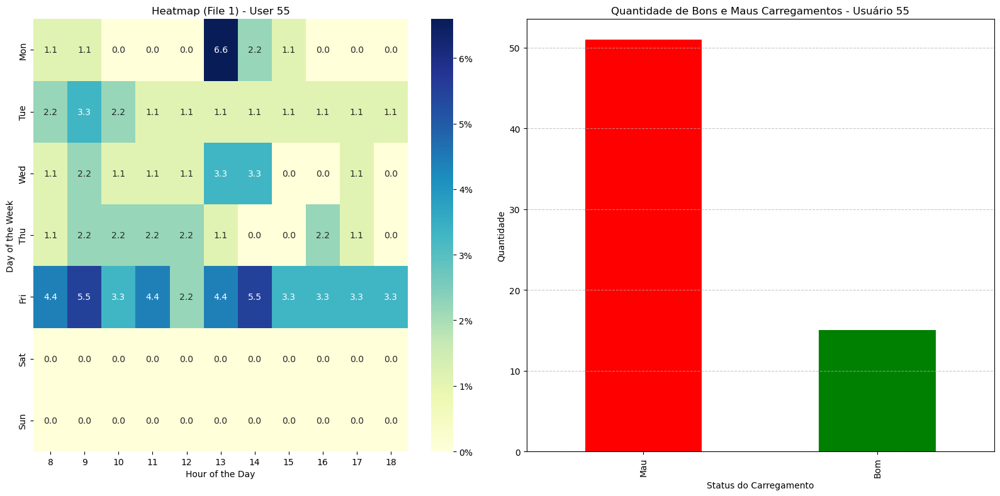

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


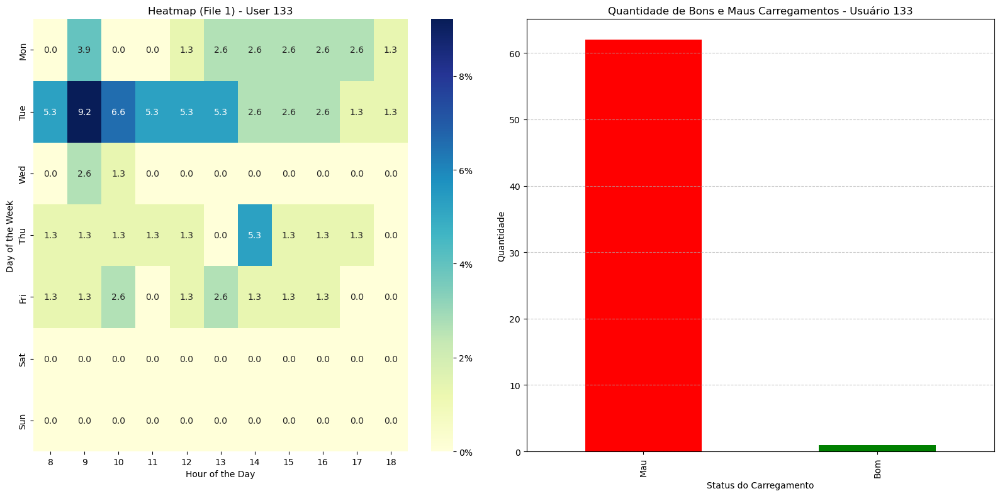

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


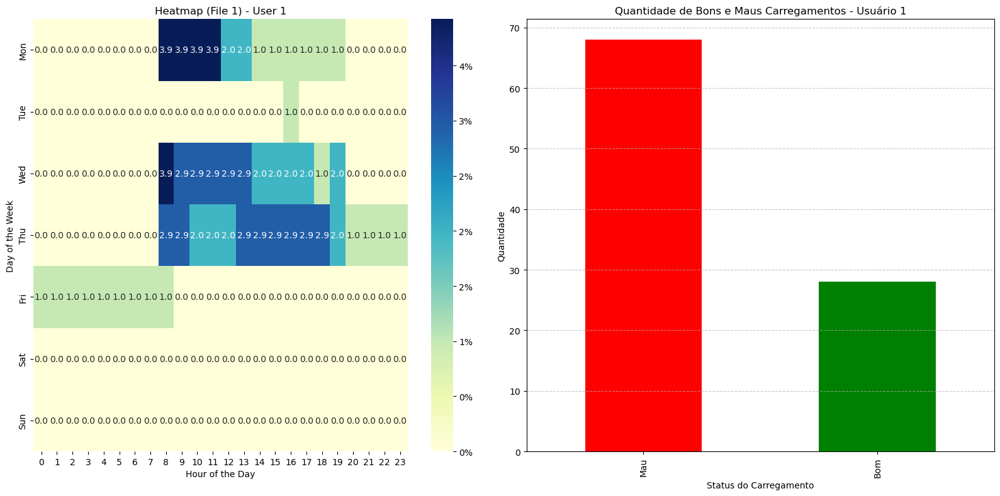

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


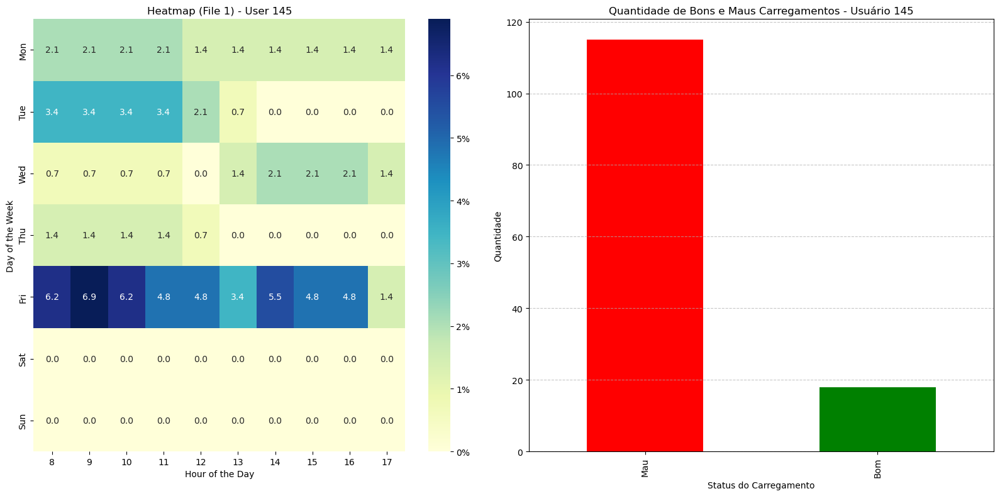

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


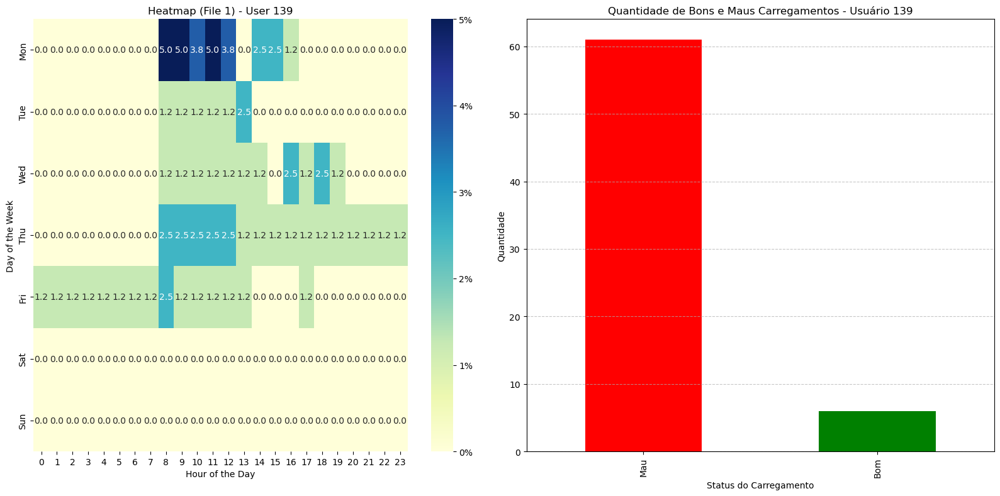

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


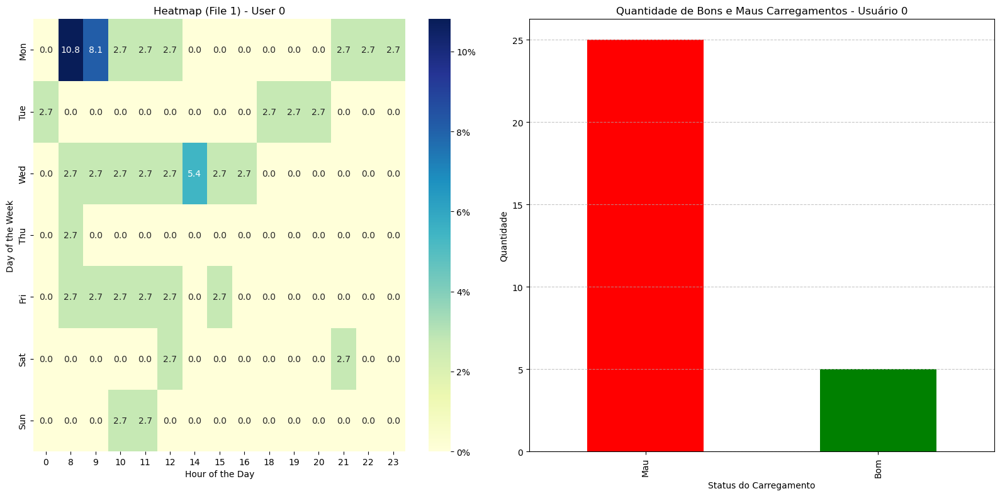

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


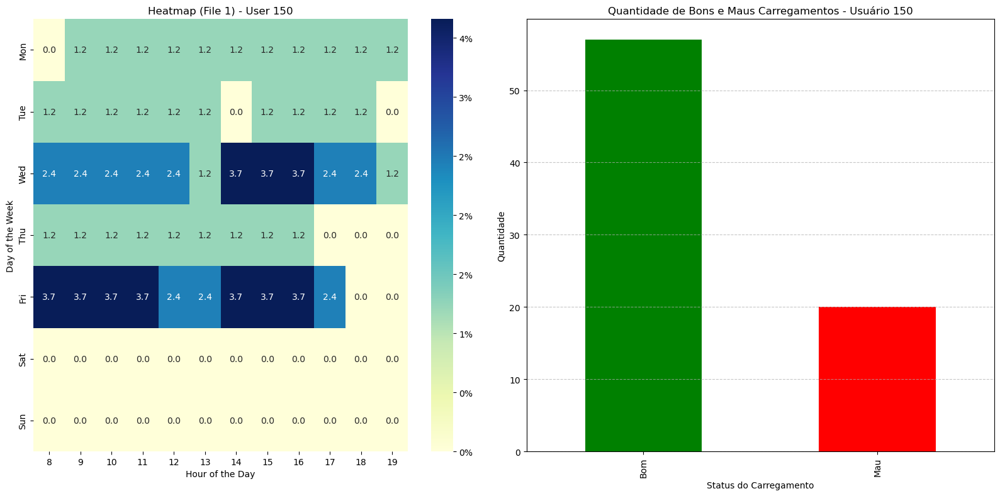

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


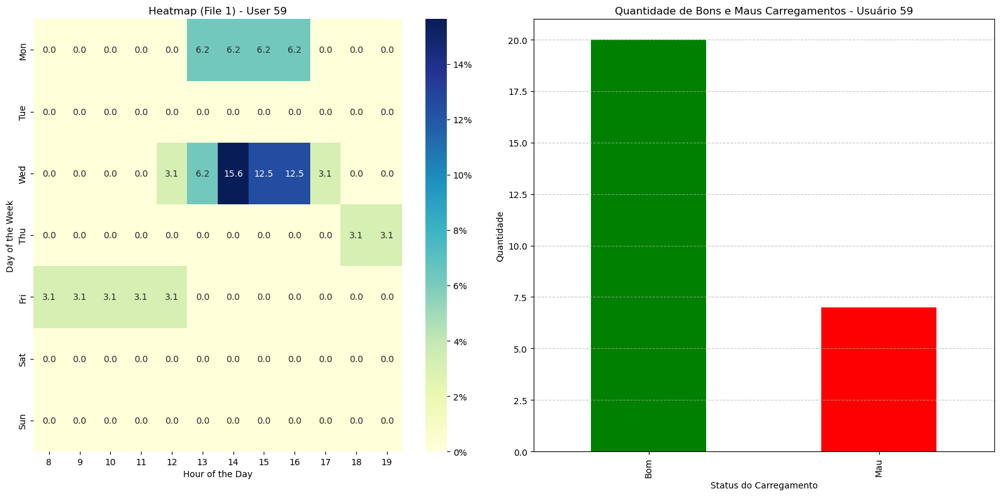

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


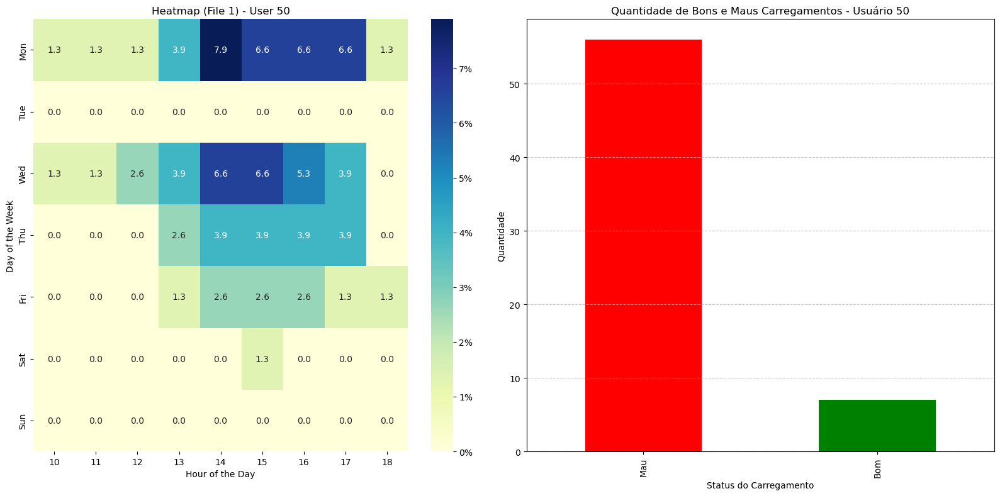

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


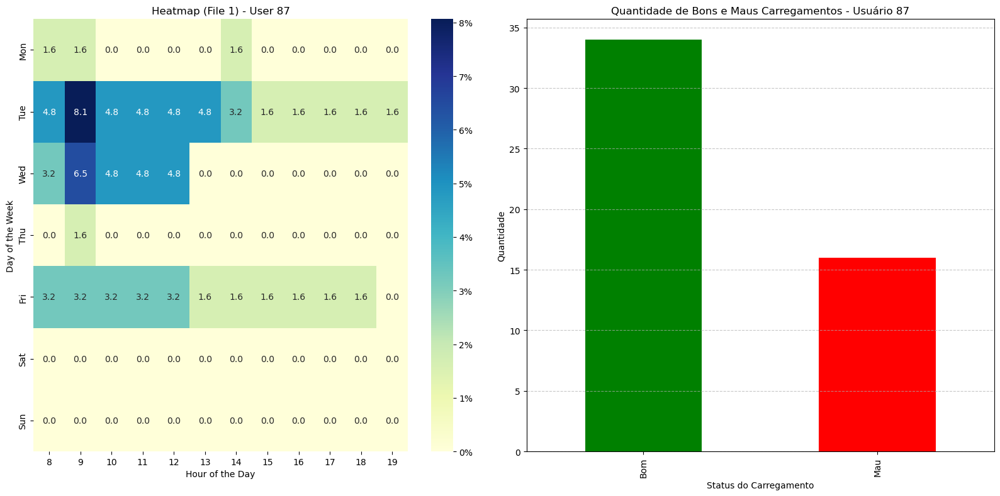

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


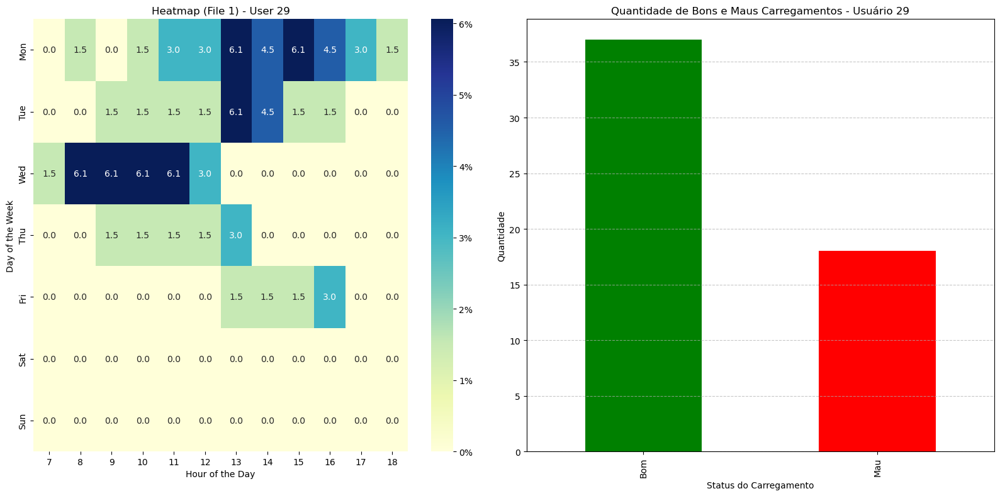

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


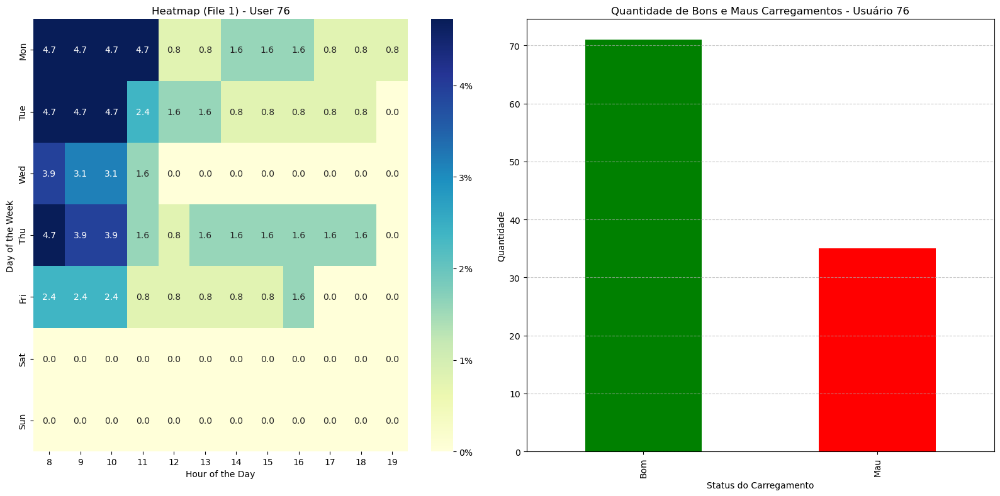

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


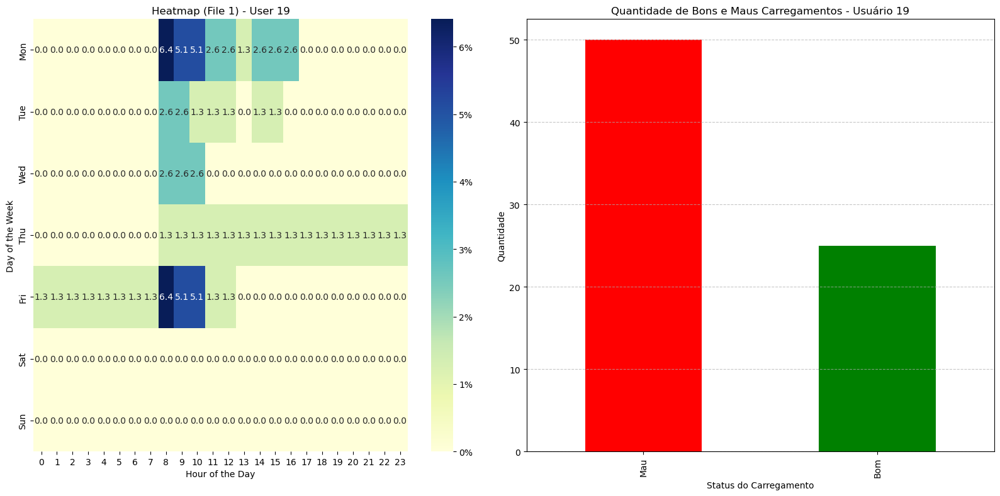

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


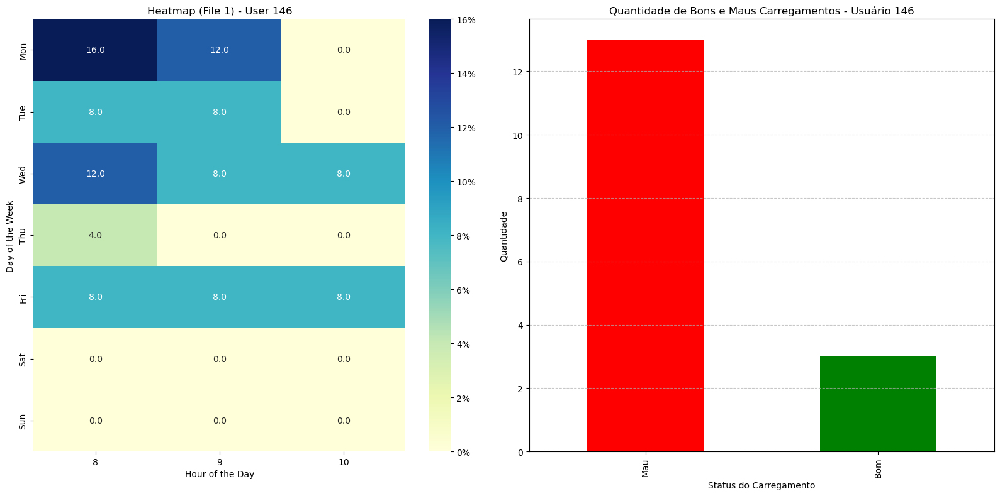

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


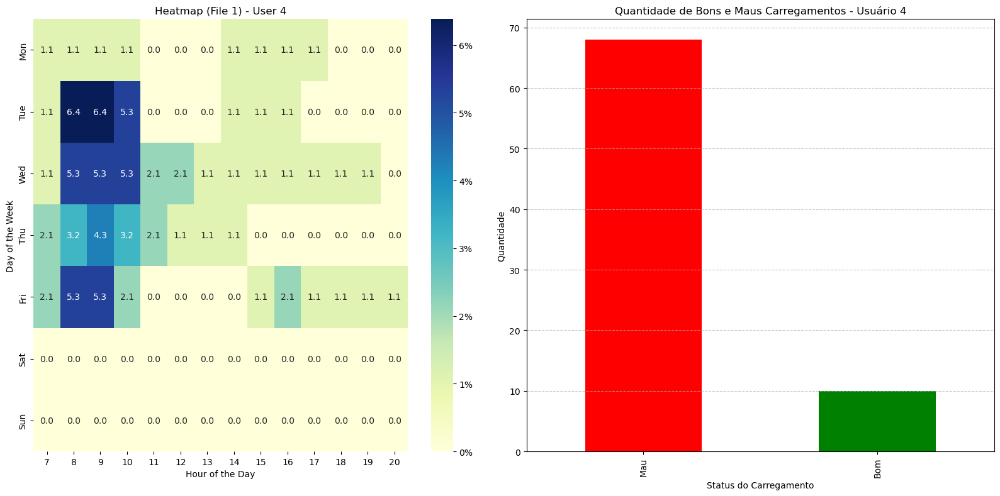

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


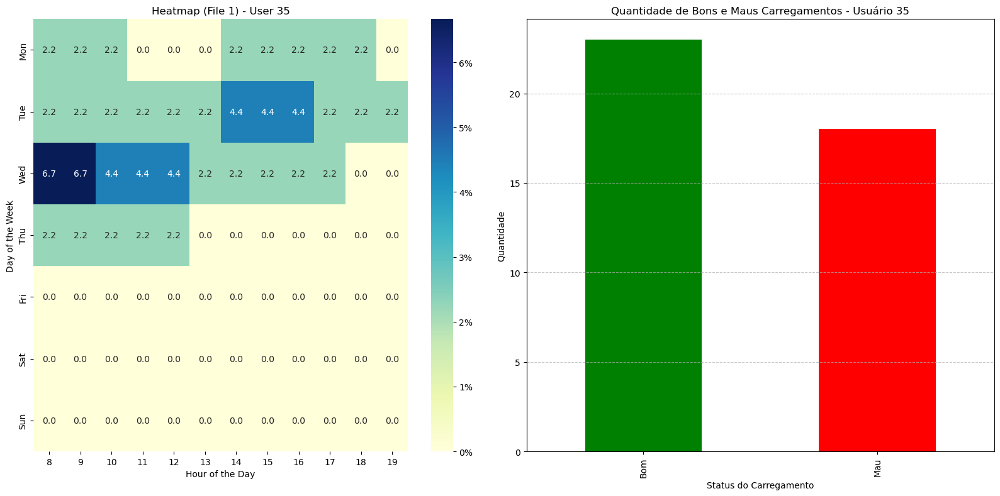

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


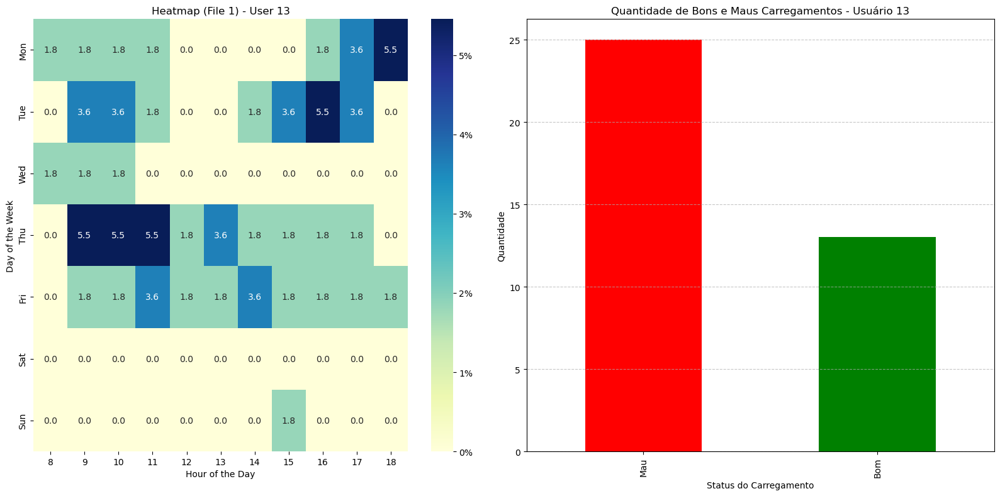

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


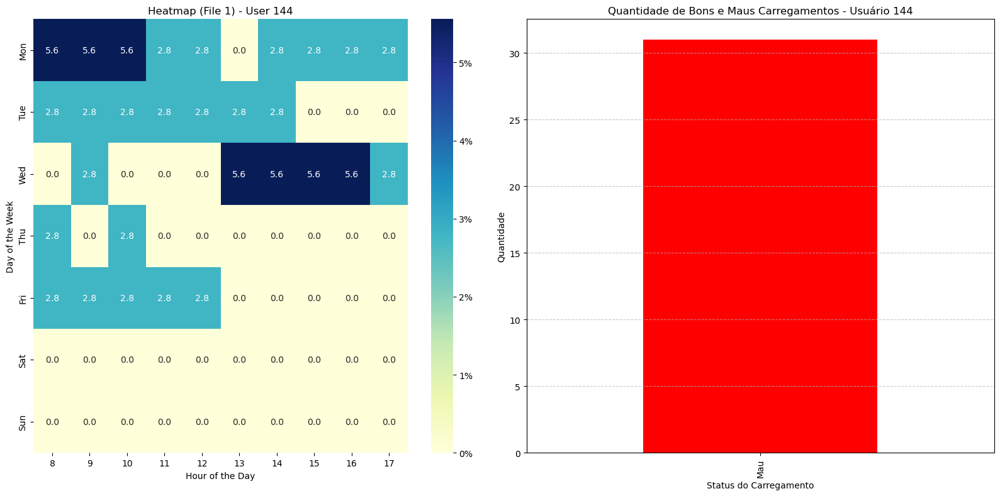

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


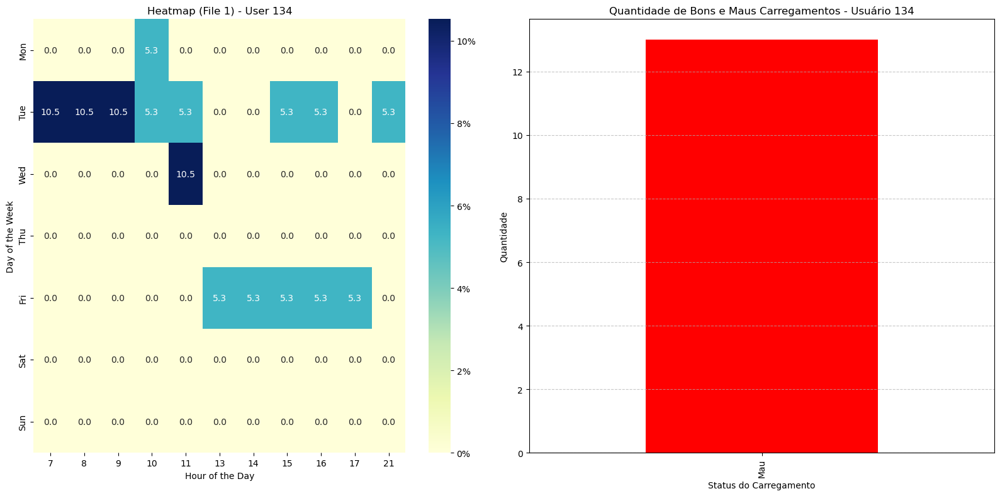

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


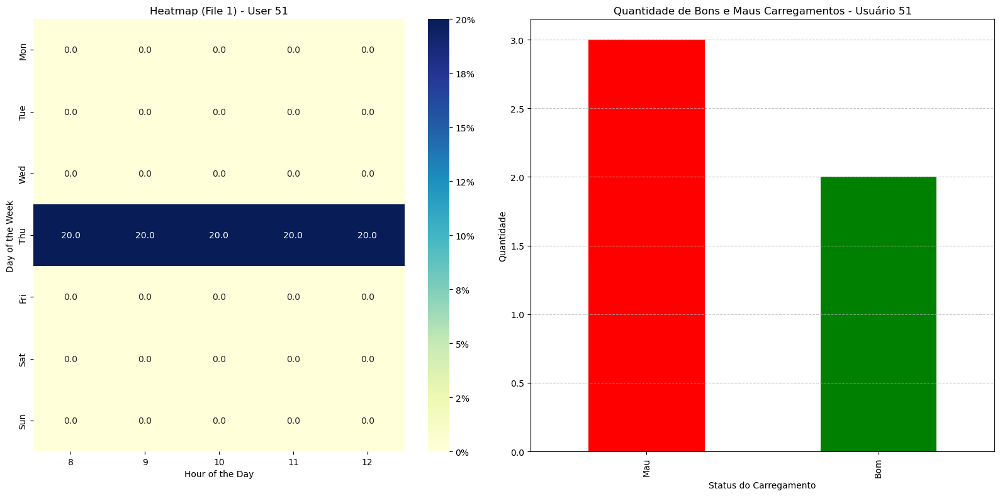

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


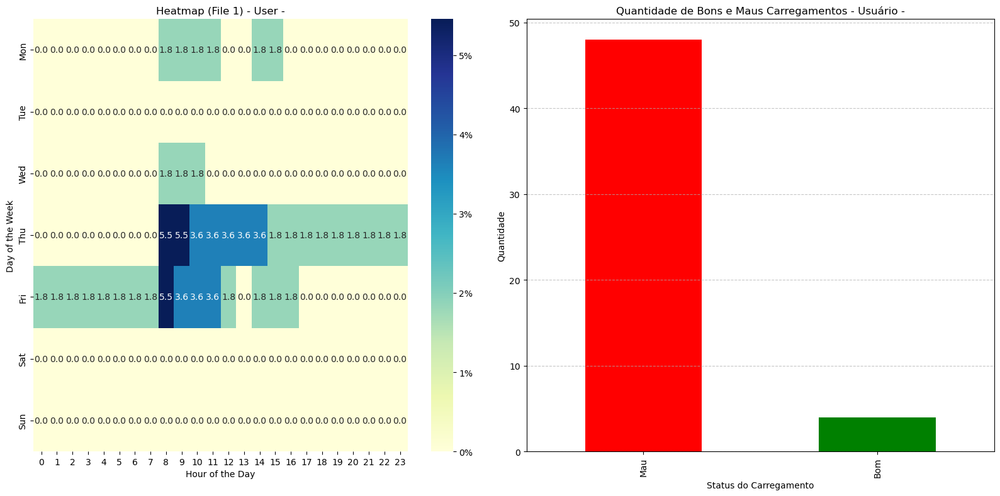

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


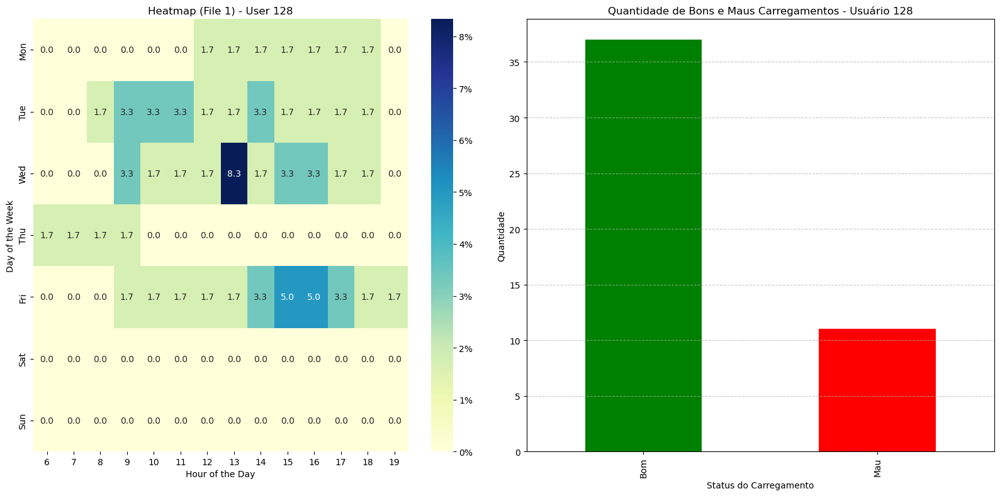

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


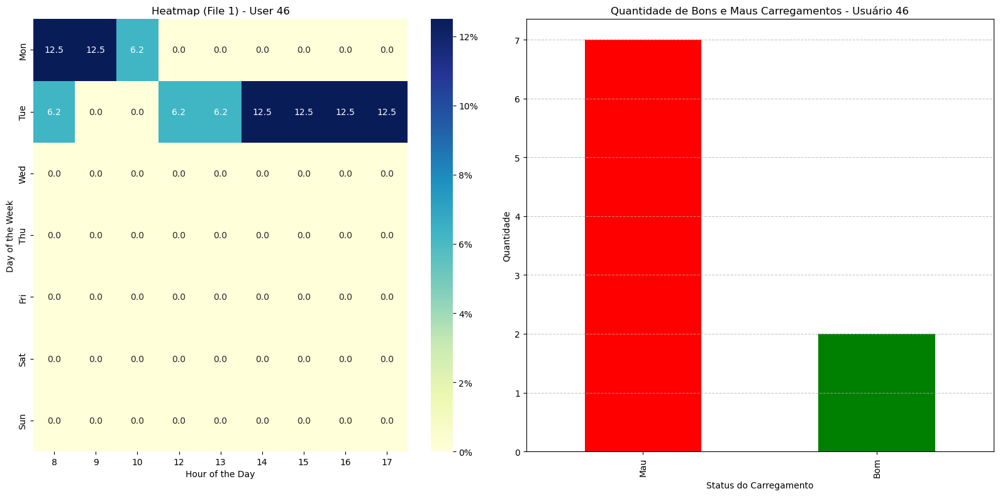

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


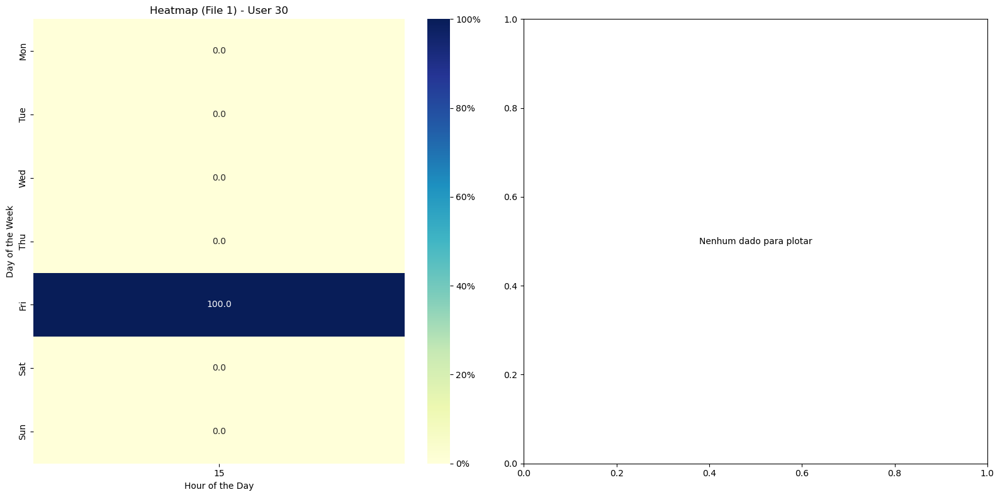

C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Start hour'] = user_data['Start date'].dt.hour
C:\Users\miguel.preto\AppData\Local\Temp\ipykernel_6844\3050744289.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user_data['Weekday'] = user_data['Start date'].dt.dayofweek


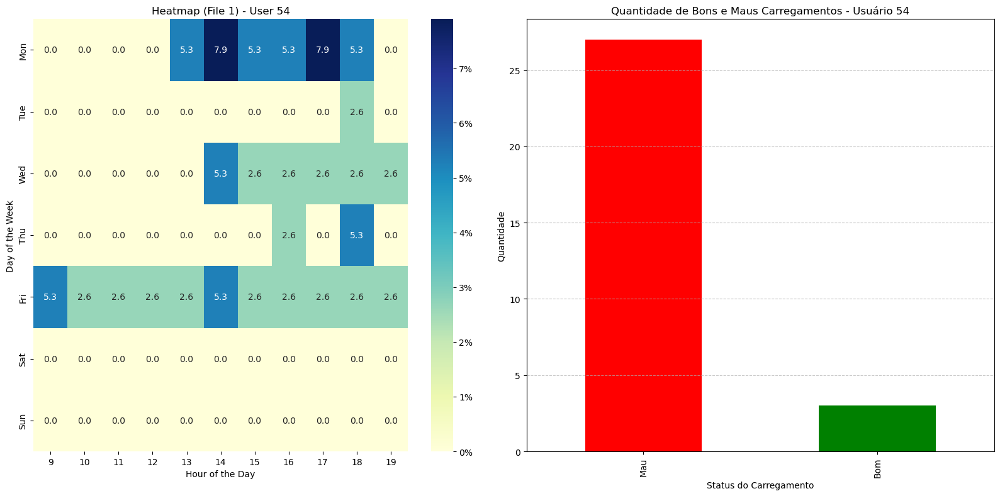

In [19]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Função para carregar e preparar os dados
def prepare_data(user_file, incentives_file):
    user_df = pd.read_excel(user_file)
    incentivos_df = pd.read_csv(incentives_file, sep=';')
    
    incentivos_df.columns = ['datetime', 'request', 'value', 'unit', 'quality', 'updated_at', 'Hour']
    incentivos_df['datetime'] = pd.to_datetime(incentivos_df['datetime'], format='%Y-%m-%d %H:%M:%S')
    incentivos_df['datetime'] = incentivos_df['datetime'].dt.tz_localize(None)
    
    user_df['Start date'] = pd.to_datetime(user_df['Start date'], format='%m/%d/%Y | %H:%M')
    user_df['Stop date'] = pd.to_datetime(user_df['Stop date'], format='%m/%d/%Y | %H:%M')
    user_df['Start date'] = user_df['Start date'].dt.tz_localize(None)
    user_df['Stop date'] = user_df['Stop date'].dt.tz_localize(None)
    
    incentivos_df['value'] = incentivos_df['value'].astype(str).str.replace(',', '.').astype(float)
    
    return user_df, incentivos_df

# Função para criar heatmap de dados de carregamento
def create_heatmap_data(data, user):
    user_data = data[data['Nº cartão EVIO'] == user]
    user_data['Start hour'] = user_data['Start date'].dt.hour
    user_data['Weekday'] = user_data['Start date'].dt.dayofweek

    def expand_hours(row):
        start = row['Start date']
        stop = row['Stop date']
        hours = pd.date_range(start, stop, freq='H').tolist()
        return [(row['Nº cartão EVIO'], h.dayofweek, h.hour) for h in hours]

    expanded_data = user_data.apply(expand_hours, axis=1).explode().tolist()
    expanded_df = pd.DataFrame(expanded_data, columns=['Nº cartão EVIO', 'Weekday', 'Hour'])
    
    heatmap_data = expanded_df.groupby(['Weekday', 'Hour']).size().unstack(fill_value=0)
    all_weekdays = pd.Index(range(7), name='Weekday')
    heatmap_data = heatmap_data.reindex(all_weekdays, fill_value=0)
    total_hours = heatmap_data.values.sum()
    heatmap_data_percent = (heatmap_data / total_hours) * 100
    heatmap_data_percent.index = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']

    return heatmap_data_percent

# Função para verificar se uma datetime está dentro de algum intervalo
def check_if_in_intervals(dt, intervals):
    for start, stop in intervals:
        if start <= dt <= stop:
            return 1
    return 0

# Função para plotar gráficos lado a lado
def plot_combined(data1, incentives_df, user):
    heatmap_data1 = create_heatmap_data(data1, user)

    # Criar a lista de intervalos de tempo de carregamento para o usuário
    user_data = data1[data1['Nº cartão EVIO'] == user]
    intervals = [(start, stop) for start, stop in zip(user_data['Start date'], user_data['Stop date'])]
    incentives_df['Carregamento'] = incentives_df['datetime'].apply(lambda x: check_if_in_intervals(x, intervals))
    resultado_df = incentives_df[['datetime', 'Carregamento']]
    carregamentos = resultado_df[resultado_df['Carregamento'] == 1]
    merged_df = pd.merge(carregamentos, incentives_df[['datetime', 'value']], on='datetime', how='inner')
    incentives_df['date'] = incentives_df['datetime'].dt.date
    quantil_diario = incentives_df.groupby('date')['value'].quantile(0.5).reset_index()
    quantil_diario.columns = ['date', 'daily_quantile']
    merged_df['date'] = merged_df['datetime'].dt.date
    merged_df = pd.merge(merged_df, quantil_diario, on='date', how='left')
    merged_df['Status'] = merged_df['value'].apply(lambda x: 'Bom' if x < merged_df['daily_quantile'].values[0] else 'Mau')
    status_counts = merged_df['Status'].value_counts()
    
    fig, axes = plt.subplots(1, 2, figsize=(16, 8), sharey=False)
    
    sns.heatmap(heatmap_data1, cmap="YlGnBu", annot=True, fmt=".1f", cbar_kws={'format': '%.0f%%'}, ax=axes[0])
    axes[0].set_title(f"Heatmap (File 1) - User {user}")
    axes[0].set_xlabel("Hour of the Day")
    axes[0].set_ylabel("Day of the Week")
    
    if not status_counts.empty:
        colors = ['green' if status == 'Bom' else 'red' for status in status_counts.index]
        status_counts.plot(kind='bar', color=colors, ax=axes[1])
        axes[1].set_title(f'Quantidade de Bons e Maus Carregamentos - Usuário {user}')
        axes[1].set_xlabel('Status do Carregamento')
        axes[1].set_ylabel('Quantidade')
        axes[1].grid(axis='y', linestyle='--', alpha=0.7)
    else:
        axes[1].text(0.5, 0.5, 'Nenhum dado para plotar', horizontalalignment='center', verticalalignment='center', transform=axes[1].transAxes)

    plt.tight_layout()
    plt.show()

# Preparar os dados
user_df1, incentivos_df1 = prepare_data('EVIO_history_01-03-2024_01-06-2024.xlsx', 'output_data_2024-03-01_to_2024-06-30.csv')

# Iterar por cada usuário e plotar os gráficos
usuarios = user_df1['Nº cartão EVIO'].unique()

for usuario in usuarios:
    plot_combined(user_df1, incentivos_df1, usuario)


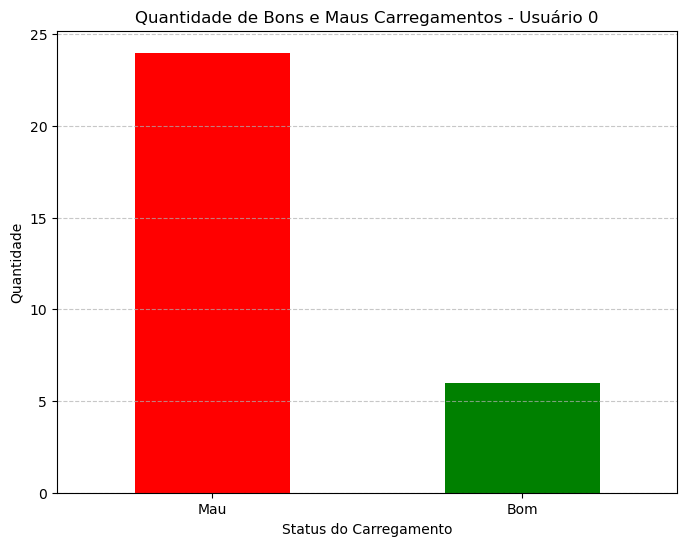

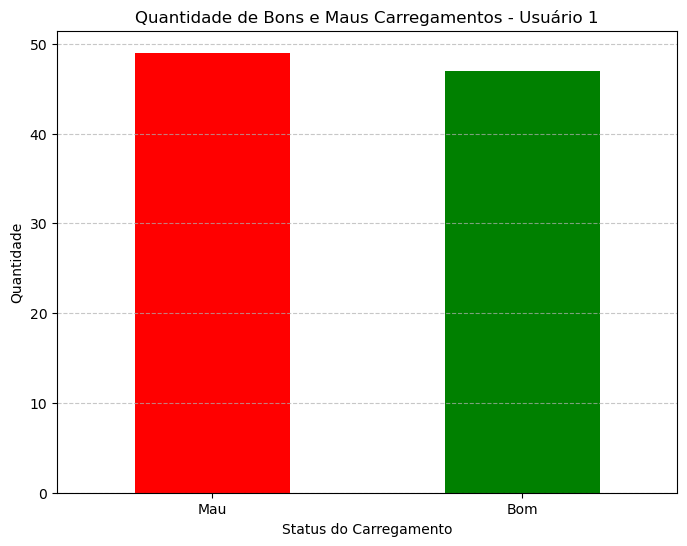

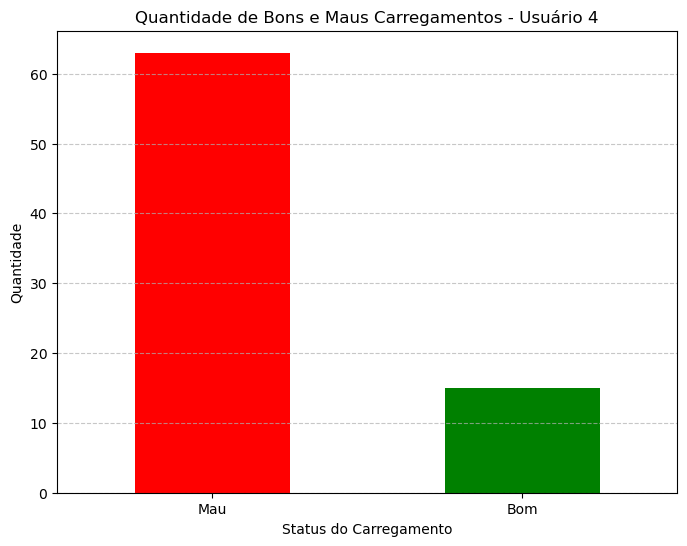

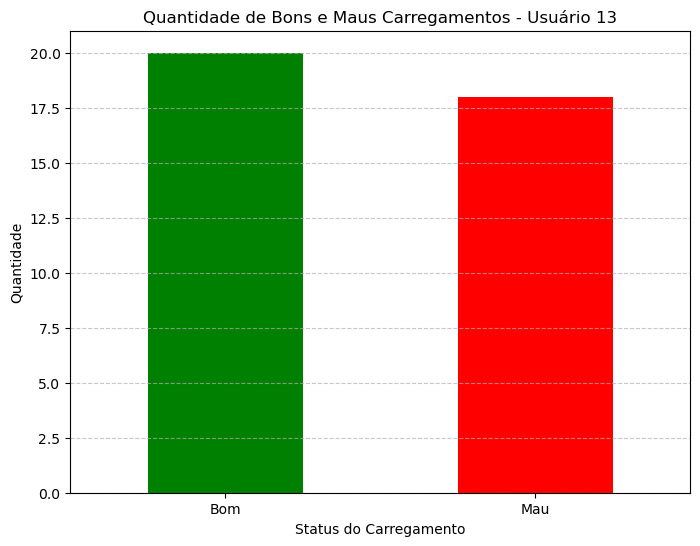

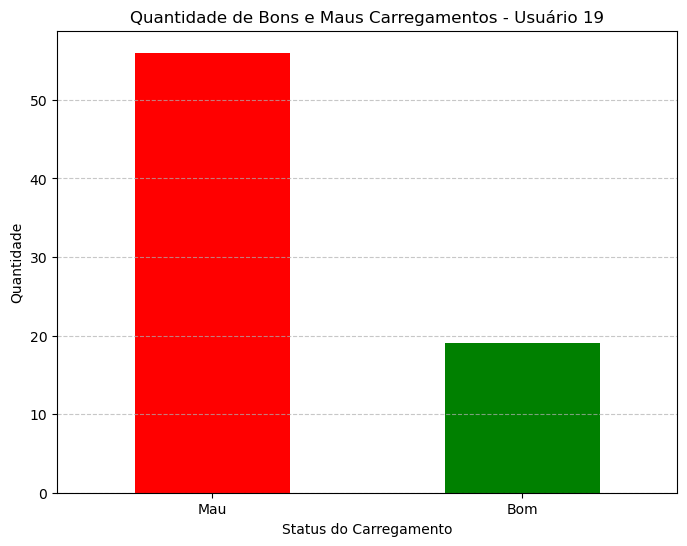

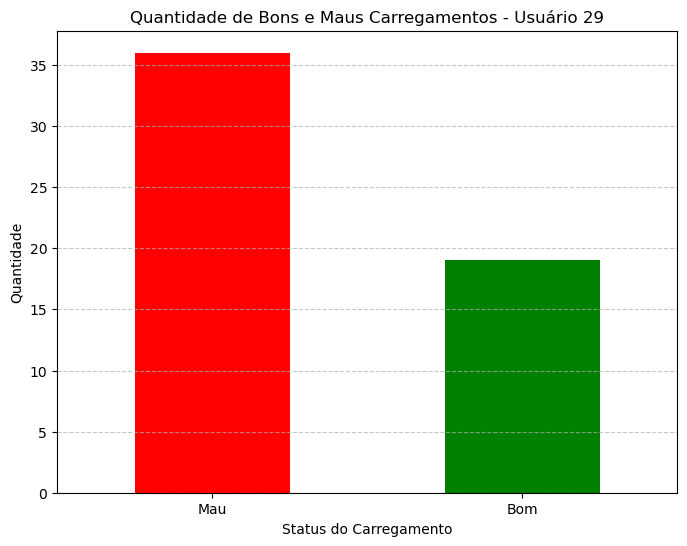

Nenhum dado para plotar para o usuário 30


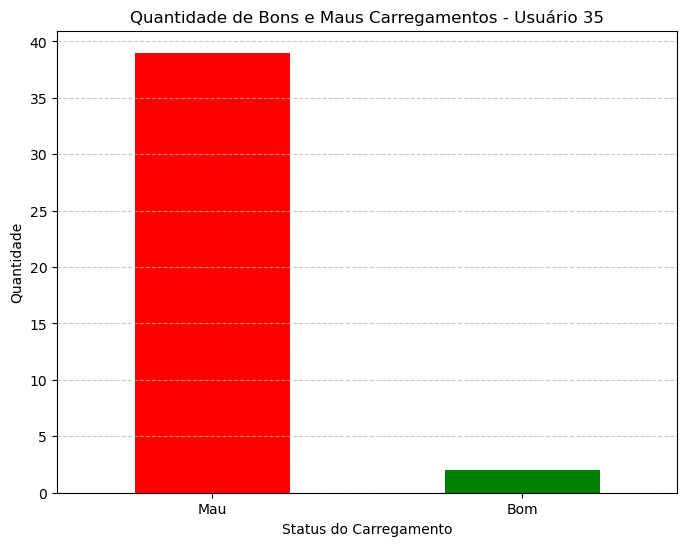

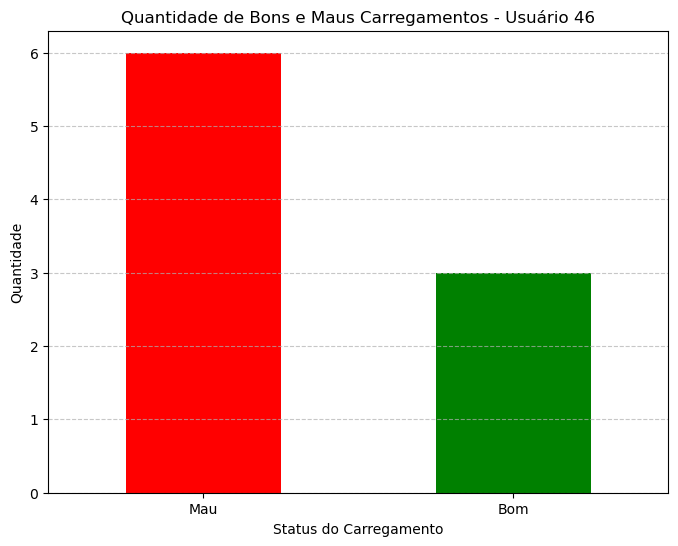

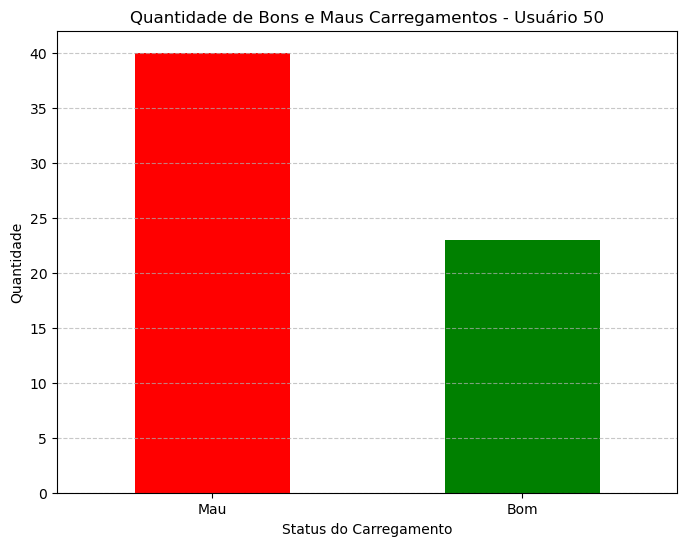

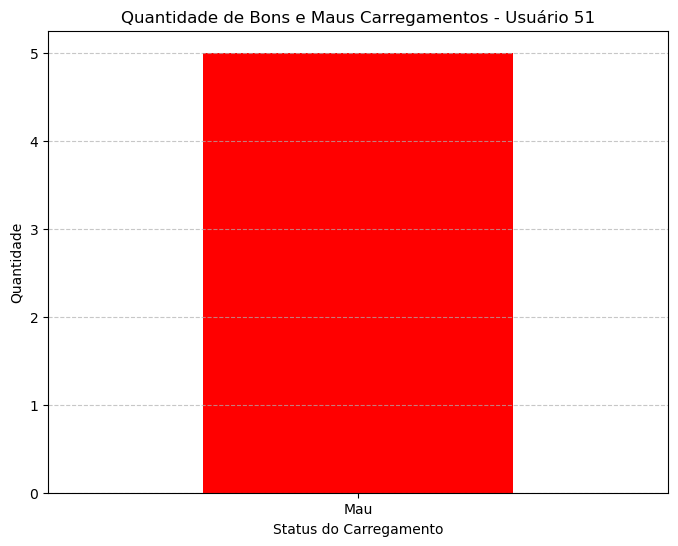

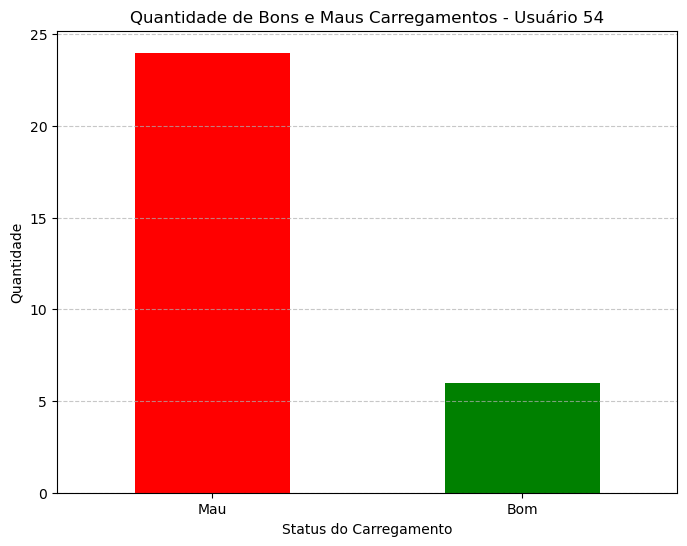

...

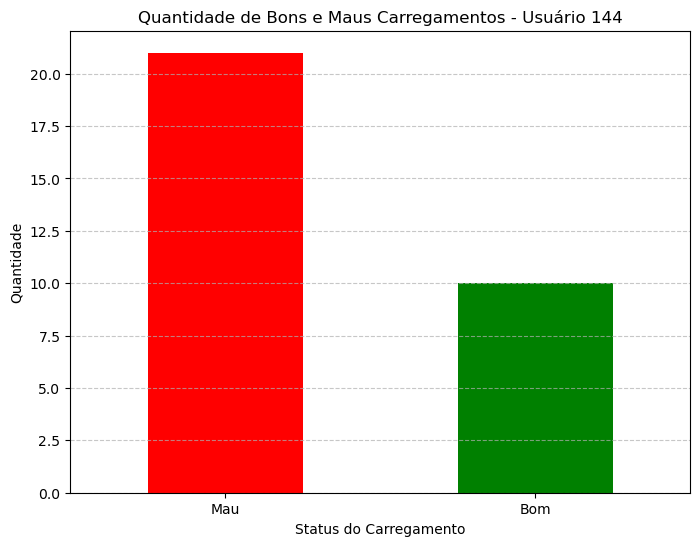

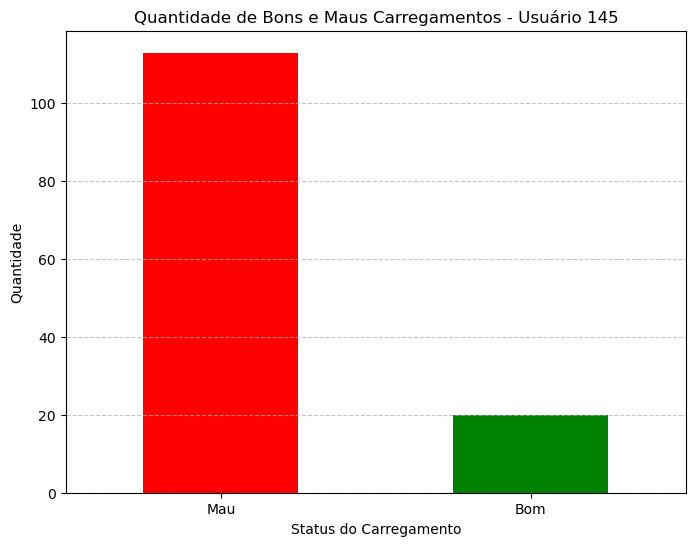

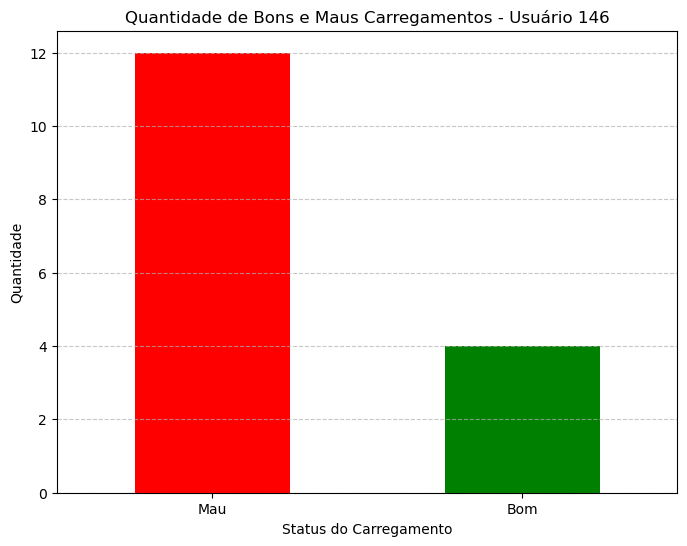

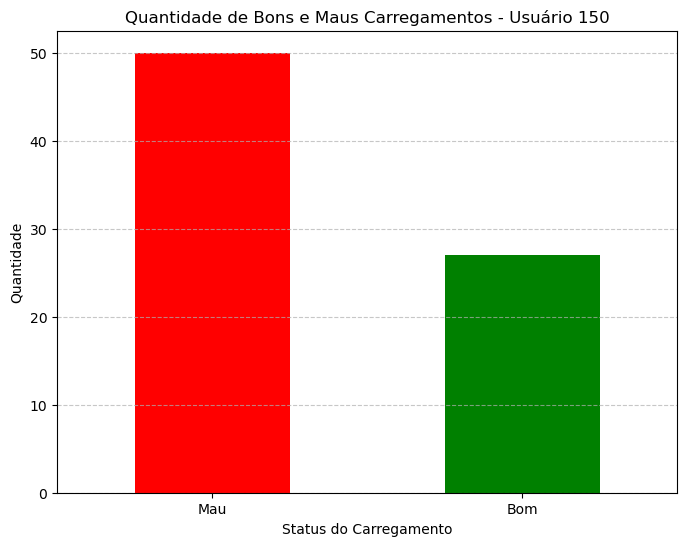

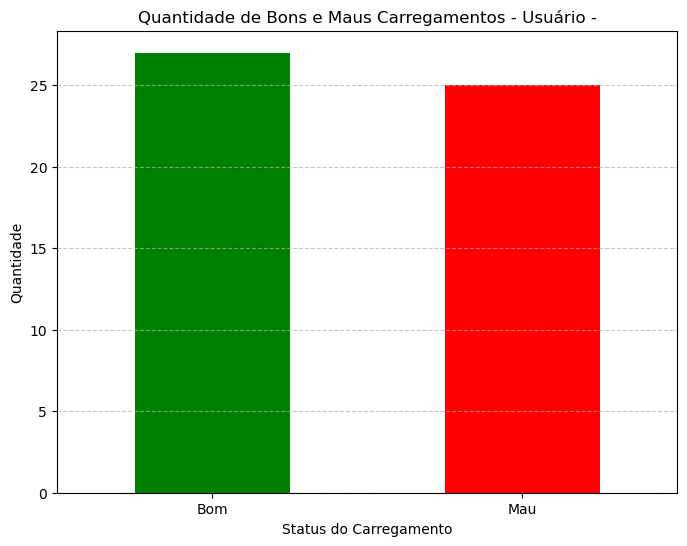

In [4]:
import pandas as pd
import matplotlib.pyplot as plt

# Carregar os dados do usuário
user_df = pd.read_excel('EVIO_history_01-03-2024_01-06-2024.xlsx')

# Carregar os dados de incentivos
incentivos_df = pd.read_csv('output_data_2024-03-01_to_2024-06-30.csv', sep=';')

# Separar a coluna de incentivos em várias colunas
incentivos_df.columns = ['datetime', 'request', 'value', 'unit', 'quality', 'updated_at', 'Hour']
incentivos_df['datetime'] = pd.to_datetime(incentivos_df['datetime'], format='%Y-%m-%d %H:%M:%S')

# Remover fuso horário das datas de incentivos_df (ou ajustar fuso horário conforme necessário)
incentivos_df['datetime'] = incentivos_df['datetime'].dt.tz_localize(None)

# Preparação dos dados de User
user_df['Start date'] = pd.to_datetime(user_df['Start date'], format='%m/%d/%Y | %H:%M')
user_df['Stop date'] = pd.to_datetime(user_df['Stop date'], format='%m/%d/%Y | %H:%M')

# Remover fuso horário das datas de user_df (ou ajustar fuso horário conforme necessário)
user_df['Start date'] = user_df['Start date'].dt.tz_localize(None)
user_df['Stop date'] = user_df['Stop date'].dt.tz_localize(None)

# Substituir vírgulas por pontos e converter para float se necessário
incentivos_df['value'] = incentivos_df['value'].astype(str).str.replace(',', '.').astype(float)

# Agrupar dados de user_df por 'Nº cartão EVIO'
users_grouped = user_df.groupby('Nº cartão EVIO')

# Função para verificar se uma datetime está dentro de algum intervalo
def check_if_in_intervals(dt, intervals):
    for start, stop in intervals:
        if start <= dt <= stop:
            return 1
    return 0

# Iterar por cada usuário
for user_id, group in users_grouped:
    # Criar uma lista de intervalos de tempo de carregamento para o usuário atual
    intervals = [(start, stop) for start, stop in zip(group['Start date'], group['Stop date'])]
    
    # Aplicar a função em todas as datetimes do incentivos_df
    incentivos_df['Carregamento'] = incentivos_df['datetime'].apply(lambda x: check_if_in_intervals(x, intervals))
    
    # Selecionar apenas as colunas datetime e Carregamento
    resultado_df = incentivos_df[['datetime', 'Carregamento']]
    
    # Filtrar as linhas onde 'Carregamento' é igual a 1
    carregamentos = resultado_df[resultado_df['Carregamento'] == 1]
    
    # Realizar o merge dos DataFrames
    merged_df = pd.merge(carregamentos, incentivos_df[['datetime', 'value']], on='datetime', how='inner')
    
    # Calcular o quantil (50%) do máximo para cada dia
    incentivos_df['date'] = incentivos_df['datetime'].dt.date
    daily_max_quantile = incentivos_df.groupby('date')['value'].max().quantile(0.5)
    
    # Verificar se os valores estão acima ou abaixo do quantil calculado
    merged_df['Status'] = merged_df['value'].apply(lambda x: 'Bom' if x < daily_max_quantile else 'Mau')

    
    # Verificar se os valores estão acima ou abaixo do valor de referência (50)
    #merged_df['Status'] = merged_df['value'].apply(lambda x: 'Bom' if x < 70 else 'Mau')
    
    # Contar bons e maus carregamentos
    status_counts = merged_df['Status'].value_counts()
    
    if not status_counts.empty:
        # Definir cores para o gráfico
        colors = ['green' if status == 'Bom' else 'red' for status in status_counts.index]
        
        # Plotar o gráfico de barras
        plt.figure(figsize=(8, 6))
        status_counts.plot(kind='bar', color=colors)
        plt.title(f'Quantidade de Bons e Maus Carregamentos - Usuário {user_id}')
        plt.xlabel('Status do Carregamento')
        plt.ylabel('Quantidade')
        plt.xticks(rotation=0)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        
        # Mostrar o gráfico
        plt.show()
    else:
        print(f'Nenhum dado para plotar para o usuário {user_id}')
